# 7. ADI+IFS: PSF subtraction and forward modeling

> Author: *Valentin Christiaens*  
> Suitable for VIP *v1.2.2* onwards (**Warning** this is a different version requirement than other tutorials)  
> Last update: *2024/03/25*

**Table of contents**

* [7.1. Loading and visualizing the data](#7.1.-Loading-and-visualizing-the-data)
* [7.2. Planet parameters and spectra](#7.2.-Planet-parameters-and-spectra)
* [7.3. Flux normalization](#7.3.-Flux-normalization)
    - [7.3.1. Non-coronagraphic PSF normalization](#7.3.1.-Non-coronagraphic-PSF-normalization)
    - [7.3.2. Stellar SED model](#7.3.2.-Stellar-SED-model)
    - [7.3.3. Airmass](#7.3.3.-Airmass)
    - [7.3.4. Final fluxes](#7.3.4.-Final-fluxes)     
* [7.4. Injection](#7.4.-Injection)
* [7.5. Post-processing of IFS data](#7.5.-Post-processing-of-IFS-data)
    - [7.5.1. Optimal scaling factors](#7.5.1.-Optimal-scaling-factors)
    - [7.5.2. median-SDI](#7.5.2.-median-SDI)
    - [7.5.3. PCA-SDI](#7.5.3.-PCA-SDI)
    - [7.5.4. median-ASDI](#7.5.4.-median-ASDI)
    - [7.5.5. PCA-ASDI](#7.5.5.-PCA-ASDI)
    - [7.5.6. PCA-ADI for all spectral channels](#7.5.6.-PCA-ADI-for-all-spectral-channels)
* [7.6. Astrometry retrieval](#7.6.-Astrometry-retrieval)
    - [7.6.1. Spectral channels with maximum SNR](#7.6.1.-Spectral-channels-with-maximum-SNR)
    - [7.6.2. NEGFC+PCA-ADI (simplex)](#7.6.2.-NEGFC+PCA-ADI-(simplex))
    - [7.6.3. NEGFC+PCA-ADI (MCMC)](#7.6.3.-NEGFC+PCA-ADI-(MCMC))
* [7.7. Spectrum retrieval](#7.7.-Spectrum-retrieval)
    - [7.7.1. NEGFC+PCA-ADI (simplex)](#7.7.1.-NEGFC+PCA-ADI-(simplex))
    - [7.7.2. NEGFC+PCA-ADI (MCMC)](#7.7.2.-NEGFC+PCA-ADI-(MCMC))

The purpose of this tutorial is to show:
- how to inject a planet spectrum in a 4D (IFS+ADI) datacube;
- how to post-process 4D (IFS+ADI) datacubes; 
- how to retrieve the parameters of a planet present in a 4D (IFS+ADI) datacube (astro- and spectrometry).

---
**NOTE**

The model spectra (for the star and planet) used in this notebook are provided after resampling for the purpose of highlighting the capabilities of VIP only (i.e. to avoid having to install additional requirements to be able to run this tutorial). If you are interested in a more complete planet spectrum injection procedure, check out [this Exoplanet Data Challenge Phase 2 tutorial](https://github.com/exoplanet-imaging-challenge/phase2/tree/main/tutorials), which also requires the following external packages: [``special``](https://github.com/VChristiaens/special) (for model resampling) and [``eidc2``](https://github.com/exoplanet-imaging-challenge/phase2) (for better flux normalization before spectrum injection).

---

Let's first load all packages needed in this tutorial:

In [1]:
import astropy.constants as c
import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
from os.path import join
import pandas as pd
from packaging import version

In the following box we check that your version of VIP passes the requirements to run this notebook:

In [2]:
import vip_hci as vip
vvip = vip.__version__
print("VIP version: ", vvip)
if version.parse(vvip) <= version.parse("1.2.2"):
    msg = "Please upgrade your version of VIP"
    msg+= "It should be above 1.2.2 to run this notebook."
    raise ValueError(msg)

VIP version:  1.6.0


## 7.1. Loading and visualizing the data

In the 'datasets' folder of the `VIP_extras` repository you can find a toy SPHERE/IFS coronagraphic cube acquired in pupil-stabilized mode on the source HIP39826 (a star with no reported directly imaged companion). The folder also contains the associated non-coronagraphic point spread function (PSF), wavelength vector, parallactic angles, and airmass of the source.

Let's now load the data. Note that more info on opening and visualizing fits files with VIP in general is available [in the first VIP tutorial](https://vip.readthedocs.io/en/latest/tutorials/01_quickstart.html).

In [3]:
from vip_hci.fits import open_fits

path = '../datasets/'

cubename = join(path,'sphere_ifs_HIP39826_cube.fits')
psfname = join(path, 'sphere_ifs_HIP39826_psf.fits')
lbdaname = join(path, 'sphere_ifs_HIP39826_wl.fits')
angname = join(path, 'sphere_ifs_HIP39826_pa.fits')
Xname = join(path, 'sphere_ifs_HIP39826_airmass.fits')

cube = open_fits(cubename)
psf = open_fits(psfname)
lbda = open_fits(lbdaname)
derot_angles = -1*open_fits(angname) # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input
X_sci = open_fits(Xname) 

nch, nz, ny, nx = cube.shape

FITS HDU-0 data successfully loaded. Data shape: (39, 55, 107, 107)
FITS HDU-0 data successfully loaded. Data shape: (39, 29, 29)
FITS HDU-0 data successfully loaded. Data shape: (39,)
FITS HDU-0 data successfully loaded. Data shape: (55,)
FITS HDU-0 data successfully loaded. Data shape: (55,)


Each IFS spectral cube consists of 39 monochromatic images spread in wavelengths between the Y and J bands ('YJ' mode) or Y and H bands ('YJH' mode). Here the IFS+ADI cube contains 55 such spectral cubes combined into a single master cube.

The **master spectral cube** is already centered, trimmed from bad frames, and mostly corrected from bad pixels (check Tutorial 2 for example uses). 

Let's inspect the first wavelength using `hciplot.plot_cubes` (feel free to set the backend to 'bokeh' to read pixel values interactively):

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
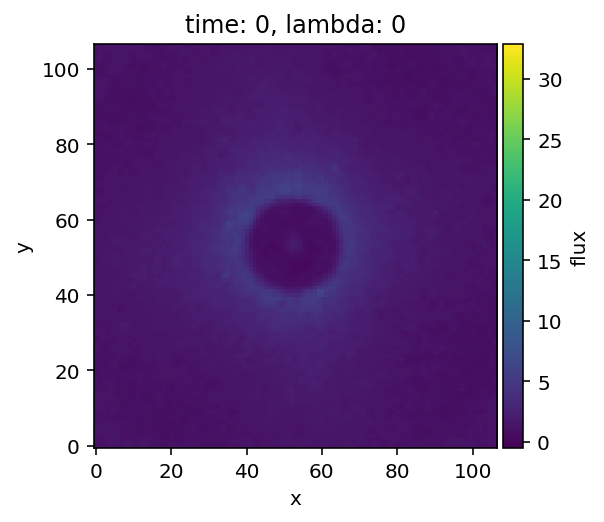

In [4]:
plot_cubes(cube)#, backend='bokeh')

We notice that the flux varies and the PSF size increases, both as a function of wavelength.

Now let's inspect the **PSF cube** (one frame per wavelength), which will be used for the actual injection of a fake planet:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
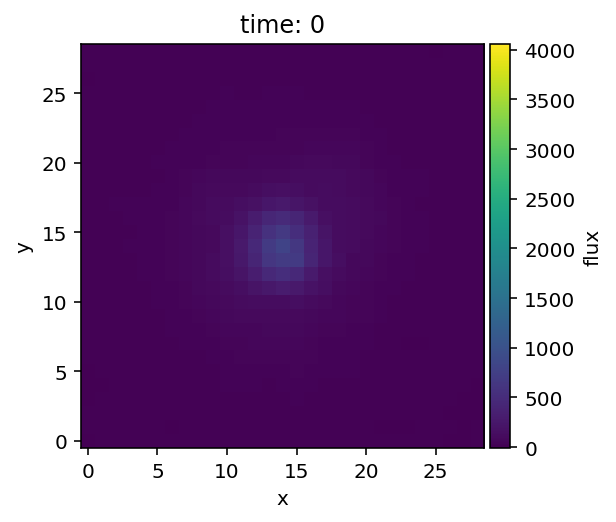

In [5]:
plot_cubes(psf)

As we can see, the flux varies as a function of wavelength. This reflects the intrinsic spectrum of the star but also the instrumental transmission and atmospheric absorption bands (e.g. associated to the water molecule) affecting some wavelengths more than others. The flux will be normalized in the next section, before injection.

Now let's check the **parallactic angle** and **airmass** variations:

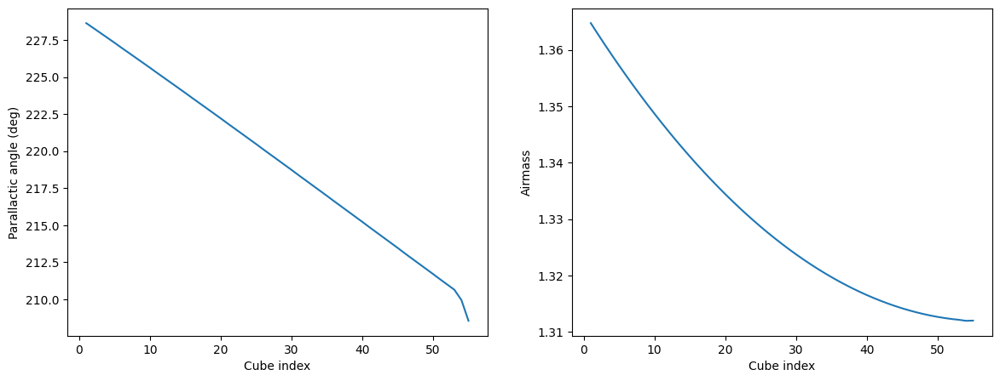

In [6]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")
ax2.plot(range(1,nz+1), X_sci)
ax2.set_xlabel("Cube index")
ax2.set_ylabel("Airmass")
plt.show()

Note the sudden variation in parallactic angle at the end of the sequence is because we trimmed bad frames from the sequence (all were located towards the end of the observation).

Let's define the **pixel scale** for IFS - note that this is optional since the planet coordinates will be given in pixels. It will still be useful to have meaningful radial separations expressed in arcsec.

In [7]:
from vip_hci.config import VLT_SPHERE_IFS
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.00746 arcsec/px


Let's now load and visualize the coronagraphic radial **transmission** profile:

In [8]:
trans = open_fits(path+"../datasets/sphere_ifs_YJ_APLC_CoroTransmission.fits")

FITS HDU-0 data successfully loaded. Data shape: (40, 23)


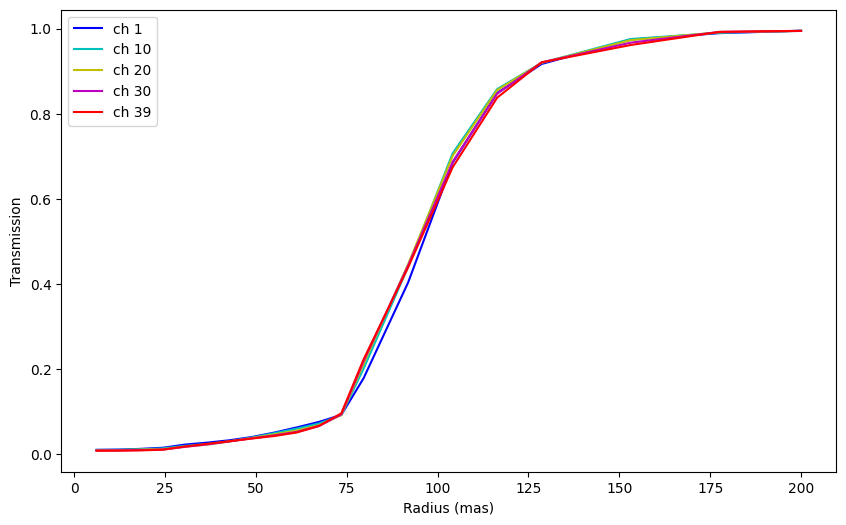

In [9]:
last_r = 20
plt.figure(figsize=(10,6))
plt.plot(trans[0,:last_r]*1000, trans[1,:last_r], 'b', label='ch 1')
plt.plot(trans[0,:last_r]*1000, trans[10,:last_r], 'c', label='ch 10')
plt.plot(trans[0,:last_r]*1000, trans[20,:last_r], 'y', label='ch 20')
plt.plot(trans[0,:last_r]*1000, trans[30,:last_r], 'm', label='ch 30')
plt.plot(trans[0,:last_r]*1000, trans[-1,:last_r], 'r', label='ch 39')
plt.xlabel("Radius (mas)")
plt.ylabel("Transmission")
plt.legend()

EDIT: this is not the most up-to-date SPHERE coronagraphic transmission curve. Please contact relevant SPHERE colleagues or check the ESO website for a newer version. Do not use the above curve for your research.

## 7.2. Planet parameters and spectra

Now let's set the **ground truth coordinates** and average **contrast** (over all wavelengths) at which two planets will be injected in this cube:

In [10]:
xy_b = (58.6,37.7)
contrast_b = 1e-3

xy_c = (83.8,29.9)
contrast_c = 2e-4

Let's convert cartesian to polar coordinates:

In [11]:
from vip_hci.var import frame_center, dist

cy, cx = frame_center(cube)
r_b = dist(cy, cx, xy_b[1], xy_b[0])
r_c = dist(cy, cx, xy_c[1], xy_c[0])

theta_b = np.rad2deg(np.arctan2(xy_b[1]-cy, xy_b[0]-cx))
theta_c = np.rad2deg(np.arctan2(xy_c[1]-cy, xy_c[0]-cx))

In [12]:
print(cy, cx)
print(r_b, theta_b)
print(r_c, theta_c)

53 53
16.292636373527763 -69.89671372878468
38.5 -36.86989764584403


Now let's consider two fiducial model spectra for the injection of the 2 planets: a flat spectrum and a **1000K blackbody model** (note that this exercise is purely academic).

In [13]:
def blackbody(lbda, T): 
    fac = 2*c.h.value*(c.c.value**2)/(np.power(lbda*1e-6,5))
    div = (1/(np.exp((c.h.value*c.c.value)/((lbda*1e-6)*c.k_B.value*T))-1))
    # convert from W m-3 Sr-1 to W m-2 mu-1 Sr-1 
    conv = 1e-6
    return fac*div*conv

In [14]:
fluxes_b = np.ones_like(lbda)
fluxes_c = blackbody(lbda, 1000)

spec_b = np.array([lbda, fluxes_b])
spec_c = np.array([lbda, fluxes_c])

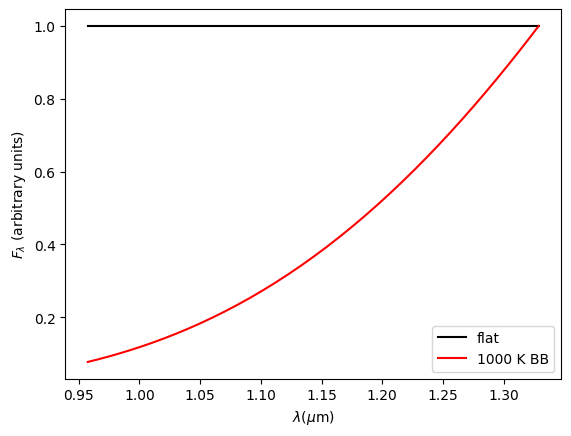

In [15]:
plt.plot(lbda, fluxes_b/np.amax(fluxes_b), 'k', label='flat')
plt.plot(lbda, fluxes_c/np.amax(fluxes_c), 'r', label='1000 K BB')
plt.xlabel(r"$\lambda (\mu$m)")
plt.ylabel(r"$ F_{\lambda}$ (arbitrary units)")
plt.legend()

## 7.3. Flux normalization

### 7.3.1. Non-coronagraphic PSF normalization

Let's measure the flux and FWHM of the non-coronagraphic PSF and normalize its flux to 1 in a 1-FWHM radius aperture (all at once), in all channels, using VIP's `fm/normalize_psf` function. We use the `debug` option to check that each 2D Gaussian fit worked properly:

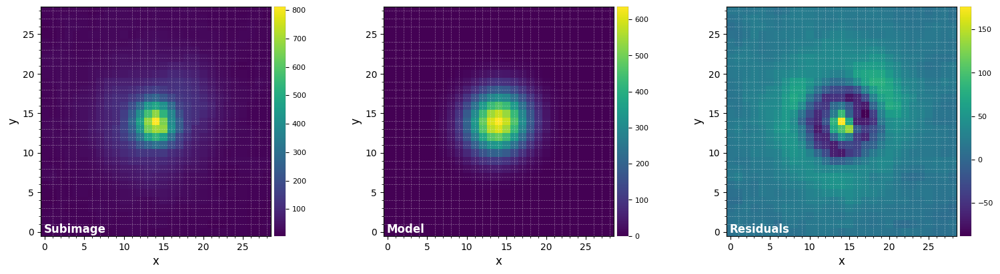

FWHM_y = 6.249918590603874
FWHM_x = 5.955174570808004 

centroid y = 13.91271280451398
centroid x = 13.899308522396119
centroid y subim = 13.91271280451398
centroid x subim = 13.899308522396119 

amplitude = 636.3209207163183
theta = -40.20327494893465


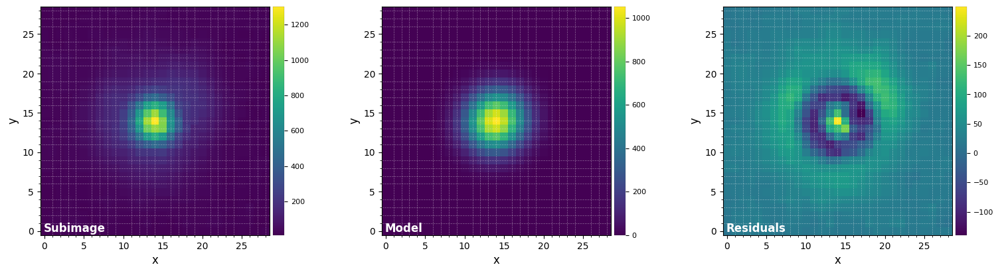

FWHM_y = 6.115031733429569
FWHM_x = 5.839092912200307 

centroid y = 14.027611189747118
centroid x = 13.902123414264741
centroid y subim = 14.027611189747118
centroid x subim = 13.902123414264741 

amplitude = 1054.2949916060757
theta = -37.53607125551694


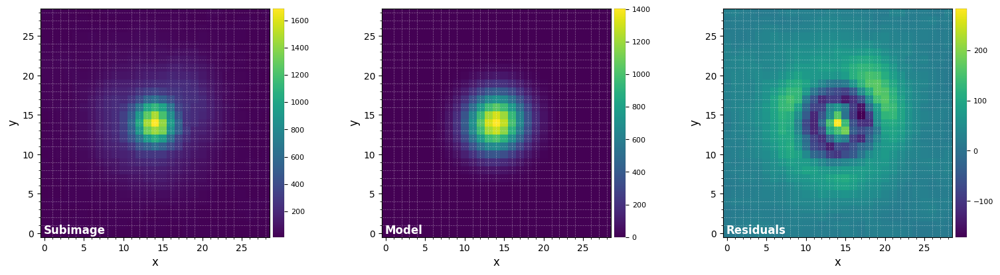

FWHM_y = 6.017536940985172
FWHM_x = 5.754055056932398 

centroid y = 14.064675014829234
centroid x = 13.92189940782827
centroid y subim = 14.064675014829234
centroid x subim = 13.92189940782827 

amplitude = 1404.794695125425
theta = -32.75340696040902


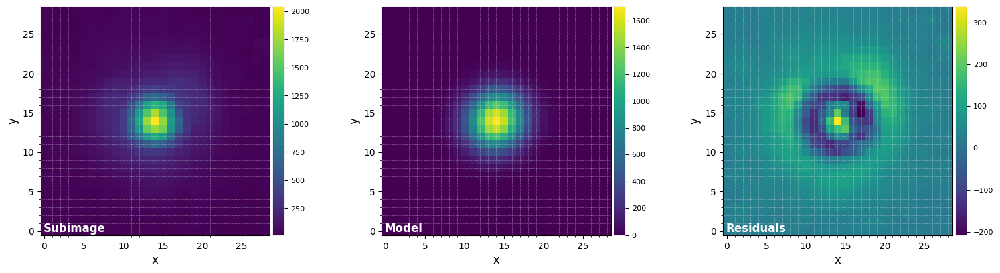

FWHM_y = 5.991878155204902
FWHM_x = 5.682647009421292 

centroid y = 14.065184394206566
centroid x = 13.946038597175642
centroid y subim = 14.065184394206566
centroid x subim = 13.946038597175642 

amplitude = 1705.2716467835362
theta = -37.38382831173306


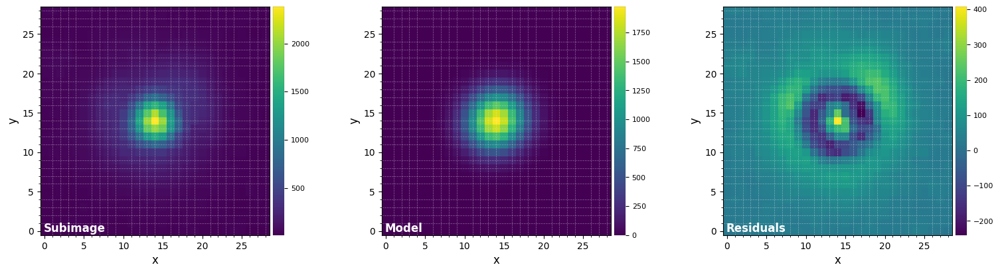

FWHM_y = 6.025210456840216
FWHM_x = 5.719302651409165 

centroid y = 14.075784813017492
centroid x = 13.955473078460203
centroid y subim = 14.075784813017492
centroid x subim = 13.955473078460203 

amplitude = 1975.512023781219
theta = -39.22716810162712


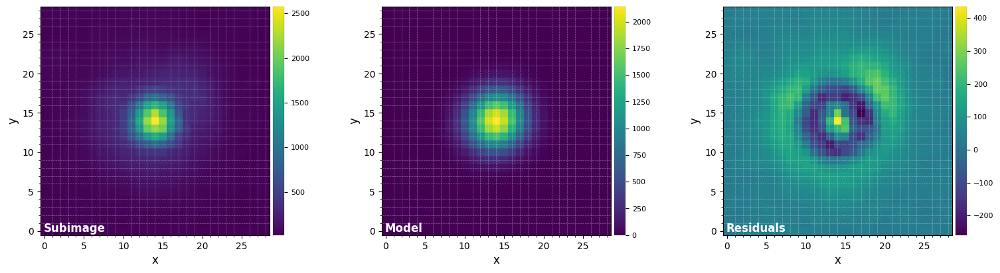

FWHM_y = 5.985037638845695
FWHM_x = 5.719904342290713 

centroid y = 14.090563585852339
centroid x = 13.954901979145369
centroid y subim = 14.090563585852339
centroid x subim = 13.954901979145369 

amplitude = 2143.9966998784653
theta = -37.89243906967077


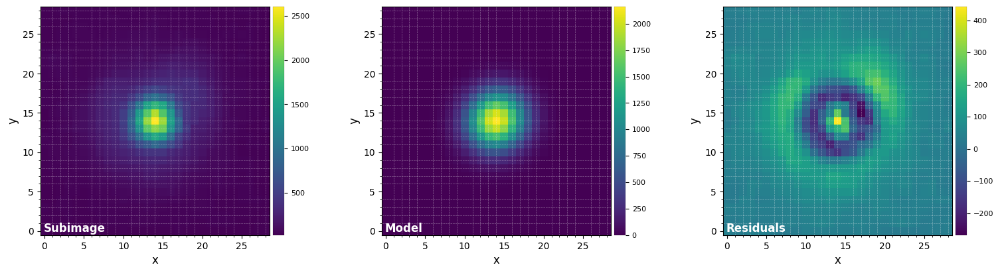

FWHM_y = 6.037449649433551
FWHM_x = 5.753733367061057 

centroid y = 14.109510955089712
centroid x = 13.980317492176528
centroid y subim = 14.109510955089712
centroid x subim = 13.980317492176528 

amplitude = 2165.8668020759737
theta = -38.98816537803609


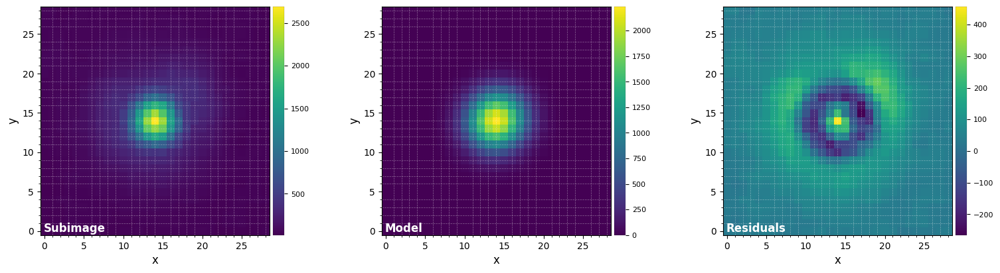

FWHM_y = 6.010425979656497
FWHM_x = 5.749988204486838 

centroid y = 14.09139902516843
centroid x = 13.986593684665714
centroid y subim = 14.09139902516843
centroid x subim = 13.986593684665714 

amplitude = 2237.452674183443
theta = -42.082555609402725


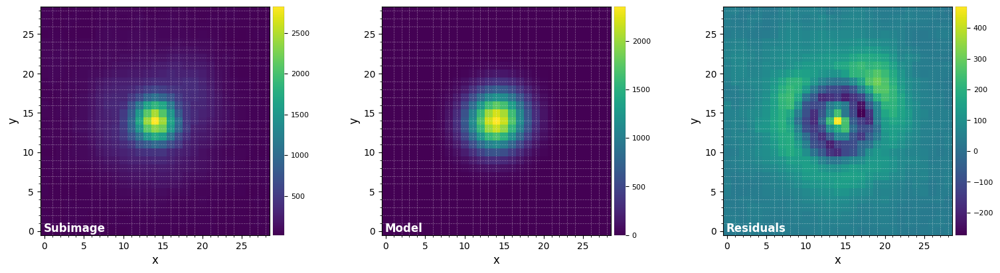

FWHM_y = 6.005151597188339
FWHM_x = 5.76618913736032 

centroid y = 14.090254937281216
centroid x = 14.000261828564383
centroid y subim = 14.090254937281216
centroid x subim = 14.000261828564383 

amplitude = 2355.107335363224
theta = -38.12872688402823


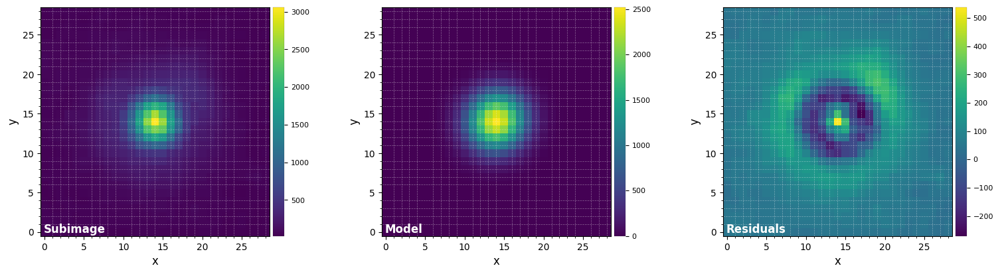

FWHM_y = 5.968097471114103
FWHM_x = 5.732989798767101 

centroid y = 14.102026780112466
centroid x = 14.00192256597961
centroid y subim = 14.102026780112466
centroid x subim = 14.00192256597961 

amplitude = 2523.9552216610077
theta = -36.166718794700735


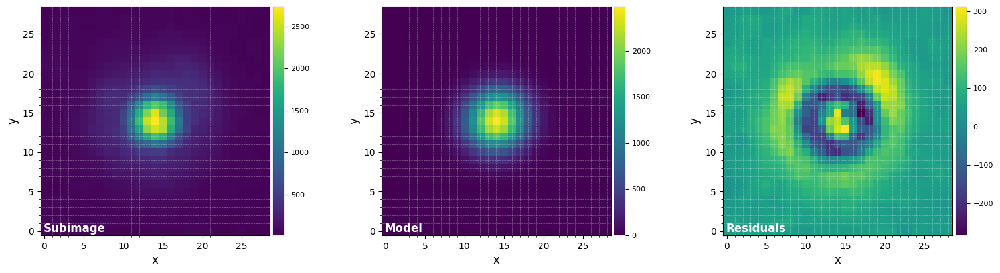

FWHM_y = 6.201045253077615
FWHM_x = 5.952529125955214 

centroid y = 14.095618864845
centroid x = 14.011238141279225
centroid y subim = 14.095618864845
centroid x subim = 14.011238141279225 

amplitude = 2483.278573203233
theta = -40.0145330658136


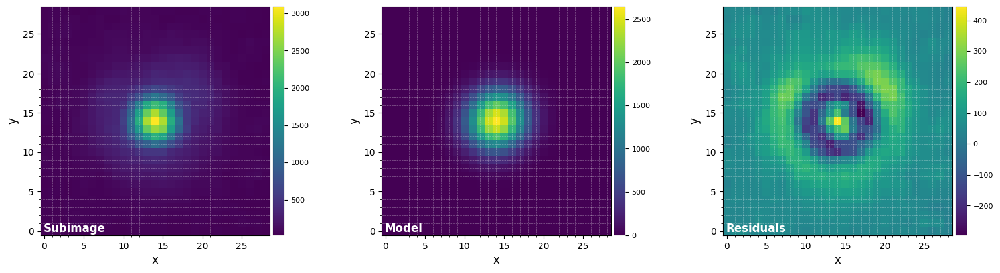

FWHM_y = 6.116743999603686
FWHM_x = 5.8392716209686455 

centroid y = 14.100847253492372
centroid x = 14.00962801008164
centroid y subim = 14.100847253492372
centroid x subim = 14.00962801008164 

amplitude = 2649.287384055851
theta = -42.97211525263866


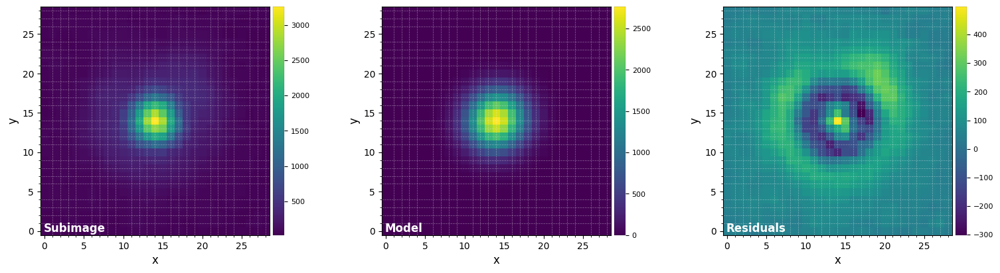

FWHM_y = 6.037056836634695
FWHM_x = 5.786392745945851 

centroid y = 14.110142788418528
centroid x = 14.004784235107898
centroid y subim = 14.110142788418528
centroid x subim = 14.004784235107898 

amplitude = 2770.0240285986383
theta = -39.87700223679414


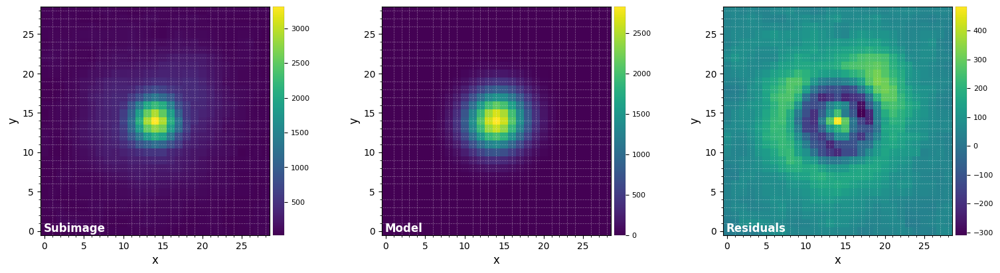

FWHM_y = 6.066318706454739
FWHM_x = 5.822724547903064 

centroid y = 14.099317823674594
centroid x = 14.003150239115127
centroid y subim = 14.099317823674594
centroid x subim = 14.003150239115127 

amplitude = 2830.2548549551825
theta = -47.81201831706728


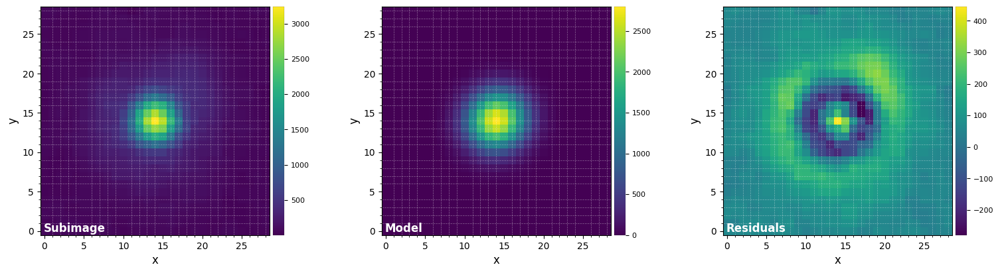

FWHM_y = 6.0762534866894
FWHM_x = 5.806486874018672 

centroid y = 14.112521461447967
centroid x = 14.034377198494248
centroid y subim = 14.112521461447967
centroid x subim = 14.034377198494248 

amplitude = 2803.4053532338025
theta = -1130.8992713799976


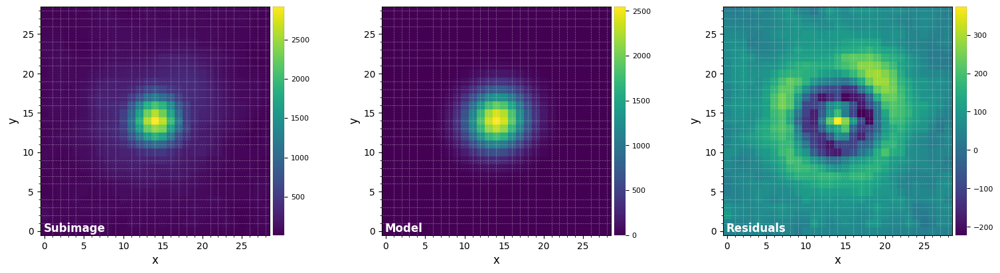

FWHM_y = 5.783408275201281
FWHM_x = 6.0947688987153565 

centroid y = 14.151451482312362
centroid x = 14.046235885495358
centroid y subim = 14.151451482312362
centroid x subim = 14.046235885495358 

amplitude = 2553.3202894435076
theta = -1046.1876651444495


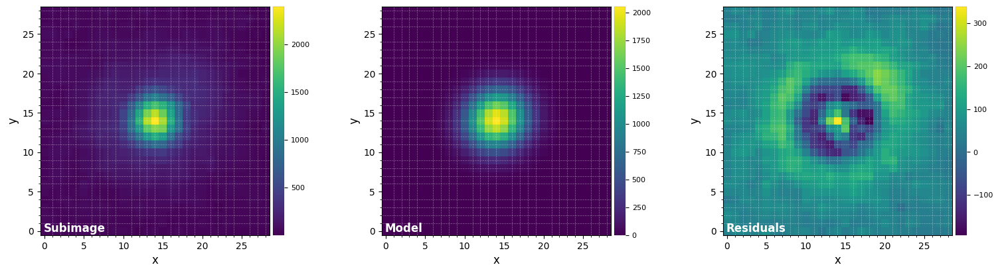

FWHM_y = 6.181608409176731
FWHM_x = 5.8193909573736375 

centroid y = 14.20606445385617
centroid x = 14.027564827140305
centroid y subim = 14.20606445385617
centroid x subim = 14.027564827140305 

amplitude = 2063.199046760751
theta = -591.897110332275


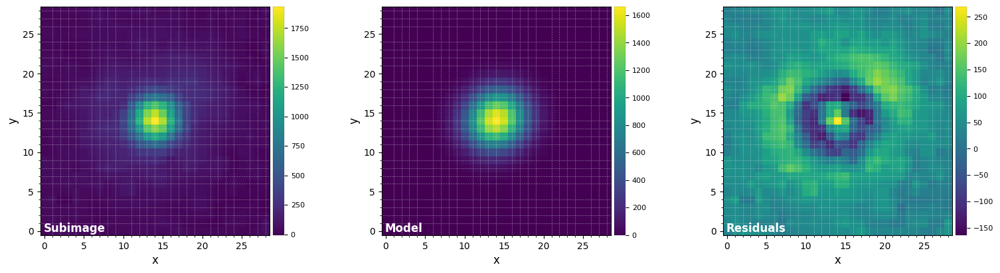

FWHM_y = 5.751799509227016
FWHM_x = 6.17657549885813 

centroid y = 14.19949897448417
centroid x = 14.014692740126705
centroid y subim = 14.19949897448417
centroid x subim = 14.014692740126705 

amplitude = 1668.583800683618
theta = 214.19574589903868


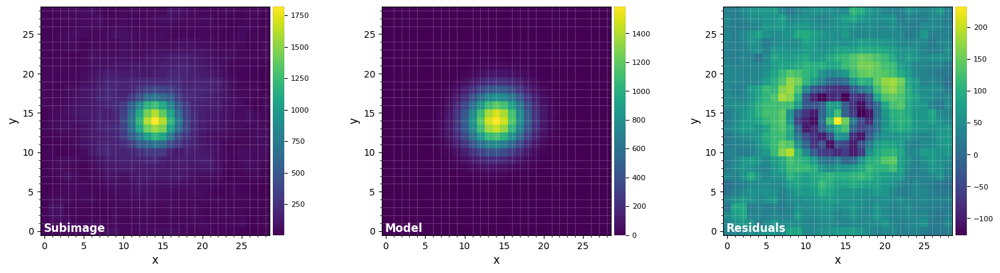

FWHM_y = 5.797247573087523
FWHM_x = 6.1407206833700165 

centroid y = 14.09188009914479
centroid x = 13.978278484577537
centroid y subim = 14.09188009914479
centroid x subim = 13.978278484577537 

amplitude = 1587.9799968312032
theta = 208.93362670690016


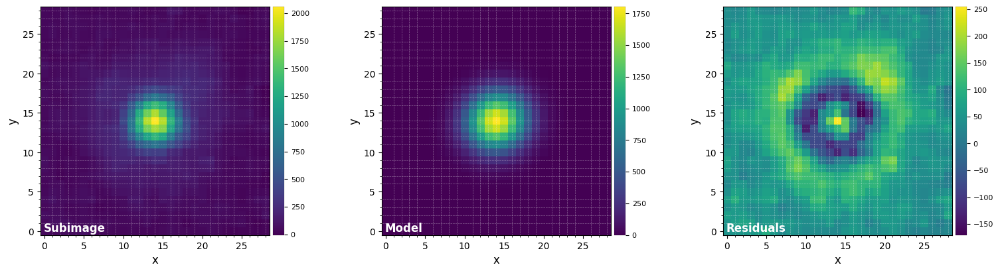

FWHM_y = 6.173286713166213
FWHM_x = 5.849770266197921 

centroid y = 14.020275158086994
centroid x = 14.002567343397786
centroid y subim = 14.020275158086994
centroid x subim = 14.002567343397786 

amplitude = 1805.5945901482098
theta = 117.55114919185255


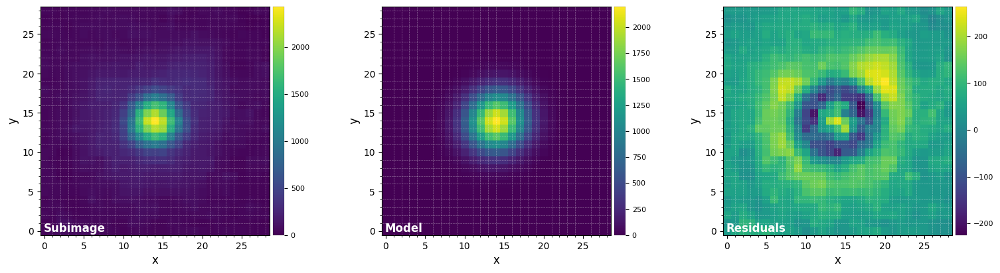

FWHM_y = 5.8792339430596385
FWHM_x = 6.127221726103625 

centroid y = 13.989753883492577
centroid x = 14.002807252408369
centroid y subim = 13.989753883492577
centroid x subim = 14.002807252408369 

amplitude = 2198.15726732781
theta = -320.2155668333245


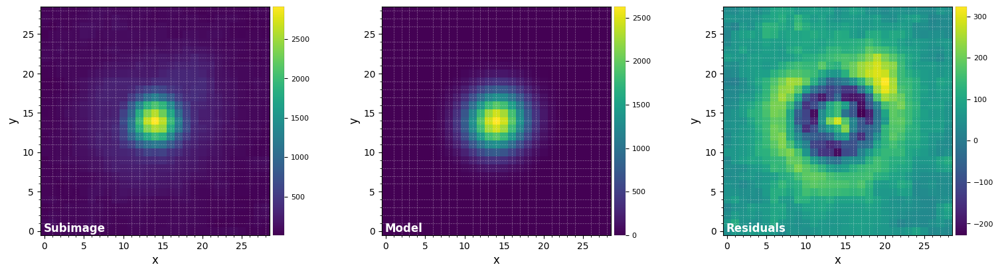

FWHM_y = 5.887171922875942
FWHM_x = 6.160164896057722 

centroid y = 14.006124941599417
centroid x = 14.009936779590372
centroid y subim = 14.006124941599417
centroid x subim = 14.009936779590372 

amplitude = 2628.450008946031
theta = -321.35901701076017


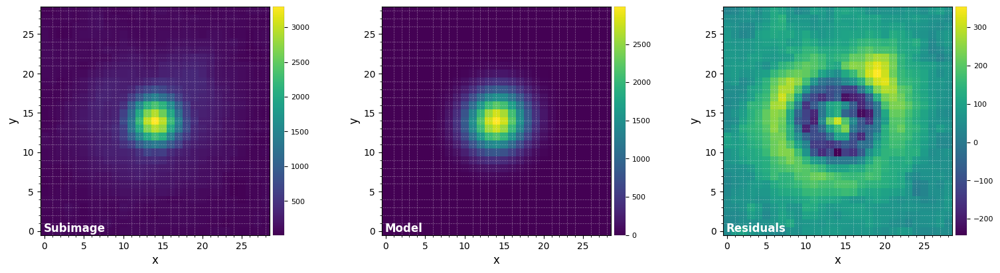

FWHM_y = 6.09831937562108
FWHM_x = 5.823811534748941 

centroid y = 14.045780781152429
centroid x = 14.014771011818317
centroid y subim = 14.045780781152429
centroid x subim = 14.014771011818317 

amplitude = 2992.2717122916088
theta = -228.95610739084978


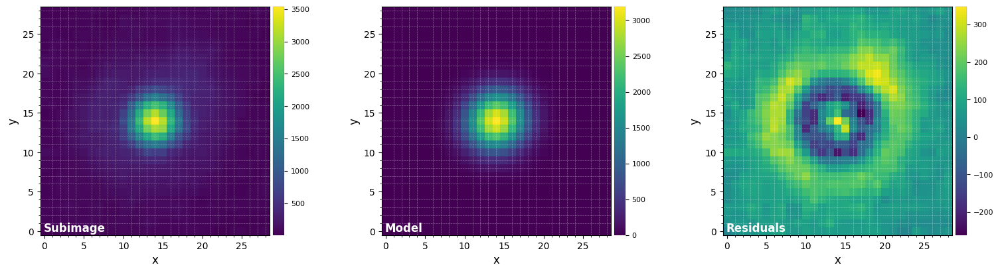

FWHM_y = 6.0881435225079805
FWHM_x = 5.800320948866406 

centroid y = 14.051247831816042
centroid x = 13.998093842075047
centroid y subim = 14.051247831816042
centroid x subim = 13.998093842075047 

amplitude = 3191.2868185639486
theta = -409.9397195034933


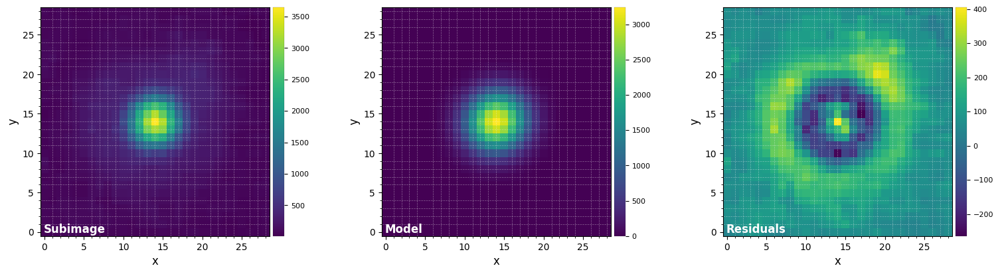

FWHM_y = 6.131166433598984
FWHM_x = 5.872212732710024 

centroid y = 14.035337815438458
centroid x = 13.998171477355866
centroid y subim = 14.035337815438458
centroid x subim = 13.998171477355866 

amplitude = 3243.165884637672
theta = -50.094032052651244


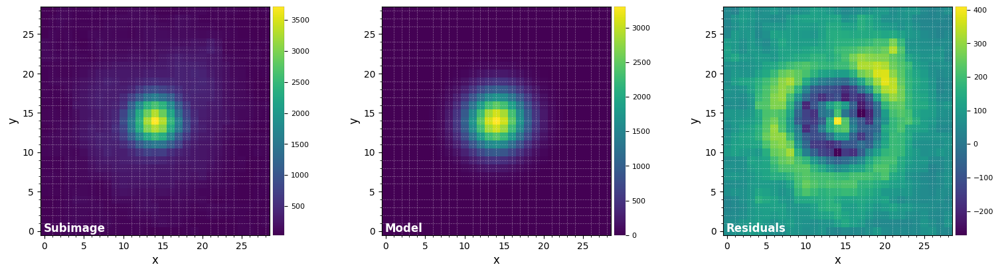

FWHM_y = 6.174942665281358
FWHM_x = 5.993212466027066 

centroid y = 14.039753518531834
centroid x = 13.991921001228043
centroid y subim = 14.039753518531834
centroid x subim = 13.991921001228043 

amplitude = 3307.870326350025
theta = -60.77852495501218


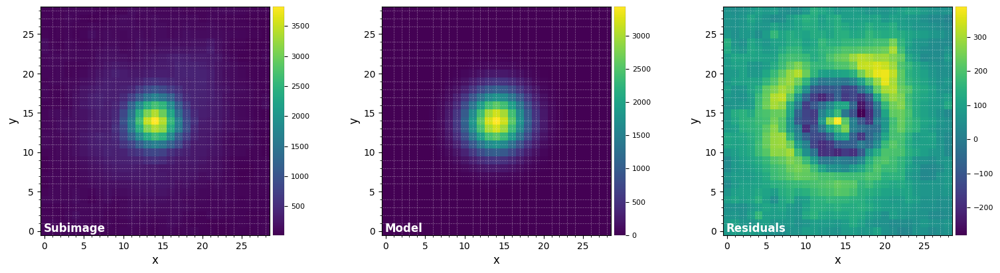

FWHM_y = 6.212946741792123
FWHM_x = 6.032862559194067 

centroid y = 14.009742407110084
centroid x = 13.967991908928983
centroid y subim = 14.009742407110084
centroid x subim = 13.967991908928983 

amplitude = 3436.0292572548005
theta = -233.07434375115434


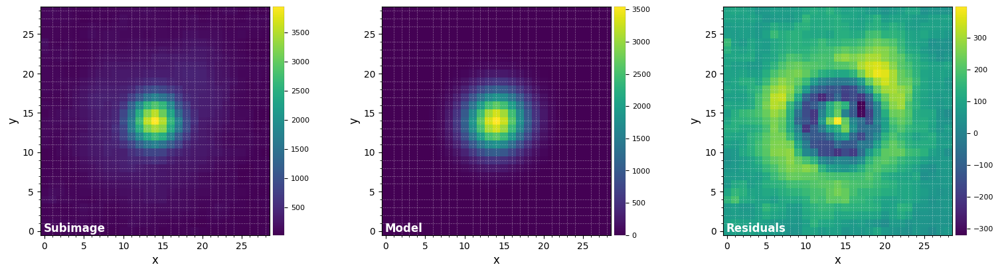

FWHM_y = 6.202834710260401
FWHM_x = 5.991454580720095 

centroid y = 14.020014512644996
centroid x = 13.952064722408837
centroid y subim = 14.020014512644996
centroid x subim = 13.952064722408837 

amplitude = 3546.6560417516
theta = -45.08873954759156


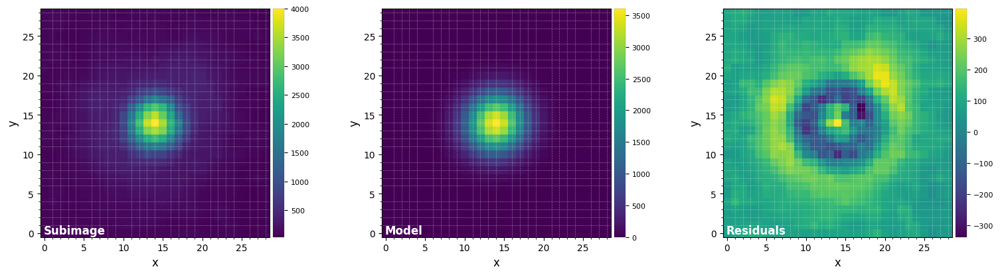

FWHM_y = 6.188582125824741
FWHM_x = 5.985402654686102 

centroid y = 14.01288592814225
centroid x = 13.933314914222532
centroid y subim = 14.01288592814225
centroid x subim = 13.933314914222532 

amplitude = 3607.1363107135303
theta = -45.54255278702471


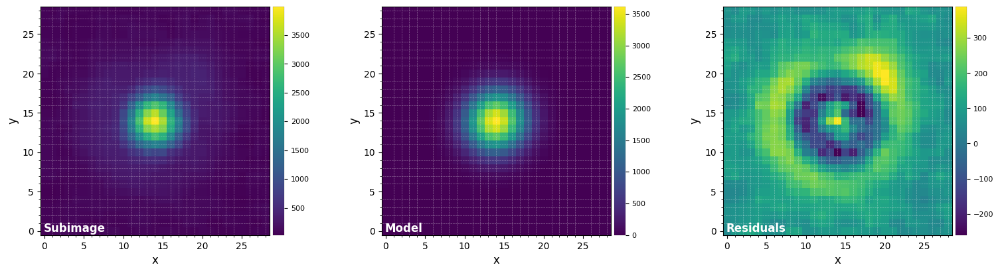

FWHM_y = 6.244755229547681
FWHM_x = 6.022172272874139 

centroid y = 14.005908973811751
centroid x = 13.928682611420811
centroid y subim = 14.005908973811751
centroid x subim = 13.928682611420811 

amplitude = 3616.190962501067
theta = -32.925763043061316


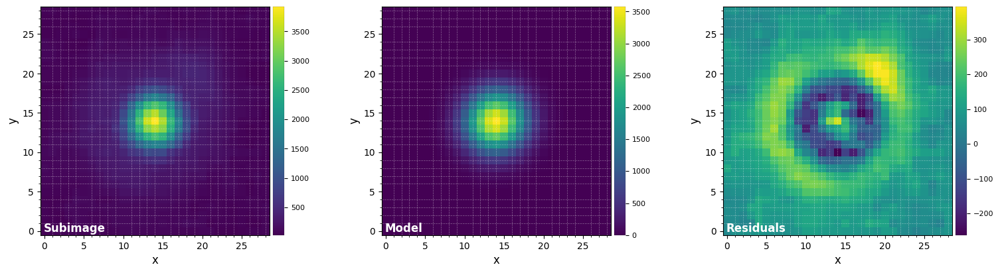

FWHM_y = 6.273041721822999
FWHM_x = 6.080609549848098 

centroid y = 13.982299985252563
centroid x = 13.934886096628695
centroid y subim = 13.982299985252563
centroid x subim = 13.934886096628695 

amplitude = 3579.5485931779963
theta = -38.81094688171014


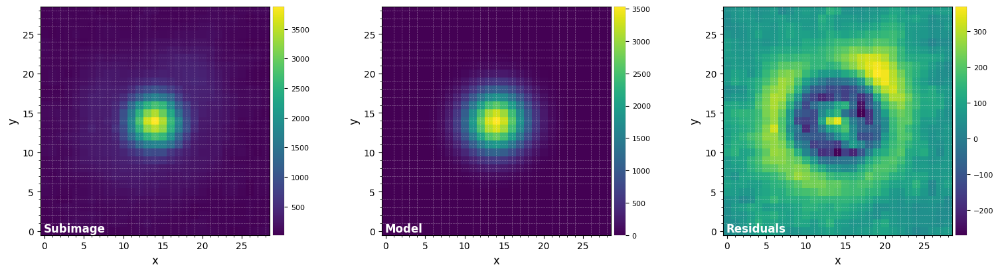

FWHM_y = 6.272897782073148
FWHM_x = 6.150604153616258 

centroid y = 13.949986873367504
centroid x = 13.940065010491569
centroid y subim = 13.949986873367504
centroid x subim = 13.940065010491569 

amplitude = 3535.362591691256
theta = -1487.0522520173815


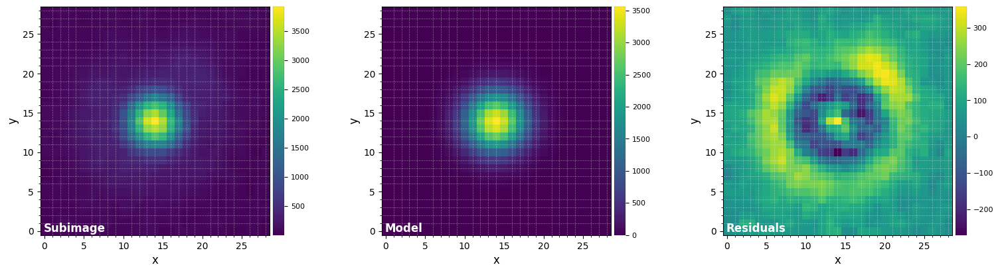

FWHM_y = 6.169653553625252
FWHM_x = 6.268150616054396 

centroid y = 13.93102667705402
centroid x = 13.920174694300993
centroid y subim = 13.93102667705402
centroid x subim = 13.920174694300993 

amplitude = 3562.2524885100333
theta = 32.84281796852152


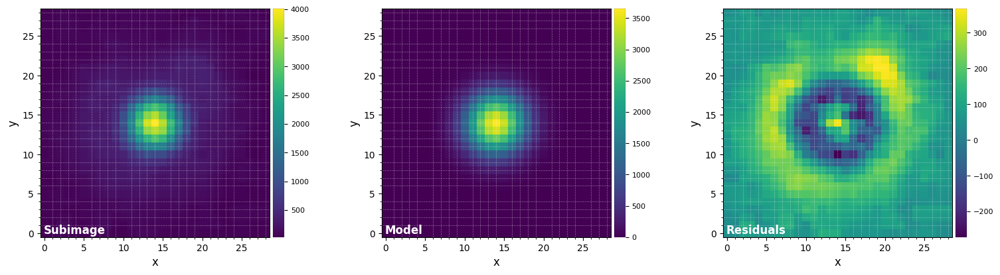

FWHM_y = 6.274537554461365
FWHM_x = 6.15783778729409 

centroid y = 13.934250084708731
centroid x = 13.921697907180066
centroid y subim = 13.934250084708731
centroid x subim = 13.921697907180066 

amplitude = 3655.6640709273543
theta = 129.0032036748455


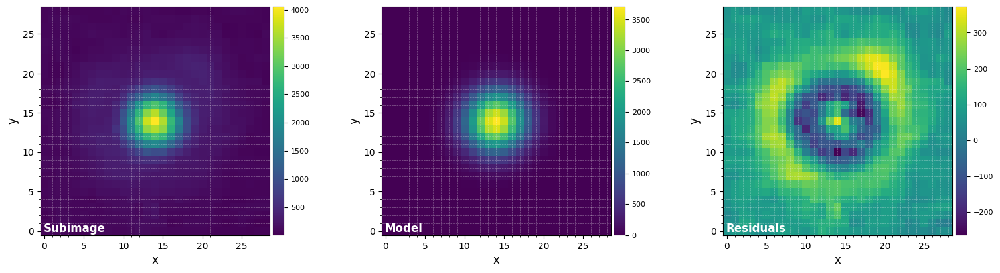

FWHM_y = 6.311436197883887
FWHM_x = 6.13531584749999 

centroid y = 13.94518468204029
centroid x = 13.904558439173428
centroid y subim = 13.94518468204029
centroid x subim = 13.904558439173428 

amplitude = 3713.2225587915073
theta = -41.34373753295229


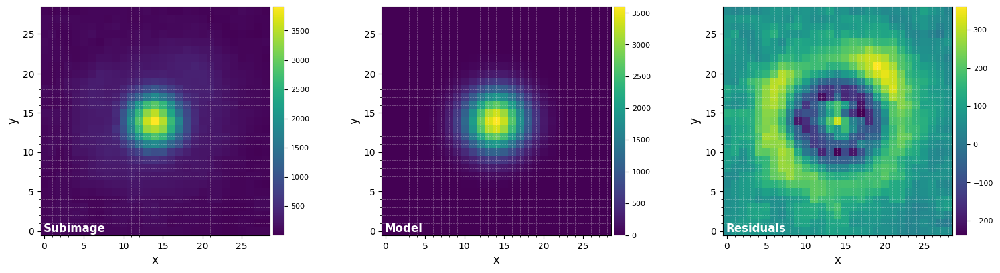

FWHM_y = 6.330588326064803
FWHM_x = 6.183593806778592 

centroid y = 13.972693149768391
centroid x = 13.88644208061843
centroid y subim = 13.972693149768391
centroid x subim = 13.88644208061843 

amplitude = 3603.9831791184242
theta = -39.620902361371115


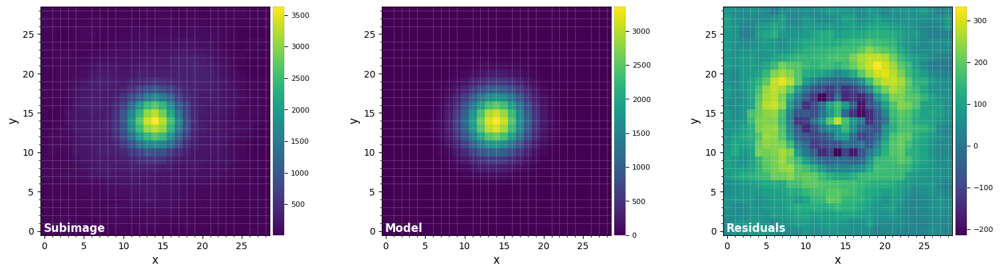

FWHM_y = 6.184001319791858
FWHM_x = 6.343494125581092 

centroid y = 13.949799213255506
centroid x = 13.88297982179931
centroid y subim = 13.949799213255506
centroid x subim = 13.88297982179931 

amplitude = 3362.492784983323
theta = -131.56407953215054


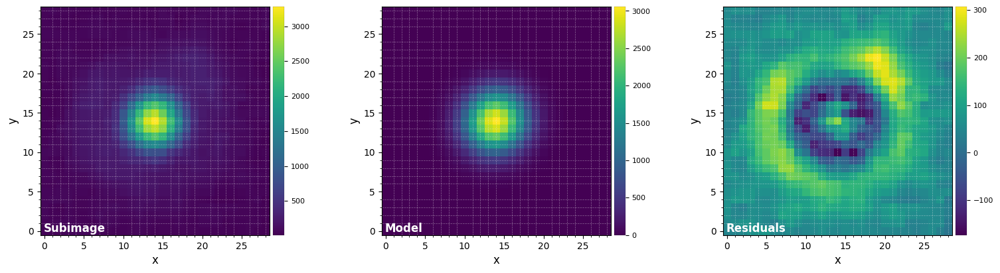

FWHM_y = 6.1049383638073556
FWHM_x = 6.326105627594453 

centroid y = 13.96352838089737
centroid x = 13.869285619427107
centroid y subim = 13.96352838089737
centroid x subim = 13.869285619427107 

amplitude = 3062.496146821083
theta = -498.2520143063228


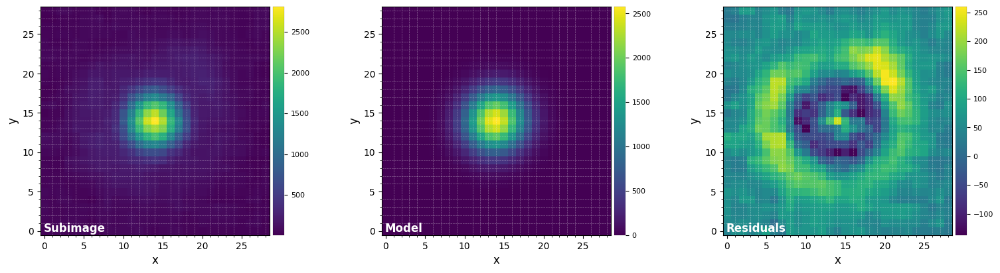

FWHM_y = 6.281872522406608
FWHM_x = 6.106896271693318 

centroid y = 14.035165570900137
centroid x = 13.854666632371053
centroid y subim = 14.035165570900137
centroid x subim = 13.854666632371053 

amplitude = 2583.8408147326386
theta = -35.599440361956056
Mean FWHM per channel: 
[6.103 5.977 5.886 5.837 5.872 5.852 5.896 5.88  5.886 5.851 6.077 5.978
 5.912 5.945 5.941 5.939 6.    5.964 5.969 6.012 6.003 6.024 5.961 5.944
 6.002 6.084 6.123 6.097 6.087 6.133 6.177 6.212 6.219 6.216 6.223 6.257
 6.264 6.216 6.194]
Flux in 1xFWHM aperture: 
[13397.649 21373.517 27661.433 33057.763 38754.981 41781.661 42805.645
 44021.68  46395.703 49082.614 52371.307 53918.696 55093.806 56930.742
 56350.541 51298.303 42189.297 33733.493 32181.659 37142.073 45223.932
 54394.967 60556.863 64201.073 66477.378 69675.456 73203.718 74978.343
 76002.683 77311.678 77583.749 77448.172 78182.432 80187.787 81616.948
 80114.272 74899.496 67091.761 56185.008]


In [16]:
from vip_hci.fm import normalize_psf
%matplotlib inline
psfn, flux_st, fwhm = normalize_psf(psf, fwhm='fit', full_output=True, debug=True)

Now let's plot the measured FWHM and stellar flux:

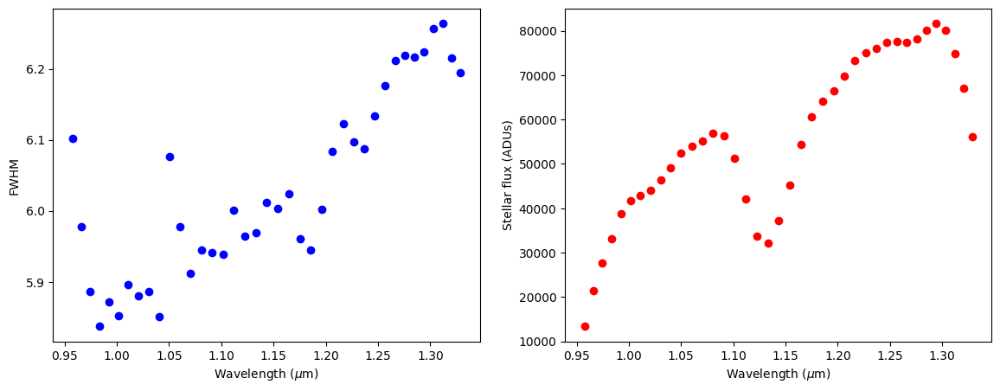

In [17]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

**Fig. 3.1**: Measured FWHM and stellar flux in the non-coronagraphic PSF cube.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
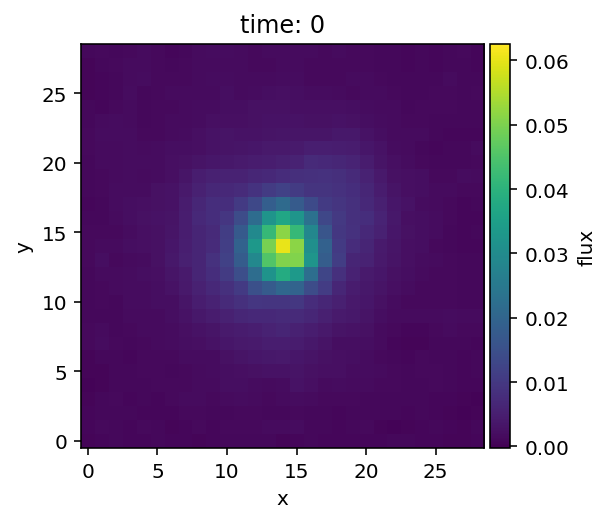

In [18]:
plot_cubes(psfn, grid=True)

Now let's save the measured spectrum of the star in the format we will need for the injection function:

In [19]:
spec_star = np.array([lbda, flux_st])

### 7.3.2. Stellar SED model

The spectral type of the star (HIP39826) is K7V. For the purpose of this tutorial, we simply load a BT-NextGen SED model that has already be resampled considering the spectral resolution and sampling of SPHERE-IFS:

In [20]:
spec_star_mod = open_fits("../datasets/sphere_ifs_HIP39826_SED_model.fits")

plt.plot(spec_star_mod[0], spec_star_mod[0]*spec_star_mod[1], 'k', label='Model SED for the star')
plt.ylabel(r"$\lambda F_{\lambda}$ (arbitrary units)")
plt.legend()

FITS HDU-0 data successfully loaded. Data shape: (2, 39)


### 7.3.3. Airmass

Airmass variation can also be taken into consideration during the injection of the planet spectra (more specifically we consider the ratio between individual airmass values and the median airmass over the observation):

In [21]:
med_X = np.median(X_sci)
X_fac = np.exp(-(X_sci-med_X))

Let's plot the factors to be applied to correct for airmass (w.r.t median airmass):

In [22]:
%matplotlib inline
plt.plot(range(1,nz+1), X_fac, 'k')
plt.xlabel("Cube index")
plt.ylabel("X factor")

Text(25.097222222222214, 0.5, 'X factor')

### 7.3.4. Final fluxes

Let's now calculate the fluxes at which the normalized PSF will actually be injected in each frame of each spectral cube.

Considering the effect of instrumental and atmospheric transmission, we have:

In [23]:
flux_b_trans = fluxes_b*(flux_st/spec_star_mod[1])
flux_c_trans = fluxes_c*(flux_st/spec_star_mod[1])                     

Considering the actual mean contrast we want the planet to be injected, with respect to the star, we have:

In [24]:
flux_b_scal = flux_b_trans*contrast_b*np.mean(flux_st)/np.mean(flux_b_trans)
flux_c_scal = flux_c_trans*contrast_c*np.mean(flux_st)/np.mean(flux_c_trans) 

Finally let's consider the airmass:

In [25]:
final_fluxes_b = np.outer(flux_b_scal, X_fac)
final_fluxes_c = np.outer(flux_c_scal, X_fac)

---
**NOTE**

The effect of **coronagraphic** transmission is taken at the moment of injection, within the planet injection function (next section), as it depends on the radial separation from the star.

---

## 7.4. Injection

The actual injection can be simply performed with the `cube_inject_companions` function, which can handle 4D input cubes. Let's inject the first planet first:

In [26]:
from vip_hci.fm import cube_inject_companions
cube_fc = cube_inject_companions(cube, psfn, derot_angles, flevel=final_fluxes_b, 
                                 plsc=plsc, rad_dists=[r_b], n_branches=1, 
                                 theta=theta_b, transmission=trans, verbose=True)

*** Processing spectral channel 1/39 ***
*** Processing spectral channel 2/39 ***
*** Processing spectral channel 3/39 ***
*** Processing spectral channel 4/39 ***
*** Processing spectral channel 5/39 ***
*** Processing spectral channel 6/39 ***
*** Processing spectral channel 7/39 ***
*** Processing spectral channel 8/39 ***
*** Processing spectral channel 9/39 ***
*** Processing spectral channel 10/39 ***
*** Processing spectral channel 11/39 ***
*** Processing spectral channel 12/39 ***
*** Processing spectral channel 13/39 ***
*** Processing spectral channel 14/39 ***
*** Processing spectral channel 15/39 ***
*** Processing spectral channel 16/39 ***
*** Processing spectral channel 17/39 ***
*** Processing spectral channel 18/39 ***
*** Processing spectral channel 19/39 ***
*** Processing spectral channel 20/39 ***
*** Processing spectral channel 21/39 ***
*** Processing spectral channel 22/39 ***
*** Processing spectral channel 23/39 ***
*** Processing spectral channel 24/39 ***
*

Let's now inject the second planet in the same cube:

In [27]:
cube_fc = cube_inject_companions(cube_fc, psfn, derot_angles, flevel=final_fluxes_c, 
                                 plsc=plsc, rad_dists=[r_c], n_branches=1, 
                                 theta=theta_c, transmission=trans, verbose=False)

Let's inspect the cube with the inject companions:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
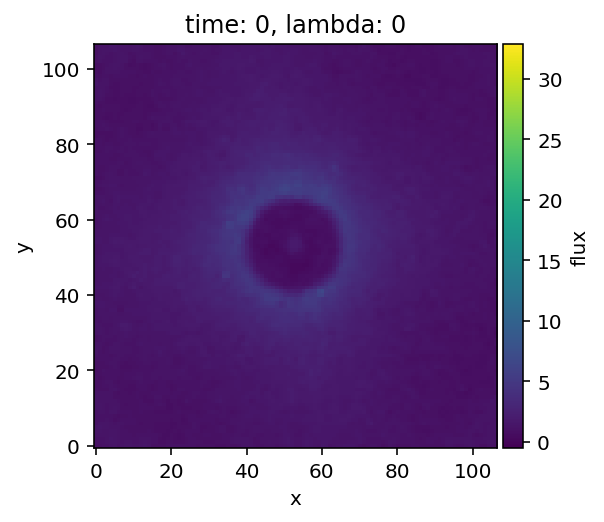

In [28]:
plot_cubes(cube_fc)

[Go to the top](#Table-of-contents)

## 7.5. Post-processing of IFS data

Let's now try to recover the 2 injected companions using different post-processing algorithms.

### 7.5.1. Optimal scaling factors

In order to leverage the radial expansion of the stellar PSF with wavelength through spectral differential imaging, let's first compute the optimal scaling factors between the spectral channels. For a perfect AO correction, flat stellar spectrum and uniform atmospheric transmission, one would expect the scaling factors to be (exactly) inversely proportional to the wavelength. Although reality deviates a bit from these assumptions, these still make for a good first guess:

In [29]:
th_scal = lbda[-1]/lbda
th_scal

array([1.3877398, 1.375682 , 1.3635113, 1.3512615, 1.3389585, 1.3266245,
       1.3142908, 1.3019674, 1.2896852, 1.2774729, 1.2653329, 1.2532798,
       1.2413497, 1.2295421, 1.217879 , 1.2063586, 1.1950108, 1.1838219,
       1.1728301, 1.1620203, 1.151418 , 1.1410172, 1.1308315, 1.1208638,
       1.1111166, 1.1016016, 1.092311 , 1.0832641, 1.0744526, 1.0658859,
       1.0575558, 1.0494791, 1.0416555, 1.0340765, 1.0267497, 1.0196825,
       1.0128585, 1.0063006, 1.       ], dtype=float32)

Let's use `preproc.find_scal_vector` to refine this estimate. This function will find the optimal scaling factors (both in terms of geometric scaling and flux scaling) between each spectral channel and the last one such that their subtraction yields minimal residuals. For coronagraphic observations, it is recommended to provide a binary `mask`, corresponding to the location where the residuals will be calculated, which avoids the area encompassed by the coronagraphic mask, in order to achieve the best estimate.
Here we use the mean of the 4D cube along the temporal direction to find the factors:

In [30]:
from vip_hci.var import mask_circle
from vip_hci.preproc import find_scal_vector

mask = np.ones_like(cube[0,0])
mask = mask_circle(mask, int(0.16/plsc))

opt_scal_mean, opt_flux = find_scal_vector(np.mean(cube,axis=1), lbda, flux_st, 
                                           mask=mask, nfp=2, fm="stddev")

Although much slower, another approach would be to calculate the scaling factors for each individual spectral cube, and use the median values. To display the progress let's use a Progressbar:

In [31]:
from vip_hci.config import Progressbar 
opt_scals = np.zeros([cube.shape[1],cube.shape[0]])
opt_fluxes = np.zeros([cube.shape[1],cube.shape[0]])
for i in Progressbar(range(cube.shape[1]), verbose=True):
    opt_scals[i], opt_fluxes[i] = find_scal_vector(cube[:,i], lbda, flux_st, mask=mask, nfp=2, fm="stddev")

0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:10:29


In [32]:
opt_scal_med = np.median(opt_scals,axis=0)
opt_flux_med = np.median(opt_fluxes,axis=0)

Let's plot the theoretical and empirical scaling factors: 

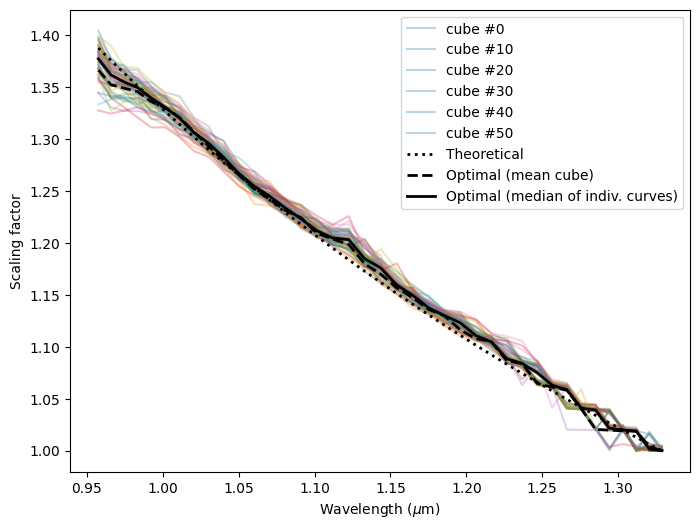

In [33]:
%matplotlib inline
plt.figure(figsize=(8,6))
for i in range(cube.shape[1]):
    if not i%10:
        label = 'cube #{}'.format(i)
    else:
        label = None
    plt.plot(lbda, opt_scals[i], alpha=0.3, label=label)
plt.plot(lbda, th_scal, 'k:', lw=2, label='Theoretical')
plt.plot(lbda, opt_scal_mean, 'k--', lw=2, label='Optimal (mean cube)')
plt.plot(lbda, np.median(opt_scals,axis=0), 'k-', lw=2, label='Optimal (median of indiv. curves)')
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("Scaling factor")
plt.legend()

Let's visualize the actual residuals in the first spectral cube (using the `frame_rescaling` routine to apply the optimal scaling factor):

In [34]:
from vip_hci.preproc import frame_rescaling
res_cube_test_opt = np.zeros([cube.shape[0],cube.shape[-2],cube.shape[-1]])
for i in range(cube.shape[0]):
    res_cube_test_opt[i] = opt_fluxes[0,i]*frame_rescaling(cube[i,0], scale=opt_scal_med[i])-cube[-1,0]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[107, 107, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
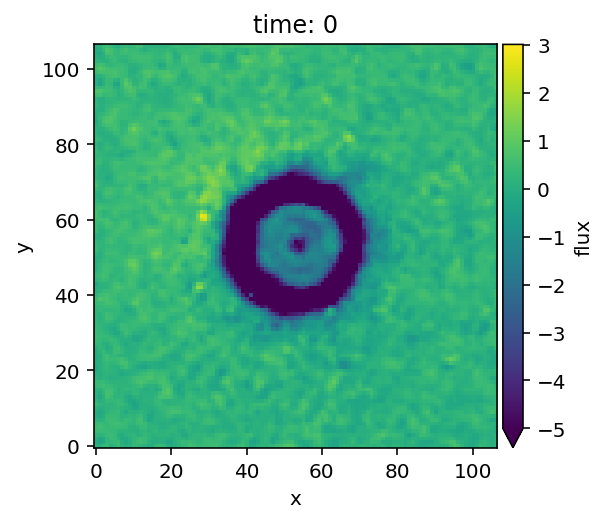

In [35]:
plot_cubes(res_cube_test_opt, vmin=-5)

Apart from the residual starlight at the edge of the coronagraphic mask (which does not expand radially), we see that the stellar halo is very well subtracted.

### 7.5.2. median-SDI 

The most basic way to leverage the radial diversity present in IFS data is to perform median-SDI (i.e. the radial equivalent to median-ADI). For that just use the `psfsub.median_sub` function, with the `sdi_only` option on: 

In [36]:
from vip_hci.psfsub import median_sub

mask_px = int(0.09/plsc)
med_SDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, sdi_only=True,
                     radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:09:39
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:17.650967
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:19.721792
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


For better results, it is recommended to use both the geometrical and flux scaling factors found in the previous section:

In [37]:
med_SDI_opt = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med, sdi_only=True,
                         radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:09:59
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:17.833408
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:19.949383
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's compare both reductions, showing circles at the ground truth locations where we injected the fake companions.

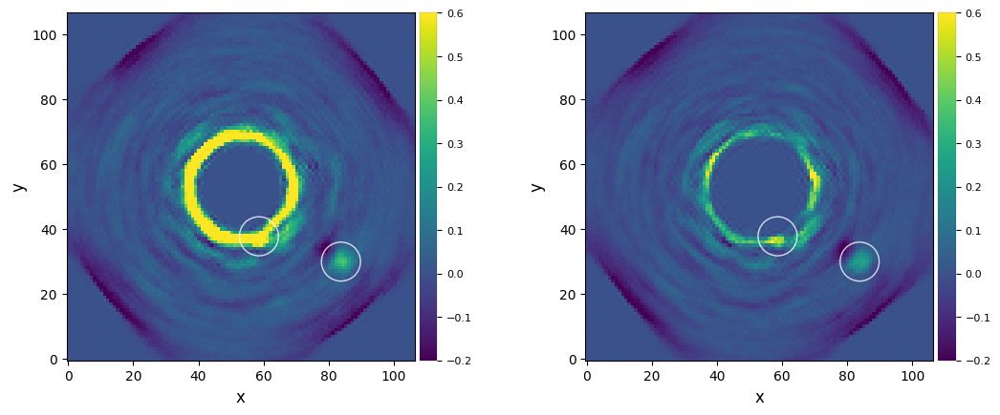

In [38]:
%matplotlib inline
plot_frames((med_SDI, med_SDI_opt), circle=(xy_b,xy_c), vmin=-0.2, vmax=0.6)

In the first image, we notice the limitation of SDI at short angular separation. Since the stellar residuals at the edge of the coronagraphic mask do not expand radially as the rest of the stellar halo, we are left with a bright spurious ring, preventing the re-detection of fake planet b.

We see that the median-SDI reduction with scaled fluxes performs slightly better at subtracting stellar residuals near the edge of the coronagraphic mask, although fake planet b is still not recovered.

Fake planet c is redetected. Let's compare its signal-to-noise ratio in both images:

In [39]:
from vip_hci.metrics import snr
snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_sc = snr(med_SDI_opt, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c, snr_c_sc)

19.81792937838819 23.226406491938384


Overall, we can conclude that the scaled flux version of median-SDI performs better than the non-flux scaled version.

### 7.5.3. PCA-SDI 

Let's now run a PCA-SDI reduction. Note that this approach may be useful in datasets with azimuthally extended disc features (since ADI can filter such signals). 

For PCA reductions, flux scaling factors are not necessary. This is because: i) the basis is orthonormal and an internal scaling is performed anyway when the principal components are projected onto each images; ii) flux scaling will typically increase the noise contribution before calculation of the principal components, which can bias their values. Our tests suggest indeed that better results are obtained (i.e. higher SNR for injected fake planets) when no flux scaling factor is considered before PCA.

#### 7.5.3.1. Full-frame PCA

To trigger SDI alone with the `psfsub.pca` function, you need to set: 

- `adimsdi='double'` to separate the PCA-SDI and PCA-ADI
- `ncomp` to a tuple of 2 values, the first of which being the number of principal components for PCA-SDI, and the second to be set to None - to prevent PCA-ADI (i.e. simply derotate and stack the SDI residual images);

Let's use the `mask_center_px` argument to set a numerical mask of 0.1'' radius in order not to include the coronagraphic mask.

Let's also set `imlib` and `interpolation` to non-default values for faster rescaling and (de-)rotations:

In [40]:
imlib = 'skimage'           # If you have it installed, feel free to set to 'opencv'
interpolation = 'biquintic'   # If you have opencv installed, feel free to set to 'lanczos4'

In [41]:
from vip_hci.psfsub import pca

ncomp_sdi = 1
mask_px = int(0.09/plsc)

pca_sdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=(ncomp_sdi,None), 
              adimsdi='double', crop_ifs=False, imlib=imlib, interpolation=interpolation, 
              interp_zeros=True, mask_val=0, mask_center_px=mask_px)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:10:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 4.600 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:15.973989
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
De-rotating and combining frames (skipping PCA)
Running time:  0:00:16.098523
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's show the final image with and without the application of a large (0.15'' radius) numerical mask, and with circles at the ground truth location where we injected the fake companions.

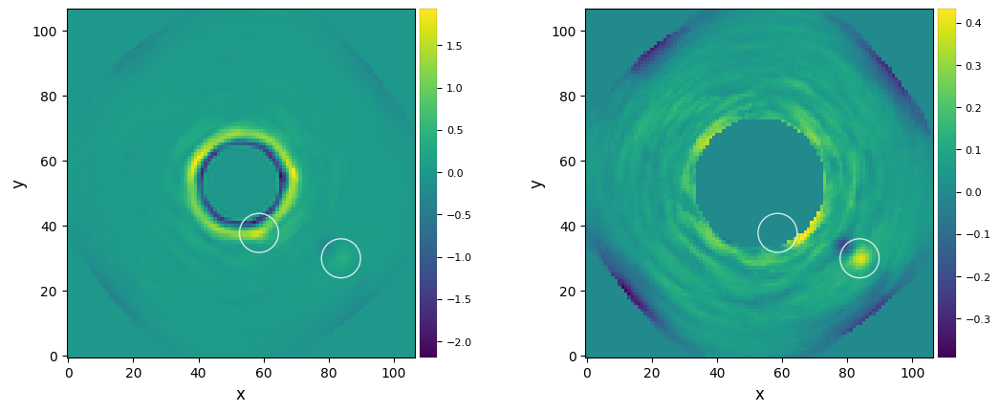

In [42]:
%matplotlib inline
plot_frames((pca_sdi, mask_circle(pca_sdi,20)),
            circle=(xy_b,xy_c))

In the first image, we notice the same effect as with median-SDI: significant stellar residuals at the edge of the coronagraphic mask.

On the other hand, fake planet c is easily re-detected. Notice the negative side lobe, that is reminiscent of ADI side lobes, but this time radially.

<font color=orange> **Question 7.1**: Why is the negative side lobe only radially inward of the planet in our final SDI image? </font>

This time the images obtained without and with flux-scaling applied to the cube before PCA appears to yield similar results. We note that flux scaling may actually have been slightly counter-productive, based on the raw fluxes at the location of the companion (peak value closer to ~0.4 without flux scaling, while closer to ~0.3 with flux scaling). Let's confirm that by measuring the SNR of c:

In [43]:
from vip_hci.metrics import snr
snr_c = snr(pca_sdi, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

12.781905737153485


#### 7.5.3.2. Annular PCA

PCA-SDI can also be performed in concentric annuli using `psfsub.pca_annular`. Again let's demonstrate whether flux scaling is useful or not:

In [44]:
from vip_hci.psfsub import pca_annular

ncomp_sdi = 1
mask_px = int(0.09/plsc)
fwhm_m = np.mean(fwhm)

pca_sdi_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, 
                          ncomp=(ncomp_sdi,None), radius_int=mask_px, fwhm=fwhm_m, asize=fwhm_m,
                          delta_sep=(0.3, 1), delta_rot=(0.5, 1),
                          mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:10:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:00:18.183380
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Skipping the second PCA subtraction


As before we show the image before and after masking the central part of the image, dominated by residual stellar light, to better show injected planet c:

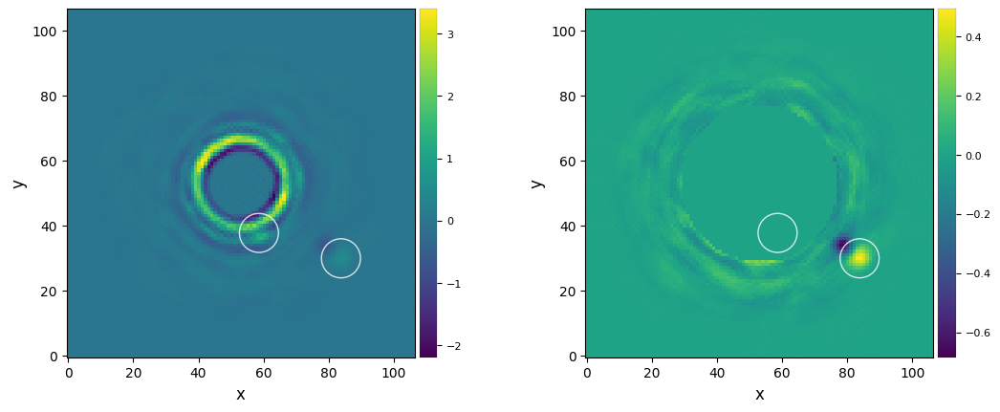

In [45]:
plot_frames((pca_sdi_ann, mask_circle(pca_sdi_ann, int(0.18/plsc))), circle=(xy_b,xy_c))

In [46]:
snr_c = snr(pca_sdi_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

16.55589798832914


Despite both reductions yielding relatively similar final images, we note that flux-scaling is slightly counter-productive (SNR slightly lower), similarly to the full-frame PCA reduction.

### 7.5.4. median-ASDI

Let's now combine both SDI and ADI, which should yield a better subtraction of the stellar residuals. Again, let's start with the most basic way to combine both strategies: median-ASDI. 

This simply involves the same calls to `median_sub` as in Sec. [7.5.2.](#7.5.2.-median-SDI), but removing `sdi_only=True`:

In [47]:
mask_px = int(0.09/plsc)

med_ASDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med,
                      radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:10:56
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:17.779895
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:19.740006
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's check the ASDI image:

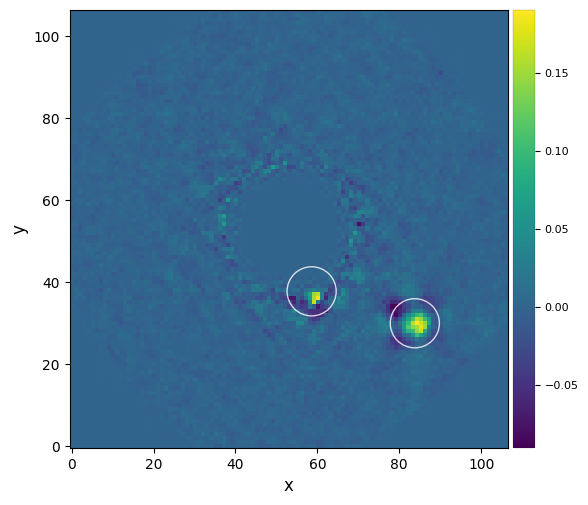

In [48]:
%matplotlib inline
plot_frames(med_ASDI, circle=(xy_b,xy_c))

This time we find signal at the location of fake planet b - although it does appear significantly filtered.

Fake planet c is easily redetected. Let's measure the signal-to-noise ratio for both fake planets:

In [49]:
snr_b = snr(med_SDI, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

0.9097275791820104
19.81792937838819


### 7.5.5. PCA-ASDI

#### 7.5.4.1. Full-frame PCA-ASDI (single step)

The ``psfsub.pca`` function in `VIP` offers the possibility to do this in either a single or 2 consecutive steps. 

In the first case, a master PCA library is created with all images acquired at different parallactic angles and at different wavelengths (i.e. containing both angular and radial diversity). This is done by setting:

- `adimsdi='single'` (default);
- `ncomp` to either a scalar value (integer to use that number of principal components, or float between 0 and 1 to indicate the desired cumulative explained variance ratio), or a list (of integer values to be tested).

Let's try with a list of a few ncomp values:

In [50]:
ncomp = [1,5,10,20]
pca_asdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
               adimsdi='single', crop_ifs=False, mask_center_px=mask_px,
               imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:11:16
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 4.367 GB
Rescaling the spectral channels to align the speckles
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:07
Running time:  0:00:08.025976
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
2145 total frames
Performing single-pass PCA
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:28.116268
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Computed residual frames for PCs interval: [1, 5, 10

Let's visualize the resulting image, including circles at the ground truth locations of the injected planets:

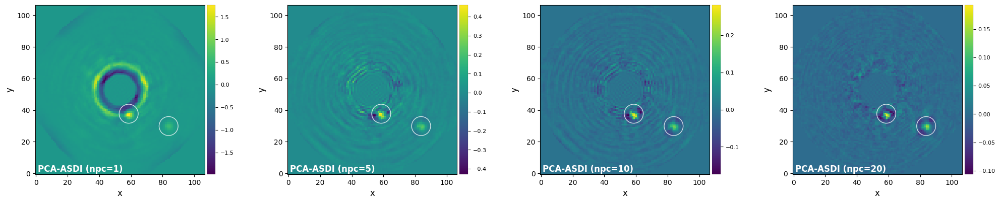

In [51]:
labels = tuple(['PCA-ASDI (npc={:.0f})'.format(npc) for npc in ncomp])
plot_frames(pca_asdi, label=labels,
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [52]:
snr_b = [snr(pca_asdi[i], xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True) for i in range(len(ncomp))]
print(snr_b)

snr_c = [snr(pca_asdi[i], xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True) for i in range(len(ncomp))]
print(snr_c)

[1.647327769791312, 5.174644978685126, 9.193696147835615, 5.456631668554781]
[11.095647966556829, 22.16038008881417, 30.91682560168811, 32.01166893988978]


#### 7.5.4.2. Full-frame PCA-ASDI (double step)

The second option consists in performing PCA-SDI first, and then PCA-ADI on the cube consisting of SDI frames obtained for each individual spectral cube. This mode can be activated by setting `adimsdi='double'` (instead of the default 'single' value).

Given the high correlation in the spectral dimension, let's just try with 1pc for each step:

In [53]:
ncomp = (1,1)
pca_asdi_2s = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                  adimsdi='double', crop_ifs=False, mask_center_px=mask_px,
                  interp_zeros=True, mask_val=0,
                  imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:12:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 4.848 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:15.544825
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA stage exploiting rotational variability
De-rotating and combining residuals
Running time:  0:00:15.694836
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


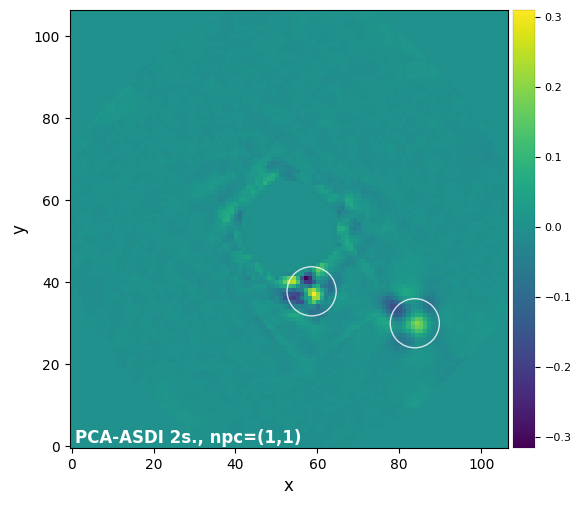

In [54]:
plot_frames(pca_asdi_2s,
            label='PCA-ASDI 2s., npc=({:.0f},{})'.format(ncomp[0],ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [55]:
snr_b = snr(pca_asdi_2s, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_asdi_2s, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

4.917763858553667
51.48366094971318


We see that with only 1 spectral PC followed by 1 angular PC, parts of the final images can be much cleaner of residual starlight, as also testified by the SNR~50 for injected planet c.

#### 7.5.4.3. Annular PCA-ASDI (double step) 

Similarly, ASDI can be done in concentric annuli with the `pca_annular` function:

In [56]:
ncomp = (1,1)
pca_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                      radius_int=mask_px, fwhm=np.mean(fwhm), asize=np.mean(fwhm), 
                      mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:12:32
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:00:19.148966
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA subtraction exploiting angular variability
N annuli = 6, FWHM = 6.000
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  2.29    Ann center:  15    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:19.197371
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  4.57    Ann center:  21    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:19.230197
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 

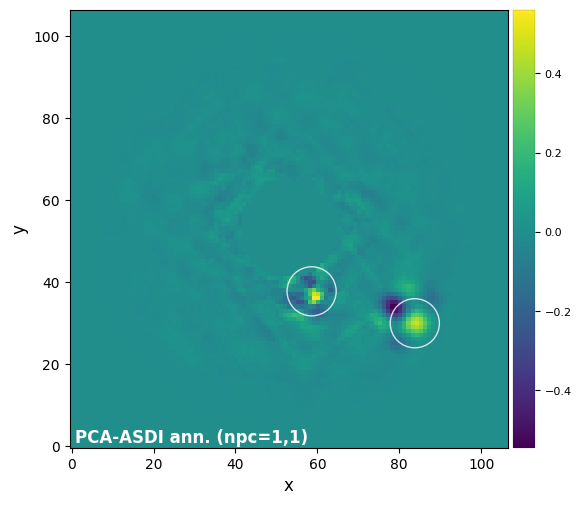

In [57]:
plot_frames(pca_ann, label='PCA-ASDI ann. (npc={:.0f},{:.0f})'.format(ncomp[0], ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [58]:
snr_b = snr(pca_ann, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

10.256502247434712
38.183397286765874


In [59]:
from vip_hci.metrics import significance

sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

At a separation of 16.3 px (2.7 FWHM), S/N = 10.3 corresponds to a 5.5-sigma detection in terms of Gaussian false alarm probability.
5.507620264057997
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


### 7.5.6. PCA-ADI for all spectral channels

If you provide a 4d input cube without `scale_list` to the `pca` or `pca_annular` functions, their default behaviour will be to perform PCA-ADI on each spectral channel and then combine the final ADI images from each spectral channel into a single one. 

In [60]:
mask_px = int(0.08/plsc)

Let's try different flavours of PCA. First let's run it in full frames:

In [61]:
ncomp_ff = 6
pca_adi_mean = pca(cube_fc, derot_angles, ncomp=ncomp_ff, mask_center_px=mask_px,
                   interp_zeros=True, mask_val=0, imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:12:54
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 4.495 GB
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.025753
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:00.176483
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.201717
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:00.333163
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55

Now in concentric annuli, with a PA threshold (set by `delta_rot`):

In [62]:
ncomp_ann = 4
pca_adi_ann_mean = pca_annular(cube_fc, derot_angles, ncomp=ncomp_ann, radius_int=mask_px, 
                               fwhm=np.mean(fwhm), asize=2*np.mean(fwhm), delta_rot=(0.2,1),
                               mask_val=0, interp_zeros=True, imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.073142
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.143501
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.212753
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:00:00.337409
――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:49.579859
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:50.101250
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:50.517896
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:01:52.889167
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:53.510397
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:25.052289
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:02:27.416946
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.011655
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.470096
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.911330
―――――――――――――――――――――――――――――――――――――――――――――

Finally, let's also run it as a single wide annulus including both injected planets:

In [63]:
from vip_hci.psfsub import pca_annulus
ncomp_a = 3
pca_adi_a_mean = pca_annulus(cube_fc, derot_angles, ncomp=ncomp_a, r_guess=(r_b+r_c)/2, 
                             annulus_width=r_c, mask_val=0, interp_zeros=True,
                             imlib=imlib, interpolation=interpolation)

Let's compare the results:

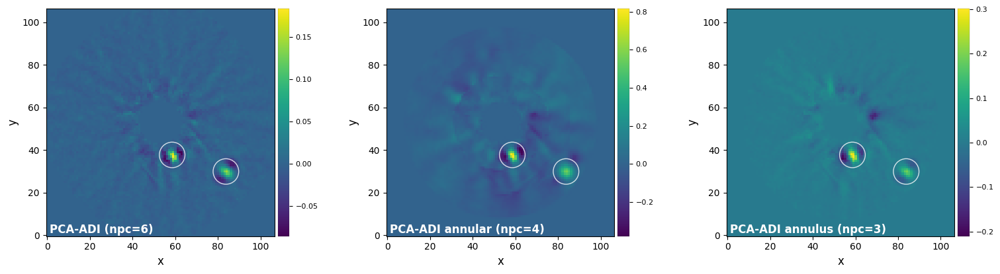

In [64]:
plot_frames((pca_adi_mean, pca_adi_ann_mean, pca_adi_a_mean),
            label=('PCA-ADI (npc={:.0f})'.format(ncomp_ff),
                   'PCA-ADI annular (npc={:.0f})'.format(ncomp_ann),
                   'PCA-ADI annulus (npc={:.0f})'.format(ncomp_a)),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [65]:
snr_b_ff = snr(pca_adi_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_ann = snr(pca_adi_ann_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_a = snr(pca_adi_a_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b_ff, snr_b_ann, snr_b_a)
snr_b = max(snr_b_ff, snr_b_ann, snr_b_a)

snr_c_ff = snr(pca_adi_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_ann = snr(pca_adi_ann_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_a = snr(pca_adi_a_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c_ff, snr_c_ann, snr_c_a)
snr_c = max(snr_c_ff, snr_c_ann, snr_c_a)

9.964573707993969 6.194275923450149 4.66802632340663
31.68870348575484 11.400843358758891 24.62141695011342


In [66]:
sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

At a separation of 16.3 px (2.7 FWHM), S/N = 10.0 corresponds to a 5.4-sigma detection in terms of Gaussian false alarm probability.
5.4402589914742165
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


In this case, we see that ADI alone recovers better the innermost planet. This is because of the bright stellar residuals at the edge of the coronagraphic mask, preventing SDI to do a good job at that separation.

<font color=green> **Answer 7.1**: The scaling factors are such that all spectral channels are upscaled, for the stellar halo to match the last spectral channel, i.e. all factors are >= 1 (exactly 1 for the last spectral channel). The PSF model and subtraction with PCA is then made with these upscaled images, where the planet is now present at different radial separations. However since we injected a very red spectrum for planet c (blackbody of 1100 K), it is the brightest in the last spectral channels. This means the strongest positive (resp. negative) imprint will be in the long (resp. short) wavelength channels, where the planet was not moved (resp. moved radially outward), i.e. the positive (resp. negative) imprint is unchanged (resp. radially inward) with respect to its position in the upscaled cube. After final downscaling, the negative imprint stays thus radially inward from the location of the fake planet. 
You can test this explanation by injecting a blue spectrum for planet c (e.g. 1/blackbody). </font>

## 7.6. Astrometry retrieval

The `firstguess` function can accept a 4D input cube to infer a first guess on the position (a single one for all channels) and fluxes (one per channel). Since it would be very slow to run it on all 39 spectral channels, let's just focus on the 8 channels (~20% of all channels) with the maximum S/N ratio. Let's find these channels for planet c. 

As the rest of this tutorial is CPU-intensive, **we will only focus on planet c** - although the same procedure can be applied to planet b.

### 7.6.1. Spectral channels with maximum SNR

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.015988
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=1.406
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.223
Central pixel S/N = 1.169
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 1.403
Max S/N (shifting the aperture center) = 2.257
stddev S/N (shifting the aperture center) = 0.568

Opt SNR: 1.4063089535482303, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starti

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.560
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.131
Central pixel S/N = 4.489
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.574
Max S/N (shifting the aperture center) = 4.695
stddev S/N (shifting the aperture center) = 0.771

Opt SNR: 3.5602248545586095, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:21
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011252
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.363
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.365
Central pixel S/N = 3.768
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.360
Max S/N (shifting the aperture center) = 4.876
stddev S/N (shifting the aperture center) = 0.682

Opt SNR: 3.3626980817283143, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:23
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011868
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.550
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.724
Central pixel S/N = 4.389
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.563
Max S/N (shifting the aperture center) = 4.322
stddev S/N (shifting the aperture center) = 0.507

Opt SNR: 3.5502305170160655, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:24
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011759
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.470
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.982
Central pixel S/N = 4.377
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.471
Max S/N (shifting the aperture center) = 4.256
stddev S/N (shifting the aperture center) = 0.499

Opt SNR: 3.4698632910288603, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:26
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012074
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.916
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.235
Central pixel S/N = 4.827
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.908
Max S/N (shifting the aperture center) = 4.797
stddev S/N (shifting the aperture center) = 0.590

Opt SNR: 3.916225936470824, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011183
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.614
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.048
Central pixel S/N = 4.412
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.581
Max S/N (shifting the aperture center) = 4.569
stddev S/N (shifting the aperture center) = 0.571

Opt SNR: 3.6135802171964686, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:29
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012034
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.132
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.449
Central pixel S/N = 5.372
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.137
Max S/N (shifting the aperture center) = 5.290
stddev S/N (shifting the aperture center) = 0.670

Opt SNR: 4.131694929293173, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:31
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012198
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.444
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.665
Central pixel S/N = 5.831
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.430
Max S/N (shifting the aperture center) = 5.878
stddev S/N (shifting the aperture center) = 0.874

Opt SNR: 4.4439416063272565, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:33
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011930
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.104
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.562
Central pixel S/N = 5.136
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.033
Max S/N (shifting the aperture center) = 5.448
stddev S/N (shifting the aperture center) = 0.842

Opt SNR: 4.104053999251509, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012210
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.275
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.083
Central pixel S/N = 5.335
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.247
Max S/N (shifting the aperture center) = 5.563
stddev S/N (shifting the aperture center) = 0.938

Opt SNR: 4.274648308514962, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:36
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011522
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=4.568
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.937
Central pixel S/N = 6.006
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.385
Max S/N (shifting the aperture center) = 6.781
stddev S/N (shifting the aperture center) = 1.192

Opt SNR: 4.567581165395516, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011724
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=5.285
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.977
Central pixel S/N = 6.535
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.804
Max S/N (shifting the aperture center) = 7.018
stddev S/N (shifting the aperture center) = 1.416

Opt SNR: 5.285306873289676, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:40
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011518
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=6.249
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.265
Central pixel S/N = 7.268
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.373
Max S/N (shifting the aperture center) = 7.461
stddev S/N (shifting the aperture center) = 1.470

Opt SNR: 6.248772057434861, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:42
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011207
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 6, for S/N=6.068
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.061
Central pixel S/N = 7.042
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.016
Max S/N (shifting the aperture center) = 7.526
stddev S/N (shifting the aperture center) = 1.624

Opt SNR: 6.068012373571435, for npc=6
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:43
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011086
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 7, for S/N=7.357
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.238
Central pixel S/N = 8.839
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.367
Max S/N (shifting the aperture center) = 9.763
stddev S/N (shifting the aperture center) = 2.016

Opt SNR: 7.357160738234539, for npc=7
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011736
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=5.498
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.937
Central pixel S/N = 6.952
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.478
Max S/N (shifting the aperture center) = 8.156
stddev S/N (shifting the aperture center) = 1.455

Opt SNR: 5.497754944878419, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:47
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.013256
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.958
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.309
Central pixel S/N = 5.803
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.023
Max S/N (shifting the aperture center) = 7.694
stddev S/N (shifting the aperture center) = 1.342

Opt SNR: 4.958337133832107, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:48
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011993
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.867
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.237
Central pixel S/N = 6.064
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.887
Max S/N (shifting the aperture center) = 7.327
stddev S/N (shifting the aperture center) = 1.337

Opt SNR: 4.86717150875319, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:50
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011400
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=6.235
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.397
Central pixel S/N = 7.616
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.559
Max S/N (shifting the aperture center) = 8.355
stddev S/N (shifting the aperture center) = 1.775

Opt SNR: 6.235338735660249, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:52
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011420
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=7.010
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.939
Central pixel S/N = 8.242
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.619
Max S/N (shifting the aperture center) = 9.557
stddev S/N (shifting the aperture center) = 1.671

Opt SNR: 7.009718967616468, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:53
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011678
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/Users/valentin/GitHub/VIP/vip_hci/psfsub/utils_pca.py:381: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=vip_figsize, dpi=vip_figdpi)
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=8.449
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.581
Central pixel S/N = 9.729
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 7.798
Max S/N (shifting the aperture center) = 12.240
stddev S/N (shifting the aperture center) = 2.354

Opt SNR: 8.449402885740437, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:55
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012551
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.653
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.166
Central pixel S/N = 12.208
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.903
Max S/N (shifting the aperture center) = 12.388
stddev S/N (shifting the aperture center) = 2.410

Opt SNR: 10.652623435621434, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:57
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011126
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.948
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.436
Central pixel S/N = 12.679
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.807
Max S/N (shifting the aperture center) = 12.636
stddev S/N (shifting the aperture center) = 2.461

Opt SNR: 10.94836595921952, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:13:58
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011479
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=13.553
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.981
Central pixel S/N = 13.963
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.520
Max S/N (shifting the aperture center) = 14.787
stddev S/N (shifting the aperture center) = 2.766

Opt SNR: 13.553138958166437, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011345
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=11.518
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.691
Central pixel S/N = 13.452
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.950
Max S/N (shifting the aperture center) = 14.002
stddev S/N (shifting the aperture center) = 3.179

Opt SNR: 11.517917838233831, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012005
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=12.303
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.905
Central pixel S/N = 14.045
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 9.448
Max S/N (shifting the aperture center) = 14.375
stddev S/N (shifting the aperture center) = 3.292

Opt SNR: 12.302622347535388, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012329
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=14.285
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.259
Central pixel S/N = 14.322
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.231
Max S/N (shifting the aperture center) = 16.152
stddev S/N (shifting the aperture center) = 3.339

Opt SNR: 14.285192902401466, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:05
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011765
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=16.080
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.390
Central pixel S/N = 13.661
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.084
Max S/N (shifting the aperture center) = 14.894
stddev S/N (shifting the aperture center) = 3.317

Opt SNR: 16.080018802256177, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:07
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012045
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=17.060
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.735
Central pixel S/N = 13.771
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.397
Max S/N (shifting the aperture center) = 15.881
stddev S/N (shifting the aperture center) = 3.451

Opt SNR: 17.05996364878732, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:08
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011515
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=18.046
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.651
Central pixel S/N = 13.531
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.727
Max S/N (shifting the aperture center) = 16.195
stddev S/N (shifting the aperture center) = 3.772

Opt SNR: 18.04575540019397, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:10
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011367
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=17.494
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 4.455
Central pixel S/N = 17.641
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.917
Max S/N (shifting the aperture center) = 18.422
stddev S/N (shifting the aperture center) = 3.596

Opt SNR: 17.493987274848244, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:12
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011494
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=18.575
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.238
Central pixel S/N = 18.353
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 12.649
Max S/N (shifting the aperture center) = 18.763
stddev S/N (shifting the aperture center) = 3.816

Opt SNR: 18.574606583512946, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:13
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011344
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=19.378
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.632
Central pixel S/N = 16.965
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.769
Max S/N (shifting the aperture center) = 18.142
stddev S/N (shifting the aperture center) = 3.565

Opt SNR: 19.378346551373337, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:15
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011902
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=21.623
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 5.144
Central pixel S/N = 18.531
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 13.619
Max S/N (shifting the aperture center) = 22.455
stddev S/N (shifting the aperture center) = 4.724

Opt SNR: 21.6225984457153, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012116
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=20.234
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.507
Central pixel S/N = 16.550
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.978
Max S/N (shifting the aperture center) = 18.420
stddev S/N (shifting the aperture center) = 3.866

Opt SNR: 20.23417766686806, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:18
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012753
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=19.646
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 16.880
Central pixel S/N = 21.843
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 16.372
Max S/N (shifting the aperture center) = 22.743
stddev S/N (shifting the aperture center) = 4.135

Opt SNR: 19.646378561808145, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:20
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011776
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=20.957
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 15.671
Central pixel S/N = 24.066
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 17.039
Max S/N (shifting the aperture center) = 24.544
stddev S/N (shifting the aperture center) = 4.638

Opt SNR: 20.9571453805684, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:22
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011291
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 2, for S/N=23.472
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.541
Central pixel S/N = 14.163
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 14.471
Max S/N (shifting the aperture center) = 19.366
stddev S/N (shifting the aperture center) = 3.306

Opt SNR: 23.471827344534468, for npc=2


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:16: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_62354/2238327887.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


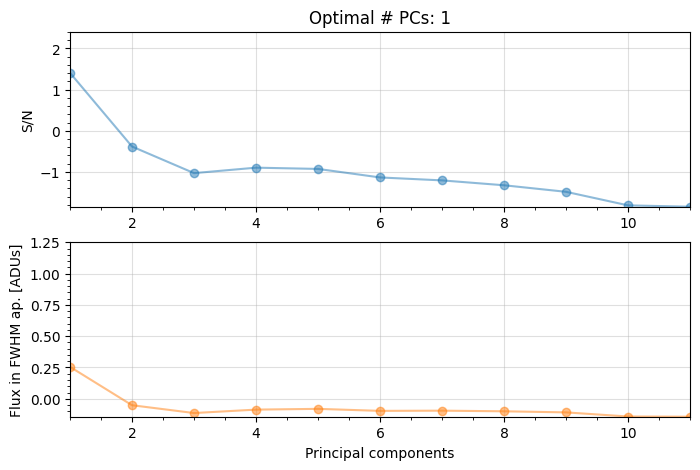

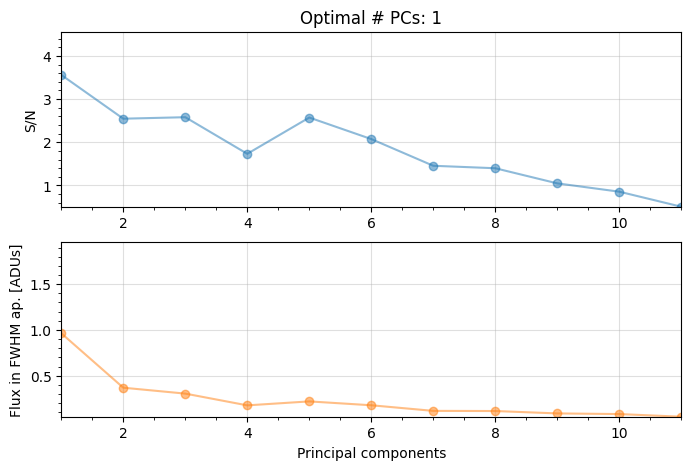

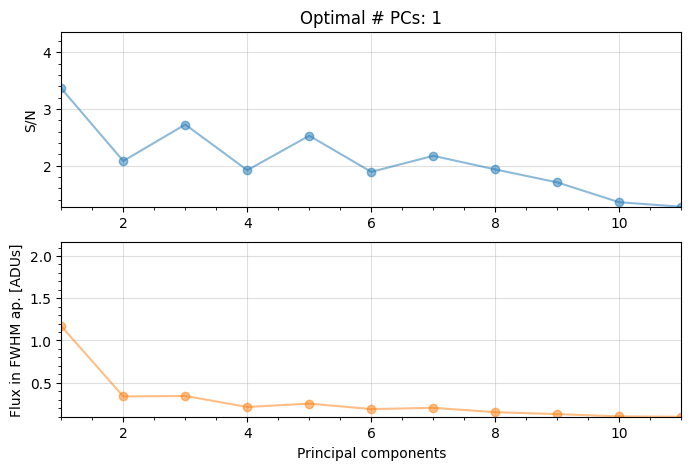

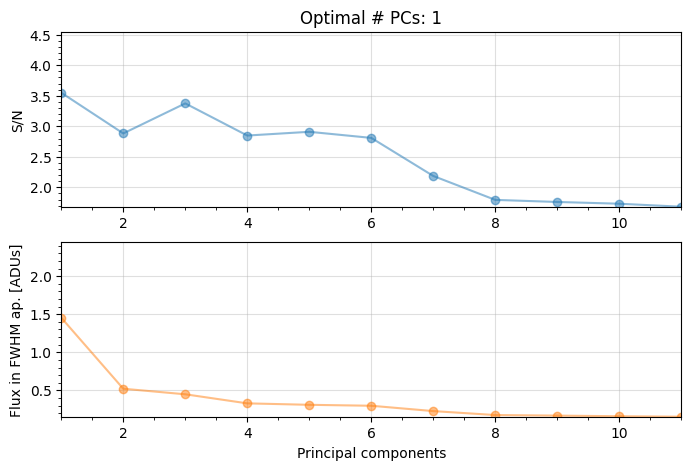

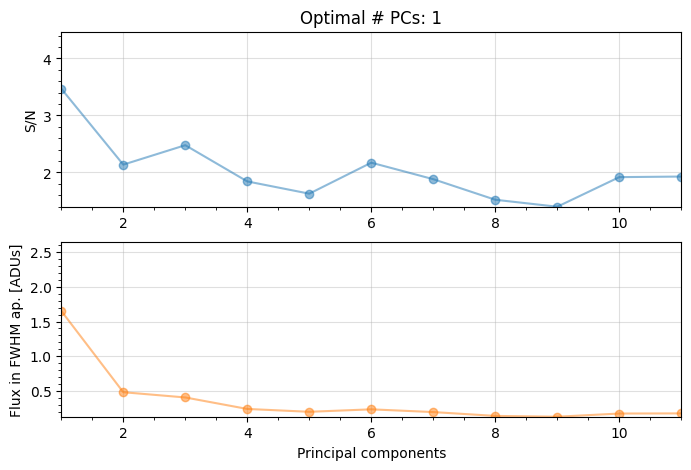

...

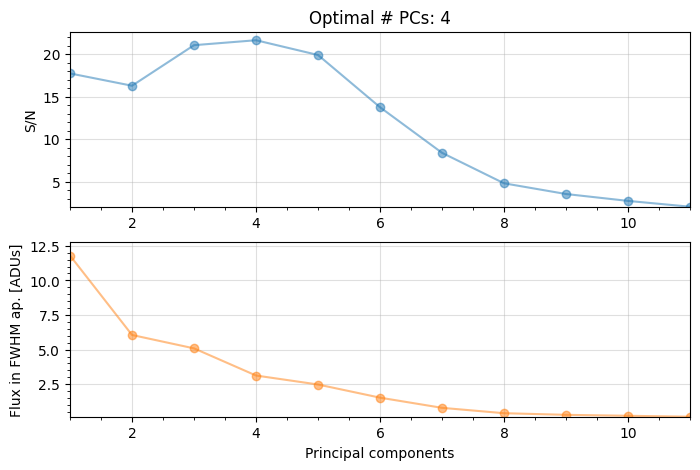

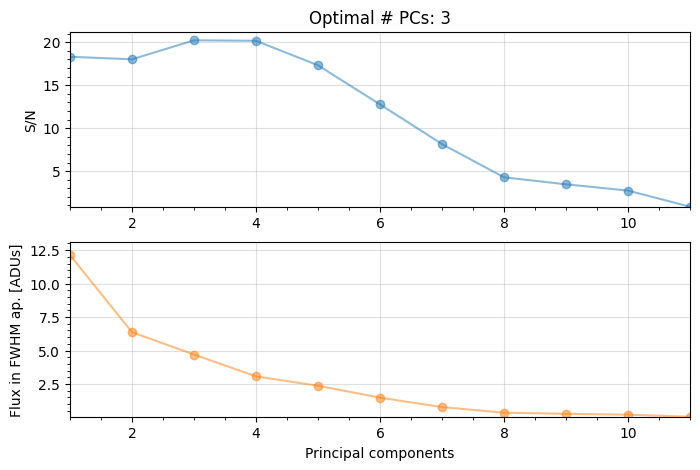

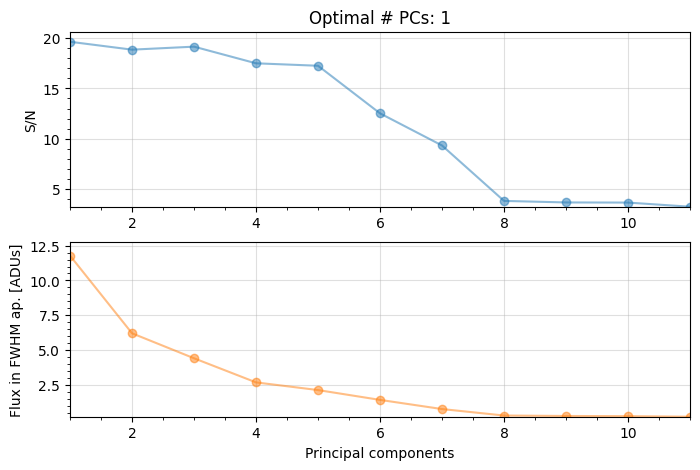

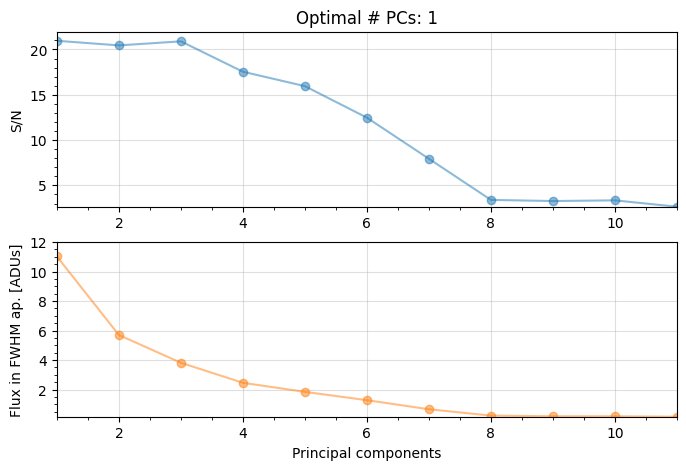

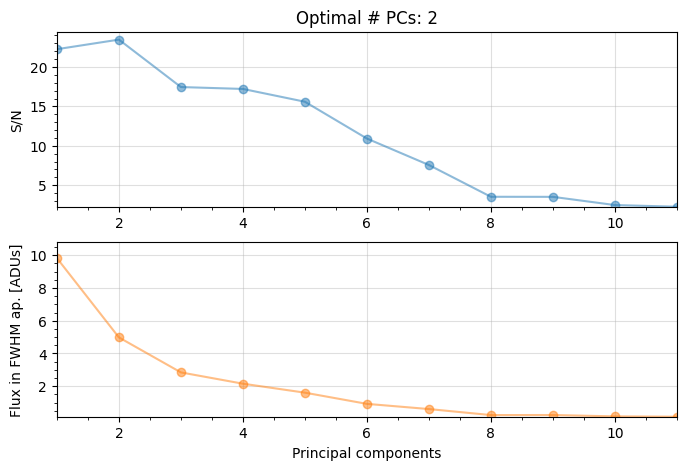

In [67]:
from vip_hci.psfsub import pca_grid

all_frs = []
all_snrs = []
all_pcs = []
for i in range(nch):
    res_ann_opt = pca_grid(cube_fc[i], derot_angles, fwhm=fwhm[i], range_pcs=(1,11,1), 
                           source_xy=xy_c, mode='annular', annulus_width=int(4*fwhm[i]), 
                           imlib=imlib, interpolation=interpolation, full_output=True,
                           plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, df, opt_npc_ann = res_ann_opt
    all_frs.append(final_ann_opt)
    pcs = df['PCs']
    snrs = df['S/Ns']
    opt_snr = snrs[df.index[pcs==opt_npc_ann]]
    print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
    all_snrs.append(float(opt_snr))
    all_pcs.append(opt_npc_ann)

Let's plot the results:

Text(0, 0.5, 'SNR of c')

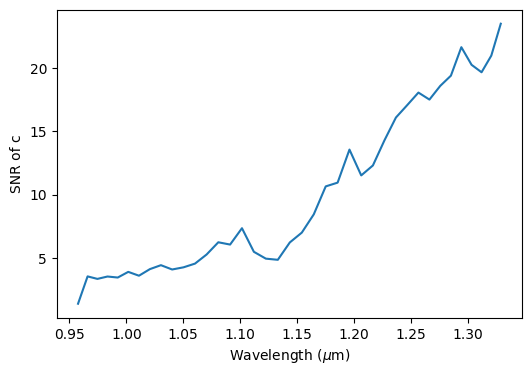

In [68]:
plt.figure(figsize=(6,4))
plt.plot(lbda, all_snrs)
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("SNR of c")

Let's (reverse) sort to only keep the best 8 channels:

In [69]:
order_snr = np.flip(np.argsort(all_snrs))
sorted_npc = np.array(all_pcs)[order_snr]
sorted_ch = np.arange(nch)[order_snr]
sorted_frs = np.array(all_frs)[order_snr]
sorted_snr = np.array(all_snrs)[order_snr]

Let's finally show these 8 channels with optimal SNR:

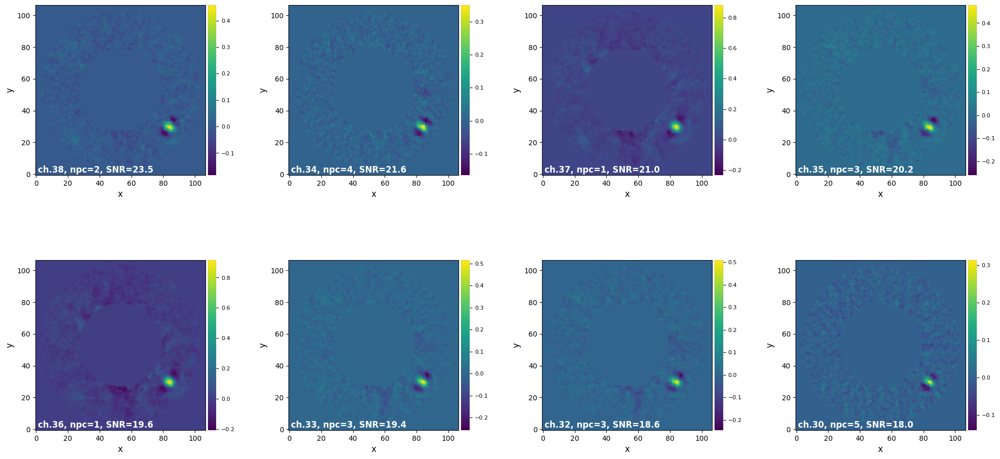

In [70]:
cutoff = 8
final_frs_c = tuple(sorted_frs[:cutoff])
final_chs_c = sorted_ch[:cutoff]
final_npcs_c = sorted_npc[:cutoff]

labels = ['ch.{}, npc={}, SNR={:.1f}'.format(final_chs_c[i], final_npcs_c[i], sorted_snr[i]) for i in range(cutoff)]
labels = tuple(labels)

plot_frames(final_frs_c, label=labels, rows=2)

### 7.6.2. NEGFC+PCA-ADI (simplex)

Let's now find the optimal position of planet c by running the `firstguess` function on the 8 best spectral channels (corresponding to the highest SNR, as determined above):

In [71]:
crop_cube_c = cube_fc[final_chs_c]
crop_cube_c.shape

(8, 55, 107, 107)

In [72]:
psfn_crop_c = psfn[final_chs_c]

In [73]:
trans_crop_c = [trans[0]]
for i in final_chs_c:
    trans_crop_c.append(trans[i])
trans_crop_c = np.array(trans_crop_c)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:14:30
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.8,29.9], running ...
Processing spectral channel 0...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 1...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.5)
Processing spectral channel 2...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 3...
... optimal grid flux: 38.566 ($\chi^2_r$ = 1.4)
Processing spectral channel 4...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 5...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 6...
... optimal gr

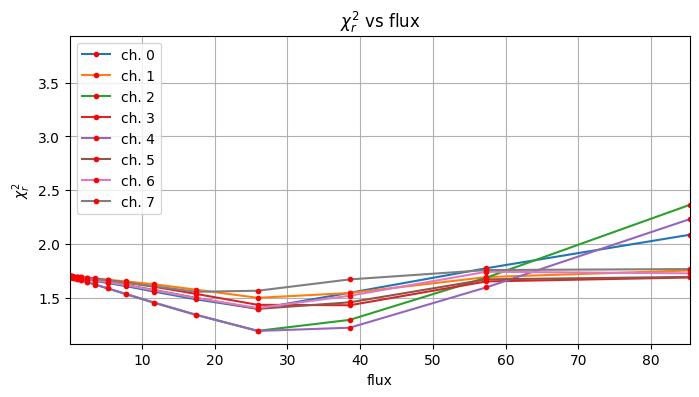

Planet 0: preliminary position guess: (r, theta)=(38.5, 323.1)
Planet 0: preliminary flux guess: 25.9, 25.9, 25.9, 38.6, 25.9, 25.9, 25.9, 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: False, nit: 800, nfev: 1135, chi2r: 0.08276889315529153
message: Maximum number of iterations has been exceeded.
Planet 0 simplex result: (r, theta, f0, f1, f2, f3, f4, f5, f6, f7)=(25.824, 30.148, 29.690, 32.573, 31.254, 29.678, 27.446, 20.235) at 
          (X,Y)=(83.76, 29.96)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:25:47.854777
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


In [74]:
from vip_hci.fm import firstguess
res = firstguess(crop_cube_c, derot_angles, psfn_crop_c, ncomp=list(final_npcs_c),
                 planets_xy_coord=[xy_c], fwhm=np.mean(fwhm), annulus_width=int(4*np.mean(fwhm)),
                 aperture_radius=2, imlib=imlib, interpolation=interpolation, transmission=trans_crop_c, mu_sigma=True, 
                 force_rPA=False, simplex=True, plot=True, verbose=True)
r0c = res[0]
theta0c = res[1]
fluxes0c = res[2]

In [75]:
res

(array([38.43253916]),
 array([323.17559754]),
 array([[25.82444464, 30.14816396, 29.69045928, 32.57313187, 31.25379338,
         29.67769211, 27.44598683, 20.23480794]]))

Let's compare the estimates to their respective ground truth values:

In [76]:
print("r (gt): {:.2f} VS. r (estimated): {:.2f}".format(r_c, r0c[0]))
print("theta (gt): {:.2f} VS. r (estimated): {:.2f}".format(theta_c%360, theta0c[0]))
for i, ch in enumerate(final_chs_c):
    print("flux ch.{} (gt): {:.2f} VS. r (estimated): {:.2f}".format(ch, flux_c_scal[ch], fluxes0c[0,i]))

r (gt): 38.50 VS. r (estimated): 38.43
theta (gt): 323.13 VS. r (estimated): 323.18
flux ch.38 (gt): 24.66 VS. r (estimated): 25.82
flux ch.34 (gt): 29.42 VS. r (estimated): 30.15
flux ch.37 (gt): 28.25 VS. r (estimated): 29.69
flux ch.35 (gt): 30.51 VS. r (estimated): 32.57
flux ch.36 (gt): 30.09 VS. r (estimated): 31.25
flux ch.33 (gt): 27.34 VS. r (estimated): 29.68
flux ch.32 (gt): 25.13 VS. r (estimated): 27.45
flux ch.30 (gt): 22.10 VS. r (estimated): 20.23


### 7.6.3. NEGFC+PCA-ADI (MCMC)

A better, albeit slower way, to infer the astrometry of each planet with uncertainties is to use an MCMC approach. Our specific case can be solved with the `mcmc_negfc_sampling`, which can, since VIP v1.2.3, also deal with 4D cubes. We refer to [Tutorial 5A](https://vip.readthedocs.io/en/latest/tutorials/05_fm_planets.html#5.3.3.-NEGFC-technique-coupled-with-MCMC) for more details on how to set up the parameters for the MCMC algorithm.

In [77]:
import pickle

lab='c'
ann_width = 4*np.mean(fwhm)
aperture_radius=2
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': 2}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

---
**NOTE**

When the flux variation is known throughout the observation (e.g. through a background star or satellite spots) or if you wish to take into account the effect of airmass, it is possible to provide a `weights` parameter for the injection of the mean flux to be scaled at the moment of injection in each image to follow in (this is a new addition since [Christiaens et al. 2021](https://ui.adsabs.harvard.edu/abs/2021MNRAS.502.6117C/abstract)).

---

In [78]:
weights=X_fac

In [79]:
# input to MCMC
init = [r0c[0], theta0c[0]]
for i in range(cutoff):
    init.append(fluxes0c[0,i])
initial_state = np.array(init)
obs_params['psfn']= psfn[final_chs_c]
obs_params['fwhm']= np.mean(fwhm[final_chs_c])
obs_params['transmission']= trans_crop_c
algo_params['ncomp'] = list(final_npcs_c)

**Warning**: The following box is very computer intensive. It can be skipped if needed.

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 01:40:18
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean and stddev in the annulus at the radius of the companion (excluding the PA area directly adjacent to it) are -0.00 and 0.08 respectively.
Beginning emcee Ensemble sampler...
emcee Ensemble sampler successful

Start of the MCMC run ...
Step  |  Duration/step (sec)  |  Remaining Estimated Time (sec)
0		69.10150			34481.64750
1		70.38974			35054.08952
2		70.64976			35112.93171
3		70.32726			34882.32344
4		70.31969			34808.24853
5		70.12417			34641.34047
6		69.13378			34082.95453
7		68.08337			33497.01755
8		66.94712			32871.03739
9		65.65391			32170.41786
10		65.47468			32017.12048
11		65.63236			32028.59119
12		65.40325			31851.38275
13		65.78572			31971.

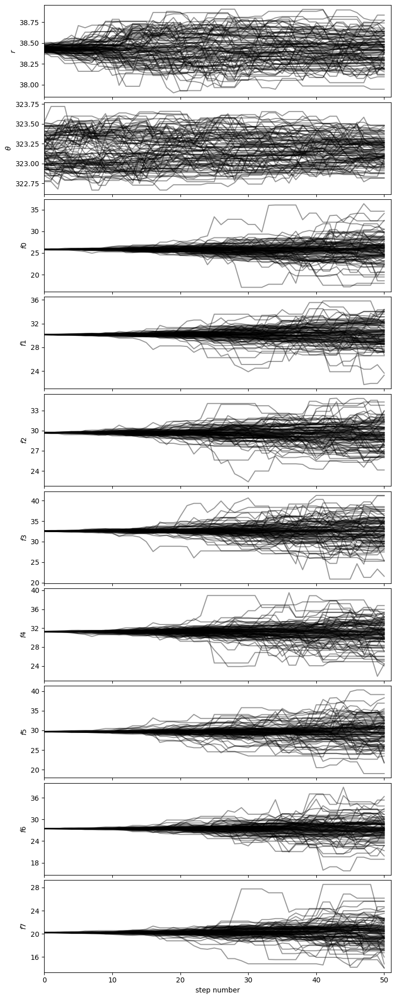

51		65.77181			29465.76909
52		65.13044			29113.30891
53		64.78686			28894.93778
54		64.76459			28820.24389
55		64.58652			28676.41666
56		64.86785			28736.45666
57		64.78501			28634.97530
58		64.54376			28463.79772
59		64.68614			28461.90380
60		64.59766			28358.37274
61		64.70940			28342.71676
62		64.52251			28196.33906
63		64.84607			28272.88478
64		64.70725			28147.65462
65		64.61343			28042.22688
66		64.41416			27891.33041
67		64.45911			27846.33682
68		64.50542			27801.83731
69		64.53843			27751.52275
70		64.55637			27694.68230
71		64.59572			27646.96645
72		64.55703			27565.85181
73		64.37567			27424.03542
74		64.56288			27439.22357
75		64.43844			27321.89898
76		64.52859			27295.59484
77		64.36883			27163.64795
78		64.70226			27239.65104
79		64.31643			27012.90144
80		64.65907			27092.15033
81		64.46646			26946.98028
82		64.49274			26893.47091
83		64.41137			26795.12950
84		63.32284			26278.98026
85		64.46981			26690.50134
86		64.32250			26565.19291
87		64.60929			26619.02748
8

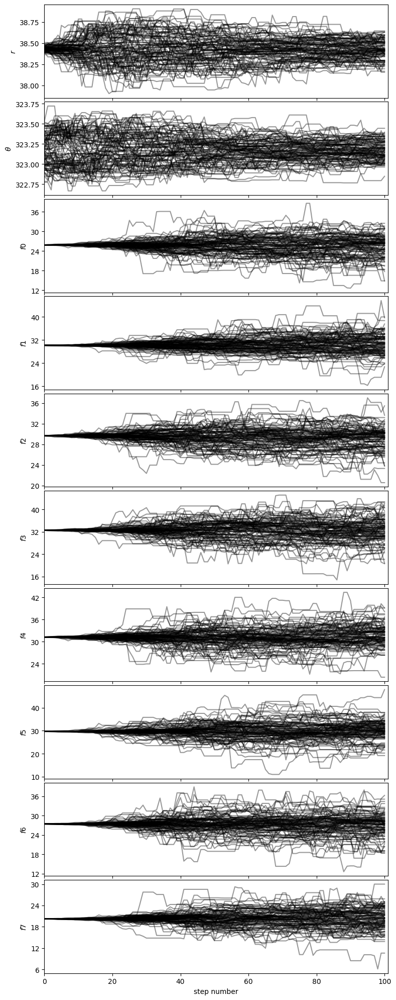

101		65.35359			26010.73081
102		64.46111			25591.06146
103		64.40998			25506.35050
104		64.64519			25534.85163
105		65.11216			25654.18986
106		64.62996			25399.57467
107		64.45225			25265.28318
108		64.41375			25185.77508
109		64.40050			25116.19500
110		64.52227			25099.16303
111		64.46349			25011.83334
112		64.55560			24983.01797
113		64.60452			24937.34549
114		64.48660			24827.34138
115		64.61032			24810.36173
116		64.42314			24674.06147
117		63.41358			24223.98565
118		64.42407			24545.57181
119		63.45794			24114.01644
120		64.47397			24435.63425
121		64.52483			24390.38612
122		64.41621			24284.90966
123		64.49574			24250.39899
124		64.49558			24185.84288
125		63.41879			23718.62858
126		64.43552			24034.44784
127		63.40901			23588.15209
128		64.48817			23925.11070
129		64.58192			23895.31077
130		64.50108			23800.89741
131		64.39233			23696.37634
132		64.55367			23691.19689
133		64.59301			23641.03983
134		64.58404			23573.17569
135		64.54276			23493.56428
136		64.59448			2344

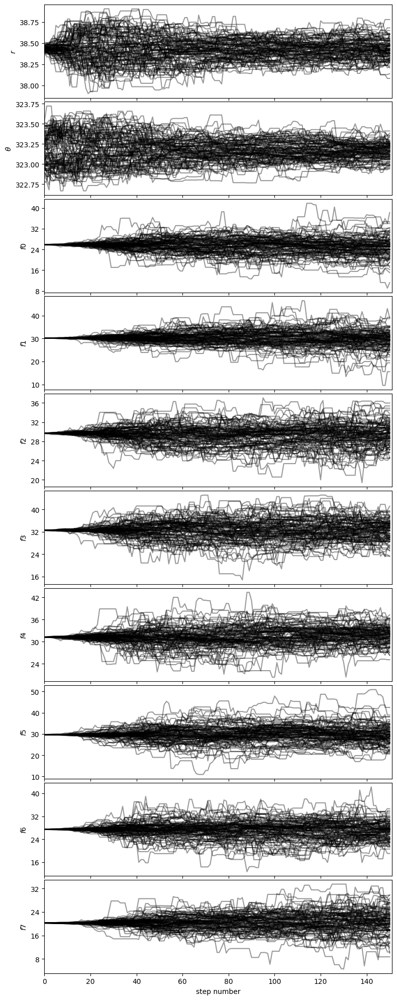

151		65.55320			22812.51430
152		63.48570			22029.53825
153		64.65335			22370.06014
154		64.50945			22255.75991
155		62.54949			21517.02559
156		64.65488			22176.62555
157		64.72806			22136.99686
158		64.53451			22006.26689
159		64.43912			21909.30216
160		63.39501			21490.90703
161		64.51465			21805.95035
162		64.56346			21757.88535
163		64.49134			21669.08856
164		63.48442			21267.28070
165		63.40678			21177.86285
166		63.38168			21106.10044
167		64.51771			21419.87806
168		64.46182			21336.86143
169		63.30185			20889.61149
170		63.35699			20844.45037
171		64.55652			21174.53758
172		63.29980			20699.03395
173		64.55652			21045.42487
174		64.54127			20975.91178
175		62.25903			20171.92637
176		63.30719			20448.22108
177		63.49076			20444.02375
178		63.37942			20344.79446
179		63.43160			20298.11296
180		63.41009			20227.81839
181		64.37211			20470.33098
182		64.55231			20463.08132
183		63.32424			20010.46016
184		64.50314			20318.48879
185		64.49669			20251.96129
186		62.30541			1950

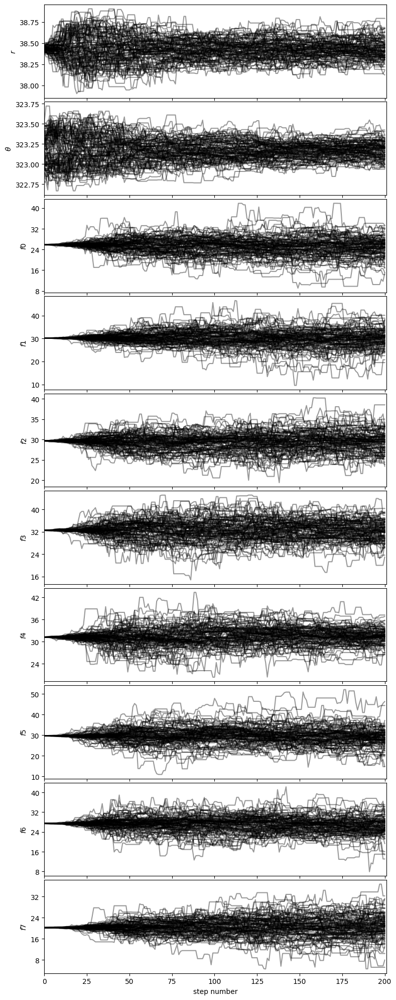

Auto-corr tau/N = [0.08825114 0.0890703  0.08830965 0.08479887 0.08639839 0.08363511
 0.08214653 0.08262982 0.08387087 0.08727944]
tau/N <= 0.02 = [False False False False False False False False False False] 

201		65.42148			19495.59985
202		64.59289			19184.08803
203		62.32305			18447.62339
204		64.50040			19027.61682
205		62.30186			18316.74566
206		63.31675			18551.80658
207		62.27551			18184.44950
208		62.23531			18110.47434
209		64.38070			18670.40387
210		64.17019			18545.18433
211		62.47577			17993.02176
212		64.60363			18541.24066
213		61.25857			17519.95216
214		64.89098			18493.92902
215		63.36934			17996.89199
216		64.67945			18304.28407
217		63.50968			17909.73004
218		63.38679			17811.68940
219		63.40588			17753.64528
220		63.54142			17728.05506
221		64.48538			17926.93508
222		62.49969			17312.41358
223		64.54580			17814.64025
224		63.50042			17462.61523
225		64.79923			17754.99039
226		64.12330			17505.65981
227		64.52731			17551.42941
228		63.68386			17258.32687
229		

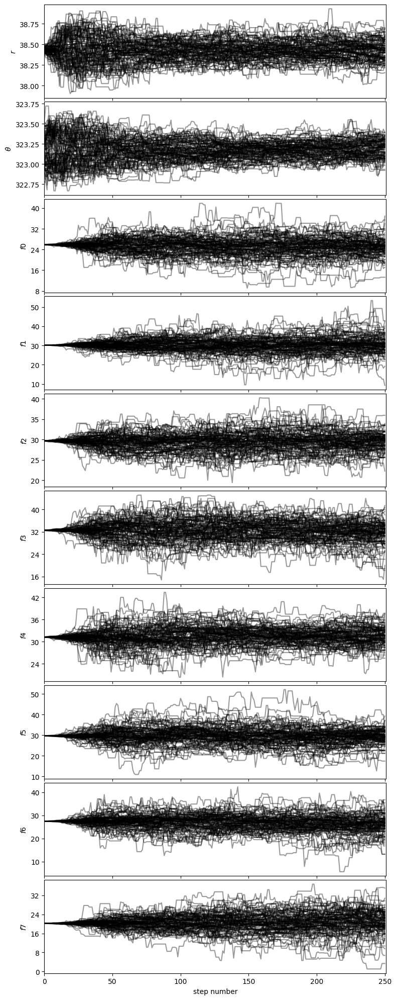

Auto-corr tau/N = [0.0851049  0.08775836 0.08204713 0.08293709 0.08473747 0.08220145
 0.08442458 0.08421853 0.08404465 0.08159753]
tau/N <= 0.02 = [False False False False False False False False False False] 

251		64.72934			16052.87682
252		64.57650			15950.39501
253		64.41331			15845.67401
254		63.50113			15557.77758
255		64.52081			15743.07886
256		63.56329			15445.87996
257		63.52425			15372.86826
258		64.72598			15598.96118
259		64.64465			15514.71600
260		64.45463			15404.65561
261		64.51586			15354.77349
262		63.44311			15036.01802
263		63.43475			14970.60076
264		63.25527			14864.98775
265		63.54042			14868.45758
266		63.35931			14762.71900
267		64.76735			15026.02520
268		64.57045			14915.77487
269		65.10278			14973.63917
270		64.78981			14836.86672
271		63.69447			14522.33984
272		62.30984			14144.33300
273		63.78238			14414.81698
274		64.53185			14519.66580
275		64.58691			14467.46851
276		63.36584			14130.58143
277		64.54730			14329.49971
278		64.62441			14281.99483
279		

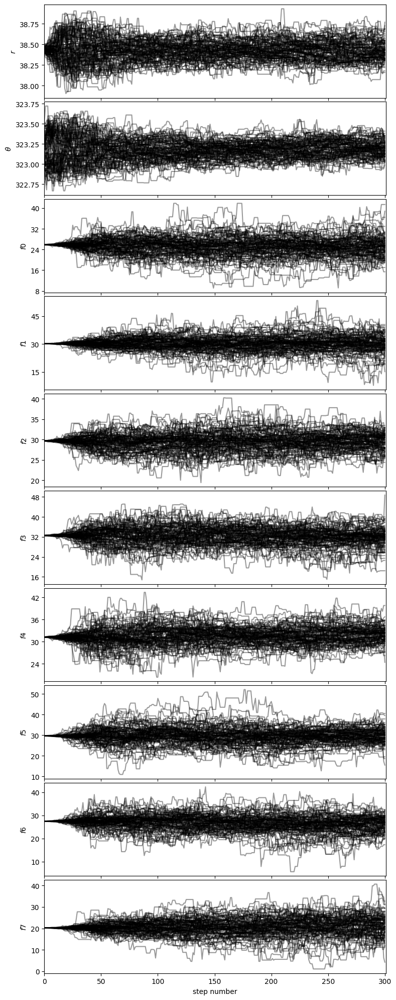

Auto-corr tau/N = [0.08152211 0.08425074 0.08021075 0.07992368 0.07905069 0.07755864
 0.08376986 0.08172281 0.08209425 0.07990995]
tau/N <= 0.02 = [False False False False False False False False False False] 

301		64.49429			12769.87021
302		64.56674			12719.64817
303		63.71542			12488.22193
304		63.44585			12371.94114
305		64.57672			12527.88465
306		63.30504			12217.87214
307		64.69016			12420.51149
308		63.35596			12100.98874
309		62.38018			11852.23325
310		63.57525			12015.72320
311		62.35177			11722.13238
312		63.40649			11857.01363
313		63.33472			11780.25792
314		64.75621			11979.89848
315		64.49770			11867.57717
316		63.50250			11620.95695
317		63.36685			11532.76743
318		63.75403			11539.47997
319		64.49672			11609.40996
320		64.77589			11594.88377
321		64.43766			11469.90348
322		64.59912			11434.04424
323		64.59251			11368.28176
324		63.59337			11128.83957
325		63.31239			11016.35551
326		64.94065			11234.73210
327		64.63856			11117.83284
328		64.58271			11043.64256
329		

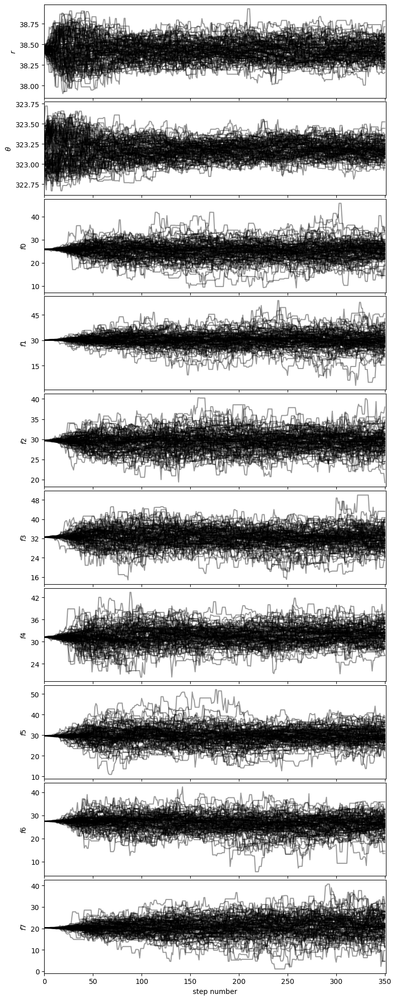

Auto-corr tau/N = [0.07794218 0.08051738 0.0785945  0.07330105 0.07480974 0.07365542
 0.07920863 0.08053773 0.07958189 0.08026824]
tau/N <= 0.02 = [False False False False False False False False False False] 

351		64.73711			9581.09287
352		62.27044			9153.75468
353		63.35845			9250.33443
354		64.64948			9374.17460
355		63.42849			9133.70299
356		63.53202			9085.07886
357		63.44119			9008.64841
358		64.63354			9113.32928
359		64.64319			9050.04716
360		62.28393			8657.46599
361		63.74539			8796.86382
362		63.48746			8697.78175
363		63.45369			8629.70184
364		63.66012			8594.11633
365		63.59453			8521.66675
366		64.52413			8581.70889
367		64.69015			8539.09980
368		64.35809			8430.90979
369		63.73067			8284.98645
370		62.62291			8078.35539
371		62.52847			8003.64365
372		62.61952			7952.67904
373		64.59690			8139.20965
374		64.65637			8082.04650
375		64.56839			8006.47986
376		64.51778			7935.68632
377		63.49262			7746.09976
378		64.50198			7804.73910
379		64.56283			7747.53972
380		6

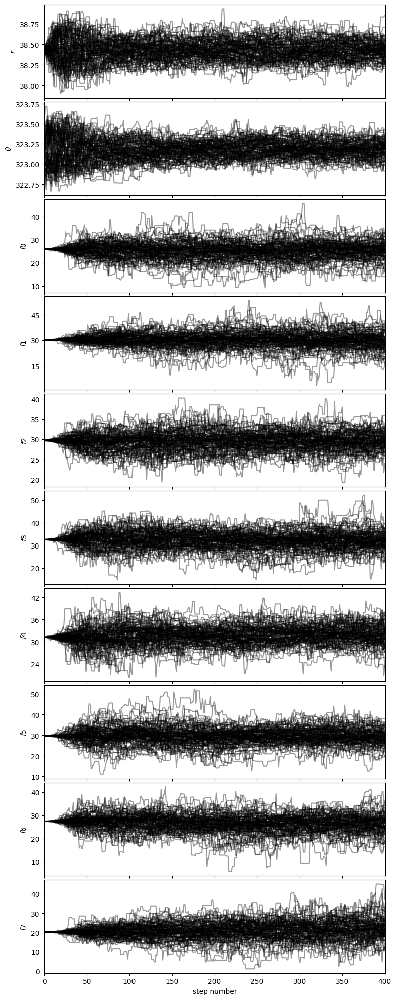

Auto-corr tau/N = [0.07580322 0.07600146 0.07595075 0.07080682 0.07023971 0.07033247
 0.07404796 0.07532302 0.07610442 0.07849756]
tau/N <= 0.02 = [False False False False False False False False False False] 

401		64.93464			6363.59462
402		64.62148			6268.28366
403		63.48104			6094.17994
404		63.51538			6033.96119
405		63.38963			5958.62541
406		62.31530			5795.32281
407		62.31157			5732.66416
408		63.50519			5778.97193
409		64.63726			5817.35322
410		61.28370			5454.24948
411		64.70707			5694.22207
412		64.66367			5625.73920
413		64.57049			5553.06205
414		64.54429			5486.26490
415		63.70456			5351.18296
416		63.39086			5261.44179
417		63.46173			5203.86186
418		64.72719			5242.90263
419		63.40386			5072.30888
420		63.38050			5007.05966
421		64.65895			5043.39779
422		61.17352			4710.36119
423		63.42175			4820.05262
424		63.53749			4765.31190
425		63.48860			4698.15610
426		64.65006			4719.45409
427		63.69564			4586.08630
428		64.96094			4612.22653
429		64.65281			4525.69691
430		6

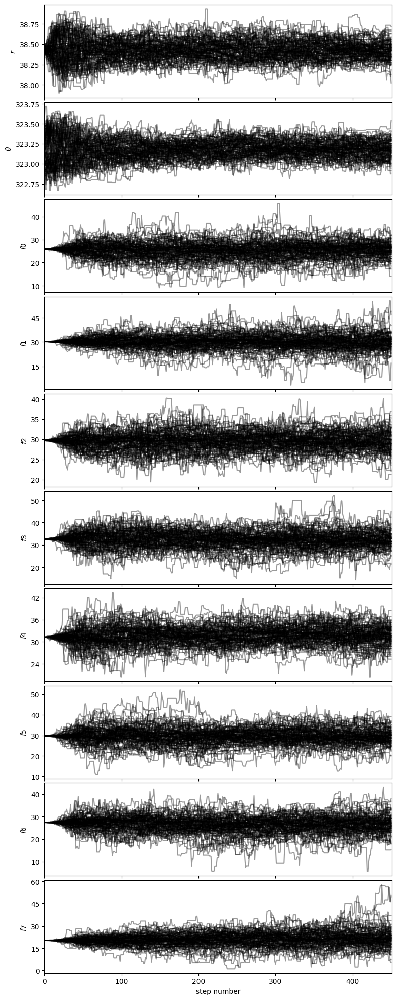

Auto-corr tau/N = [0.0748952  0.0741988  0.07440612 0.07066339 0.06726514 0.06495971
 0.06968956 0.07193227 0.07375219 0.0722367 ]
tau/N <= 0.02 = [False False False False False False False False False False] 

451		65.67930			3152.60650
452		63.46242			2982.73393
453		62.40995			2870.85788
454		61.19368			2753.71574
455		63.83719			2808.83640
456		63.64561			2736.76106
457		64.81754			2722.33681
458		64.68277			2651.99369
459		64.81885			2592.75396
460		64.62910			2520.53506
461		63.53550			2414.34889
462		64.67621			2393.01995
463		63.53941			2287.41876
464		62.32852			2181.49838
465		63.54104			2160.39529
466		64.68145			2134.48772
467		64.57488			2066.39622
468		63.61142			1971.95390
469		63.60851			1908.25521
470		63.57319			1843.62242
471		62.17313			1740.84756
472		62.55663			1689.02890
473		62.53903			1626.01488
474		63.75909			1593.97720
475		63.49268			1523.82422
476		63.79897			1467.37622
477		62.53782			1375.83195
478		62.39402			1310.27448
479		62.22984			1244.59674
480		6

In [80]:
from vip_hci.fm import mcmc_negfc_sampling
chain = mcmc_negfc_sampling(cube_fc[final_chs_c], derot_angles, **obs_params, **algo_params, **negfc_params, 
                            initial_state=initial_state, **mcmc_params, **conv_params, weights=weights,
                            display=True, verbosity=2, save=False, output_dir='./')

If you ran the previous box and wish to write your results, set `write=True` in the next box. This will pickle the MCMC chain.

In [81]:
write=False

if write:
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'wb') as fileSave:
        pickle.dump(output, fileSave)

In [82]:
with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'rb') as fi:
    myPickler = pickle.Unpickler(fi)
    mcmc_result = myPickler.load()

chain = mcmc_result['chain']

Let's visualize the chain after setting labels for each parameter:

In [83]:
labels = [r"$r$", r"$\theta$"]
for i, ch in enumerate(final_chs_c):
    labels.append(r"$f$ (ch.{:.0f})".format(ch))

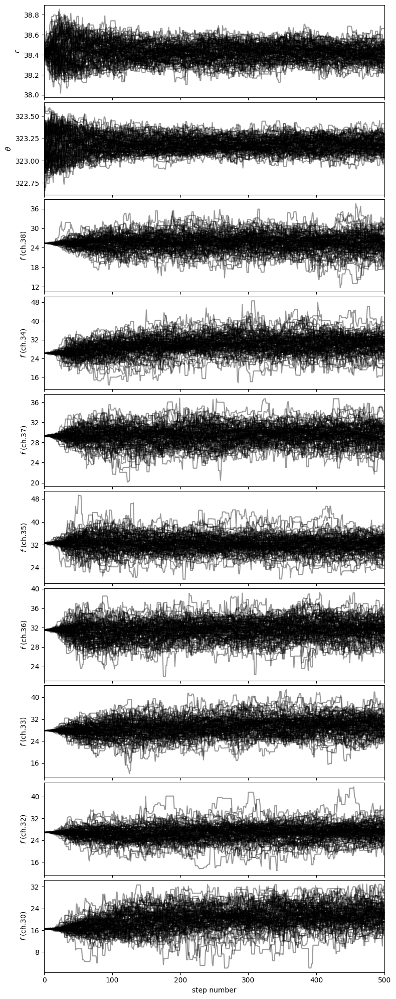

In [84]:
from vip_hci.fm import show_walk_plot
show_walk_plot(chain, labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

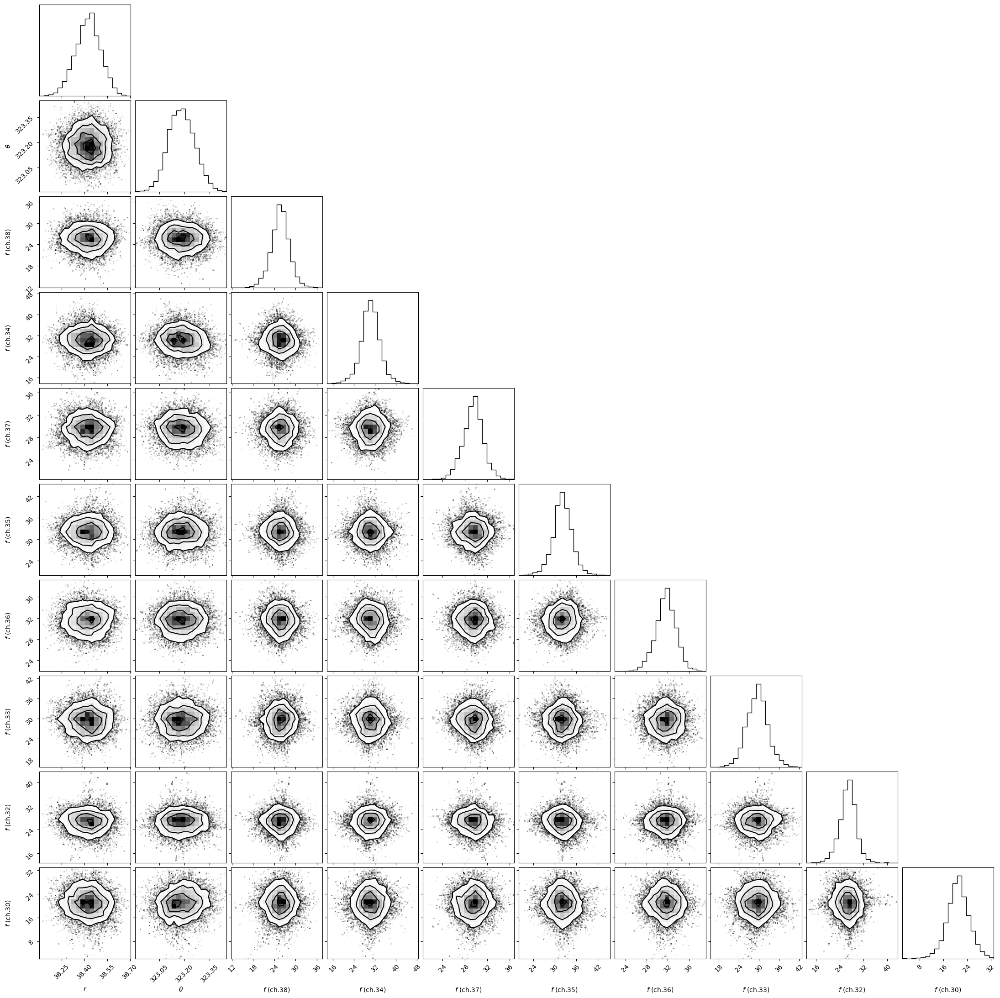

In [85]:
from vip_hci.fm import show_corner_plot
burnin = 0.3
show_corner_plot(chain, burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [86]:
npar = len(initial_state)
isamples_flat = chain[:, int(chain.shape[1]//(1/burnin)):, :].reshape((-1,npar))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

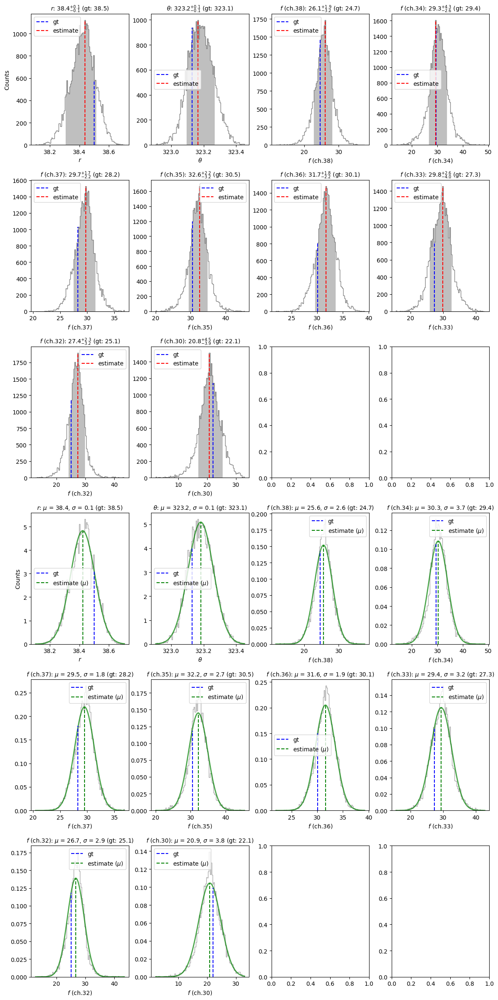

In [87]:
from vip_hci.fm import confidence

gt = [r_c, theta_c%360]
for i, ch in enumerate(final_chs_c):
    gt.append(flux_c_scal[ch])

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated parameters are consistent with the ground truth values (shown with dashed blue lines), within uncertainties.

In [88]:
from vip_hci.var import frame_center
r_est = mu[0]
theta_est = mu[1]

xc, yc = frame_center(cube_fc)
x_est = xc + r_est*np.cos(np.deg2rad(theta_est))
y_est = yc + r_est*np.sin(np.deg2rad(theta_est))

xy_est = (x_est, y_est)

## 7.7. Spectrum retrieval

### 7.7.1. NEGFC+PCA-ADI (simplex)

Let's use the negative fake companion technique (combined with PCA-ADI) to estimate the flux of the companion in each spectral channel. In this section, we will just use the `firstguess` function in VIP which finds a first estimate on a grid of flux values followed by a simplex. The difference with Sec. 7.6 is that here we set `force_rPA=True` to pin the position during the NEGFC procedure (i.e. only allowing the fluxes at different wavelengths as free parameters) - this will be faster and provide more reliable flux estimates in channels where the companion is faint.

In [89]:
est_fluxes_c = np.zeros(nch)
for i in range(nch):
    trans_i = np.array([trans[0],trans[i]])
    res = firstguess(cube_fc[i], derot_angles, psfn[i], ncomp=4, planets_xy_coord=[xy_est], 
                     fwhm=fwhm[i], annulus_width=int(4*fwhm[i]), aperture_radius=2, imlib=imlib, interpolation=interpolation,
                     f_range=None, transmission=trans_i, mu_sigma=True, force_rPA=True, weights=X_fac,
                     simplex=True, plot=False, verbose=False)
    _, _, est_fluxes_c[i] = res

---
**NOTE**

Here we arbitrarily assigned the number of principal components to 4 for the PCA-ADI algorithm used by NEGFC to measure the flux of the outer fake planet. A more rigorous approach would consist in finding the optimal number of principal components for each spectral channel first, as done in [Tutorial 5A (Sec. 5.2)](https://vip.readthedocs.io/en/latest/tutorials/05_fm_planets.html#5.2.-Generating-and-injecting-synthetic-planets) or in the next section. 

---

Let's now compare the retrieved fluxes with and without weights to the ground truth values used for injection:

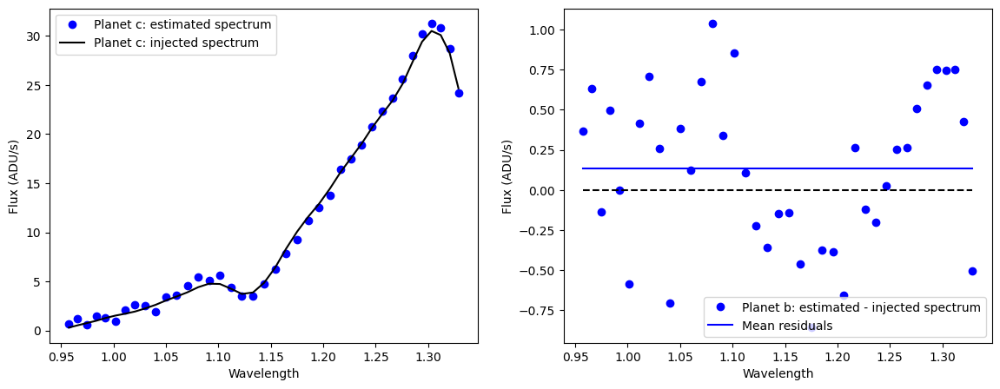

In [90]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, est_fluxes_c, 'bo', label='Planet c: estimated spectrum')
ax1.plot(lbda, flux_c_scal, 'k', label='Planet c: injected spectrum')
ax1.set_xlabel("Wavelength")
ax1.set_ylabel("Flux (ADU/s)")
ax1.legend()

ax2.plot(lbda, est_fluxes_c-flux_c_scal, 'bo', label='Planet b: estimated - injected spectrum')
ax2.plot(lbda, [0]*len(lbda), 'k--')
ax2.plot(lbda, [np.mean(est_fluxes_c-flux_c_scal)]*len(lbda), 'b-', label='Mean residuals')
ax2.set_xlabel("Wavelength")
ax2.set_ylabel("Flux (ADU/s)")
ax2.legend()
plt.show()

This approach does not yield uncertainties. For the latter, it is recommended to run the `mcmc_negfc_sampling` function.

### 7.7.2. NEGFC+PCA-ADI (MCMC)

One can use the MCMC approach to have both estimates and uncertainties on the flux of directly imaged companions. Given that this approach is computationally expensive, we will only apply it to 3 spectral channels. Again, we set `force_rPA=True` to pin the position during the NEGFC procedure as found from the spectral channels where the companions showed the highest SNR.

We refer to [Tutorial 5 (Sec. 5.3.3.)](https://vip.readthedocs.io/en/latest/tutorials/05A_fm_planets.html#5.3.3.-NEGFC-technique-coupled-with-MCMC) for more details on setting the MCMC parameters.

In [91]:
ann_width = 4*np.mean(fwhm)
aperture_radius=2
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': None}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

---
**NOTE**

The pixel intensities in calibrated SPHERE cubes coming out from the DRH pipeline (as this one) are normalized by their integration time. In absence of knowledge of this original integration time, it is not possible to scale the cube back to original ADU values, and it is therefore not possible to include photon noise uncertainty among the different sources of uncertainty (in this specific case, the estimated photon noise uncertainty will be so large that the MCMC will not work properly). To alleviate this issue, we set `sigma` to 'spe', instead of 'spe+pho' (default) - although this may slightly underestimate the final uncertainties.

---

In [92]:
import pickle

lab='c'
test_ch = [20,29,38]

**Warning**: the next box is very computer-intensive. The results from that box have been saved in the 'datasets' folder, such that it can be skipped.

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 10:42:37
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012579
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=6.977
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 30.0
Flux in a centered 1xFWHM circular aperture = 1.942
Central pixel S/N = 8.017
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.579
Max S/N (shifting the aperture center) = 9.557
stddev S/N (shifting the aperture center) = 1.654



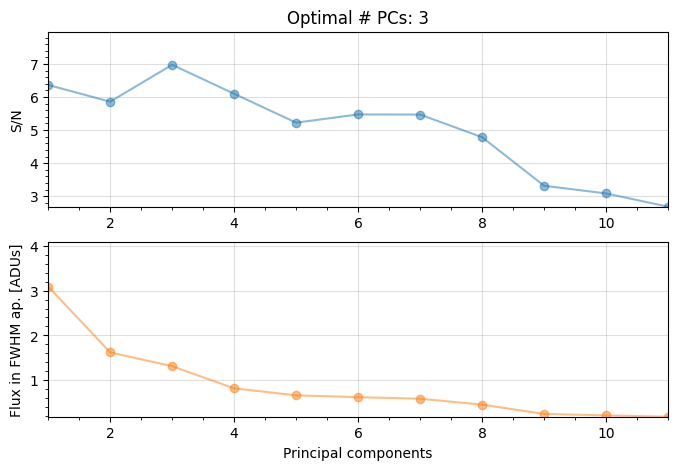

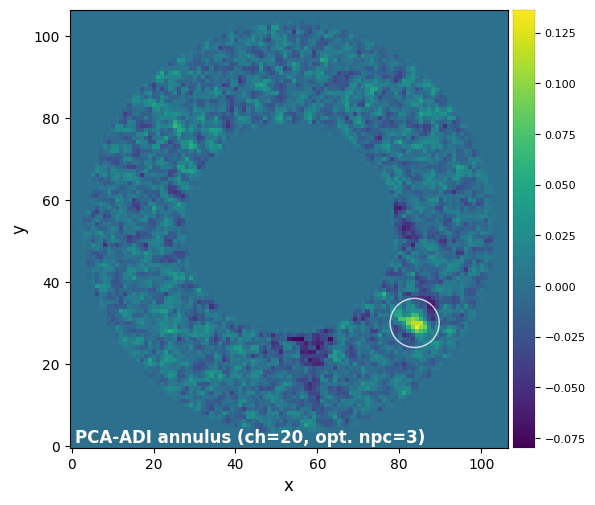

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 10:42:39
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.076
2/30   0.149   0.076
3/30   0.221   0.074
4/30   0.329   0.073
5/30   0.489   0.070
6/30   0.728   0.067
7/30   1.083   0.062
8/30   1.610   0.056
9/30   2.395   0.047
10/30   3.562   0.037
11/30   5.298   0.029
12/30   7.880   0.033
13/30   11.721   0.067
14/30   17.433   0.203


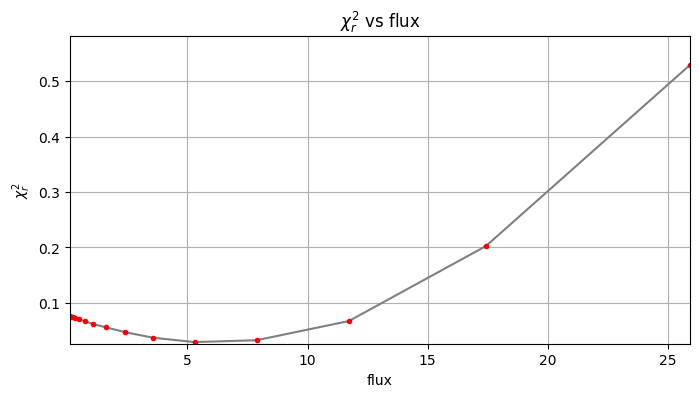

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 5.3
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 22, nfev: 52, chi2r: 0.028704679197324088
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 5.936) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:10.270123
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 10:42:49
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean an

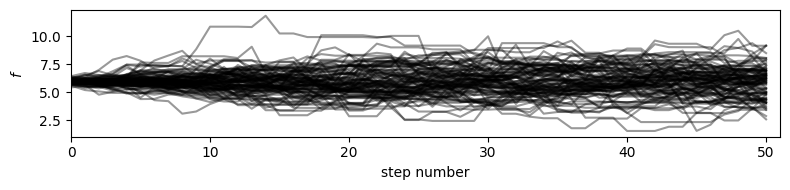

51		8.46653			3793.00499
52		8.47917			3790.19033
53		8.47842			3781.37532
54		8.57320			3815.07578
55		8.54185			3792.58273
56		8.47211			3753.14340
57		8.27826			3658.99092
58		8.53281			3762.96921
59		8.41420			3702.24712
60		8.39664			3686.12628
61		8.50723			3726.16893
62		8.60209			3759.11377
63		8.42333			3672.57101
64		8.40955			3658.15642
65		8.27888			3593.03262
66		8.26458			3578.56184
67		8.39784			3627.86818
68		8.46356			3647.79565
69		8.55610			3679.12128
70		8.53007			3659.40175
71		8.43830			3611.59326
72		8.43833			3603.16691
73		8.44428			3597.26200
74		8.26657			3513.29225
75		8.47035			3591.42628
76		8.42871			3565.34306
77		8.36528			3530.14858
78		8.42568			3547.21128
79		8.40997			3532.18572
80		8.41197			3524.61753
81		8.38458			3504.75319
82		8.46724			3530.83908
83		8.41205			3499.41446
84		8.50688			3530.35686
85		8.40090			3477.97467
86		8.49976			3510.40171
87		8.44372			3478.81388
88		8.39880			3451.90762
89		8.46685			3471.40850
90		8.46056			3460.36986


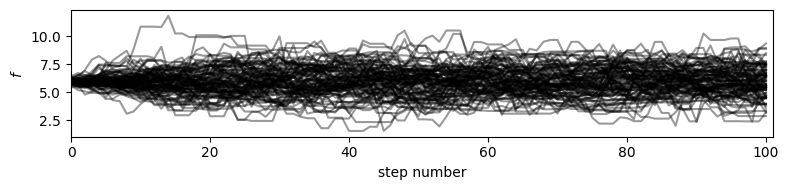

101		8.66419			3448.34881
102		8.40583			3337.11491
103		8.27724			3277.78783
104		8.51517			3363.49096
105		8.51315			3354.18031
106		8.40411			3302.81405
107		8.41380			3298.20842
108		8.38636			3279.06715
109		8.46994			3303.27777
110		8.40810			3270.75090
111		8.44766			3277.69286
112		8.43501			3264.34732
113		8.50063			3281.24357
114		8.43528			3247.58434
115		8.16863			3136.75546
116		8.46263			3241.18652
117		8.46545			3233.80075
118		8.58800			3272.02686
119		8.45203			3211.77254
120		8.44400			3200.27752
121		8.42223			3183.60181
122		8.38387			3160.71974
123		8.36801			3146.37101
124		8.47342			3177.53100
125		8.49028			3175.36435
126		8.59113			3204.49149
127		8.52256			3170.39046
128		8.53858			3167.81392
129		8.45500			3128.35000
130		8.39478			3097.67493
131		8.39519			3089.43066
132		8.48457			3113.83902
133		8.61568			3153.33815
134		8.41462			3071.33484
135		8.42419			3066.40698
136		8.38494			3043.73213
137		8.38861			3036.67537
138		8.42780			3042.43580
139		8.43952

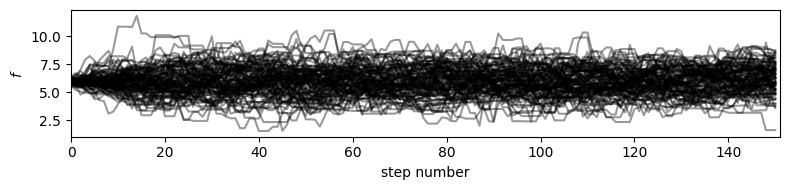

151		8.36507			2911.04297
152		8.44323			2929.80012
153		8.29024			2868.42269
154		8.39602			2896.62518
155		8.48726			2919.61882
156		8.47795			2907.93514
157		8.37096			2862.86900
158		8.45370			2882.71136
159		8.44378			2870.88350
160		8.52383			2889.57905
161		8.47648			2865.05092
162		8.51676			2870.14812
163		8.41570			2827.67621
164		8.51158			2851.37896
165		8.39762			2804.80608
166		8.43209			2807.88664
167		8.47095			2812.35374
168		8.61324			2850.98277
169		8.45888			2791.42941
170		8.49943			2796.31148
171		8.58781			2816.80299
172		8.51905			2785.73066
173		8.46135			2758.40173
174		8.44767			2745.49177
175		8.57026			2776.76392
176		8.50930			2748.50358
177		8.41432			2709.41007
178		8.48219			2722.78331
179		8.40976			2691.12192
180		8.46376			2699.93880
181		8.49420			2701.15624
182		8.66866			2747.96617
183		8.72199			2756.15042
184		8.20521			2584.64020
185		8.65173			2716.64165
186		8.52600			2668.63769
187		8.82845			2754.47702
188		8.64928			2689.92670
189		8.96518

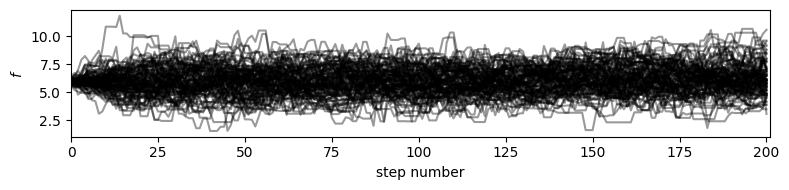

Auto-corr tau/N = [0.06736869]
tau/N <= 0.02 = [False] 

201		8.74183			2605.06594
202		8.56071			2542.53028
203		8.63949			2557.28815
204		8.60888			2539.62049
205		8.59598			2527.21694
206		8.56397			2509.24350
207		8.77413			2562.04654
208		8.53807			2484.57982
209		8.71586			2527.60056
210		8.80830			2545.59928
211		8.69281			2503.52842
212		8.86330			2543.76796
213		8.78638			2512.90554
214		8.70153			2479.93577
215		8.50532			2415.51202
216		8.66201			2451.34911
217		8.64169			2436.95714
218		8.59527			2415.27087
219		8.50802			2382.24616
220		8.53489			2381.23347
221		8.53624			2373.07528
222		8.37715			2320.47166
223		8.59321			2371.72513
224		8.49634			2336.49213
225		8.41183			2304.84115
226		8.33120			2274.41869
227		8.40149			2285.20555
228		8.41304			2279.93276
229		8.36966			2259.80874
230		8.56030			2302.72204
231		8.52893			2285.75244
232		8.53195			2278.03199
233		8.40221			2234.98653
234		8.44205			2237.14325
235		8.38328			2213.18671
236		8.43290			2217.85375
237		8.

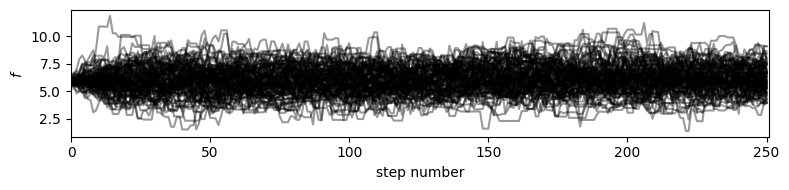

Auto-corr tau/N = [0.06109414]
tau/N <= 0.02 = [False] 

251		8.46137			2098.41877
252		8.45169			2087.56669
253		8.44760			2078.11083
254		8.25324			2022.04307
255		8.45235			2062.37389
256		8.41860			2045.72029
257		8.46861			2049.40386
258		8.32825			2007.10753
259		8.59789			2063.49456
260		8.38356			2003.67132
261		8.38313			1995.18494
262		8.38265			1986.68734
263		8.32629			1965.00420
264		8.13934			1912.74466
265		8.37116			1958.85144
266		8.44417			1967.49254
267		8.55470			1984.69017
268		8.35296			1929.53353
269		8.49863			1954.68582
270		8.48413			1942.86554
271		8.34374			1902.37272
272		8.37636			1901.43463
273		8.40776			1900.15286
274		8.38951			1887.63975
275		8.37470			1875.93370
276		8.36484			1865.35977
277		8.38387			1861.21958
278		8.36244			1848.09902
279		8.34526			1835.95654
280		8.50473			1862.53675
281		8.64467			1884.53806
282		8.39605			1821.94328
283		8.40390			1815.24262
284		8.36943			1799.42745
285		8.19132			1752.94227
286		8.27526			1762.63038
287		8.

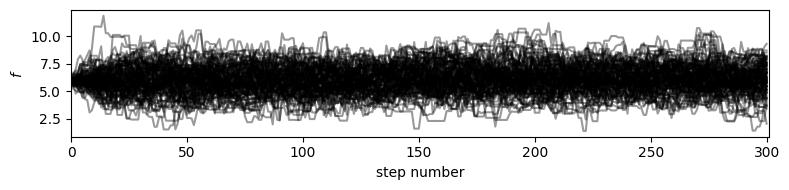

Auto-corr tau/N = [0.05476862]
tau/N <= 0.02 = [False] 

301		8.76618			1735.70404
302		8.57551			1689.37567
303		8.42008			1650.33588
304		8.48895			1655.34447
305		8.42757			1634.94858
306		8.37390			1616.16309
307		8.31656			1596.77933
308		8.34984			1594.81868
309		8.64015			1641.62793
310		8.56163			1618.14769
311		8.76167			1647.19340
312		8.40429			1571.60223
313		8.48529			1578.26413
314		8.56080			1583.74726
315		8.39172			1544.07666
316		8.44790			1545.96625
317		8.61730			1568.34842
318		8.34830			1511.04302
319		8.45231			1521.41580
320		8.45810			1514.00008
321		8.41369			1497.63753
322		8.36790			1481.11795
323		8.44496			1486.31314
324		8.53788			1494.12883
325		8.46916			1473.63401
326		8.43969			1460.06689
327		8.56009			1472.33565
328		8.43270			1441.99204
329		8.38878			1426.09328
330		8.48343			1433.69899
331		8.36368			1405.09891
332		8.58097			1433.02216
333		8.80361			1461.39893
334		8.54147			1409.34288
335		8.36326			1371.57480
336		8.20920			1338.10025
337		8.

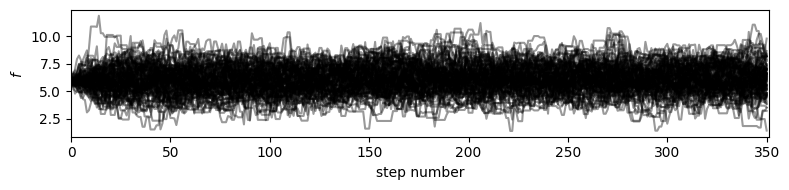

Auto-corr tau/N = [0.04813414]
tau/N <= 0.02 = [False] 

351		8.76704			1297.52192
352		8.72586			1282.70157
353		8.46158			1235.39010
354		8.37140			1213.85315
355		8.53871			1229.57381
356		8.17146			1168.51892
357		8.69209			1234.27735
358		8.73902			1232.20112
359		8.37488			1172.48334
360		8.44312			1173.59354
361		8.40731			1160.20878
362		8.33196			1141.47907
363		8.13998			1107.03742
364		8.78453			1185.91209
365		8.57029			1148.41926
366		8.51661			1132.70900
367		8.32973			1099.52462
368		8.49760			1113.18586
369		8.36399			1087.31883
370		8.36536			1079.13092
371		8.44042			1080.37414
372		8.56952			1088.32891
373		8.69722			1095.84922
374		8.42526			1053.15812
375		8.47035			1050.32340
376		8.33724			1025.48003
377		8.20263			1000.72110
378		8.37294			1013.12586
379		8.44407			1013.28900
380		8.55231			1017.72430
381		8.24019			972.34254
382		8.46014			989.83661
383		8.23585			955.35872
384		8.40956			967.09905
385		8.46588			965.11021
386		8.53968			964.98350
387		8.53060	

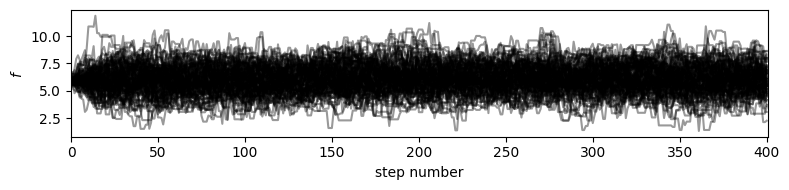

Auto-corr tau/N = [0.04241741]
tau/N <= 0.02 = [False] 

401		8.80739			863.12422
402		8.50931			825.40317
403		8.36754			803.28346
404		8.50366			807.84751
405		8.20260			771.04431
406		8.25721			767.92090
407		8.20134			754.52365
408		8.41022			765.33029
409		8.38832			754.94835
410		8.41362			748.81245
411		8.39826			739.04688
412		8.20384			713.73425
413		8.40677			722.98231
414		8.41363			715.15897
415		8.38898			704.67440
416		8.43101			699.77358
417		8.26742			677.92885
418		8.40000			680.39968
419		8.37906			670.32464
420		8.35677			660.18507
421		8.34239			650.70681
422		8.36878			644.39614
423		8.37528			636.52158
424		8.43602			632.70135
425		8.39645			621.33745
426		8.42130			614.75468
427		8.43321			607.19112
428		8.41257			597.29240
429		8.35362			584.75354
430		8.40836			580.17663
431		8.35842			568.37229
432		8.42096			564.20459
433		8.23491			543.50426
434		8.38765			545.19738
435		8.36866			535.59398
436		8.41482			530.13353
437		8.56419			530.97953
438		8.50290			518

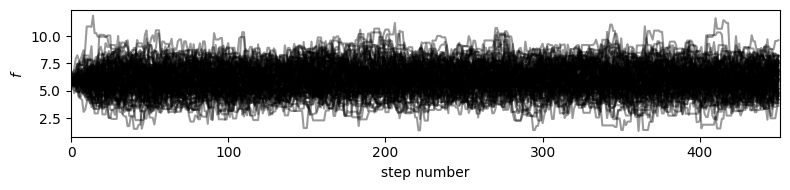

Auto-corr tau/N = [0.03837134]
tau/N <= 0.02 = [False] 

451		8.60681			413.12712
452		8.48155			398.63266
453		8.38991			385.93586
454		8.40566			378.25452
455		8.34736			367.28371
456		8.42360			362.21484
457		8.36054			351.14260
458		8.27865			339.42465
459		8.50182			340.07276
460		8.44209			329.24155
461		8.41257			319.67781
462		8.35615			309.17766
463		8.40189			302.46811
464		8.38138			293.34833
465		8.41065			285.96196
466		8.66398			285.91118
467		8.80095			281.63043
468		8.46503			262.41584
469		8.53799			256.13967
470		8.52892			247.33882
471		8.39304			235.00501
472		8.44769			228.08763
473		8.52256			221.58653
474		8.42783			210.69582
475		8.48329			203.59901
476		8.35349			192.13018
477		8.32020			183.04438
478		8.37630			175.90224
479		8.42216			168.44316
480		8.40780			159.74828
481		8.40186			151.23343
482		8.73588			148.50996
483		8.28253			132.52042
484		8.39848			125.97725
485		8.56581			119.92138
486		8.39902			109.18720
487		8.43713			101.24557
488		8.31836			91.

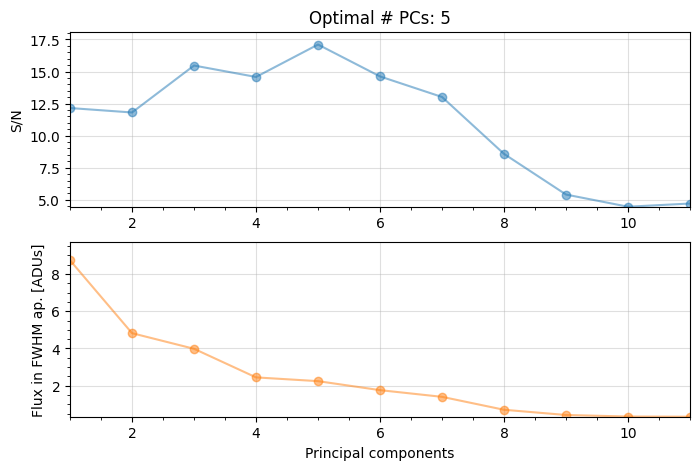

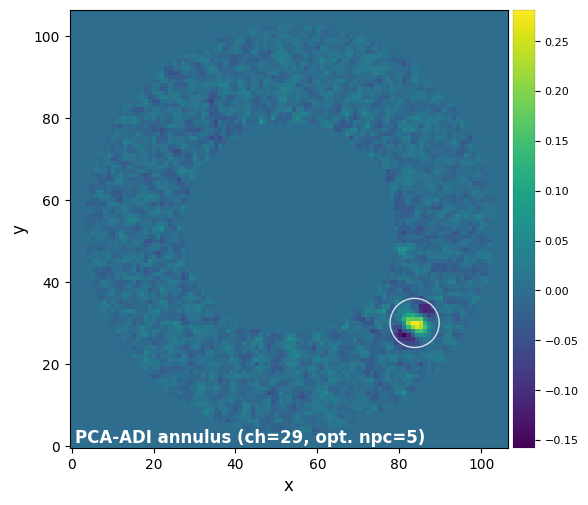

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 11:53:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.248
2/30   0.149   0.248
3/30   0.221   0.247
4/30   0.329   0.245
5/30   0.489   0.242
6/30   0.728   0.238
7/30   1.083   0.232
8/30   1.610   0.221
9/30   2.395   0.206
10/30   3.562   0.186
11/30   5.298   0.158
12/30   7.880   0.121
13/30   11.721   0.076
14/30   17.433   0.037
15/30   25.929   0.051
16/30   38.566   0.213
17/30   57.362   0.492


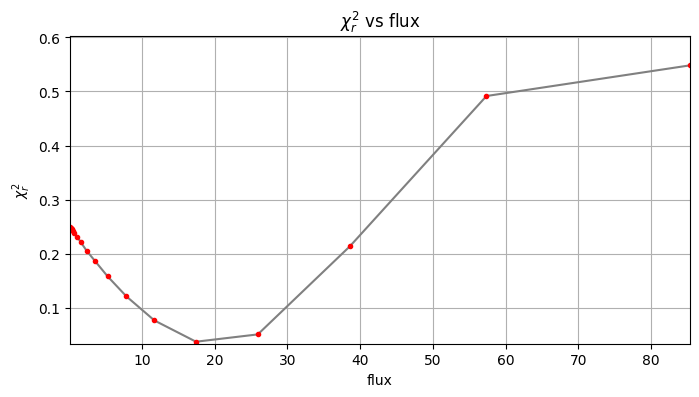

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 24, nfev: 56, chi2r: 0.03196977506017989
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 20.157) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:11.447552
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 11:53:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean a

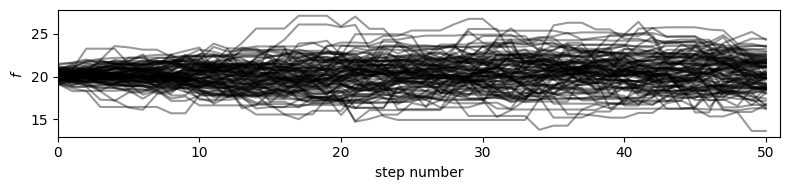

51		8.60340			3854.32410
52		8.88500			3971.59411
53		8.76161			3907.67895
54		8.40585			3740.60325
55		8.47432			3762.59764
56		8.45248			3744.44953
57		8.52177			3766.62190
58		8.46462			3732.89786
59		8.43798			3712.70988
60		8.44393			3706.88308
61		8.54462			3742.54181
62		8.46101			3697.45962
63		8.43375			3677.11500
64		8.39919			3653.64591
65		8.54604			3708.98266
66		8.46646			3665.97934
67		8.53890			3688.80437
68		8.67243			3737.81518
69		8.44546			3631.54909
70		8.43973			3620.64245
71		8.46179			3621.64526
72		8.65550			3695.89722
73		8.71683			3713.36745
74		8.55262			3634.86308
75		8.62284			3656.08416
76		8.63207			3651.36476
77		8.55388			3609.73736
78		8.69994			3662.67390
79		8.73381			3668.20188
80		8.63850			3619.53150
81		8.73325			3650.49641
82		8.45441			3525.48897
83		8.90563			3704.74291
84		8.46620			3513.47466
85		8.49281			3516.02293
86		8.58512			3545.65415
87		8.47208			3490.49572
88		8.51379			3499.16605
89		8.43556			3458.57837
90		8.46311			3461.41240


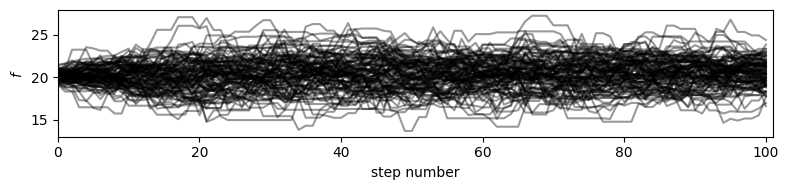

101		8.59143			3419.38834
102		8.41927			3342.45178
103		8.61076			3409.86056
104		8.53557			3371.54896
105		8.48303			3342.31421
106		8.46926			3328.41918
107		8.41632			3299.19587
108		8.49487			3321.49339
109		8.45130			3296.00739
110		8.49018			3302.68041
111		8.60135			3337.32574
112		8.46758			3276.95346
113		8.56584			3306.41463
114		8.39376			3231.59837
115		8.66742			3328.29082
116		8.41773			3223.98906
117		8.55344			3267.41370
118		8.56213			3262.17305
119		8.46509			3216.73306
120		8.42241			3192.09453
121		8.44292			3191.42452
122		8.43998			3181.87284
123		8.45005			3177.21805
124		8.55868			3209.50350
125		8.45147			3160.84941
126		8.40874			3136.45890
127		8.40032			3124.91792
128		8.61837			3197.41453
129		8.41693			3114.26373
130		8.39913			3099.28008
131		8.60594			3166.98445
132		8.49803			3118.77554
133		8.39954			3074.23237
134		8.41101			3070.01719
135		8.47350			3084.35327
136		8.50146			3086.02962
137		8.58669			3108.38106
138		8.64964			3122.52004
139		8.44959

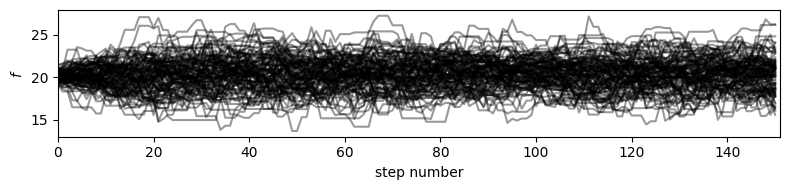

151		8.69258			3025.01645
152		8.47301			2940.13586
153		8.48092			2934.39901
154		8.37787			2890.36377
155		8.43706			2902.34967
156		8.64586			2965.52861
157		8.40544			2874.66116
158		8.48948			2894.91268
159		8.75316			2976.07304
160		8.66115			2936.12951
161		8.42774			2848.57713
162		8.45163			2848.19998
163		8.47921			2849.01355
164		8.43179			2824.64864
165		8.45856			2825.15971
166		8.60571			2865.70210
167		8.52473			2830.20870
168		8.44384			2794.91104
169		8.40510			2773.68267
170		8.55912			2815.95048
171		8.48000			2781.43967
172		8.47557			2771.51139
173		8.51402			2775.57150
174		8.48917			2758.98122
175		8.49696			2753.01439
176		8.45116			2729.72500
177		8.40086			2705.07628
178		8.46018			2715.71714
179		8.41801			2693.76160
180		8.56022			2730.71114
181		8.53157			2713.03831
182		8.51115			2698.03392
183		8.40898			2657.23926
184		8.46828			2667.50946
185		8.59585			2699.09816
186		8.52212			2667.42450
187		8.56837			2673.33238
188		8.58565			2670.13839
189		8.53550

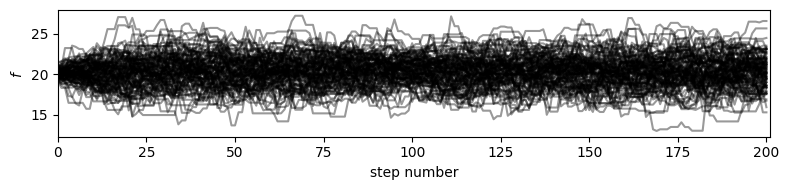

Auto-corr tau/N = [0.06448597]
tau/N <= 0.02 = [False] 

201		8.91807			2657.58635
202		8.48407			2519.76938
203		8.55247			2531.53171
204		8.44739			2491.98034
205		8.44432			2482.63067
206		8.56270			2508.87227
207		8.47732			2475.37861
208		8.58949			2499.54304
209		8.61291			2497.74535
210		8.40080			2427.83120
211		8.48562			2443.85914
212		8.47666			2432.80228
213		8.42736			2410.22610
214		8.38032			2388.39091
215		8.38485			2381.29655
216		8.54504			2418.24632
217		8.42744			2376.53723
218		8.43872			2371.27976
219		8.53064			2388.57780
220		8.75231			2441.89421
221		8.53280			2372.11812
222		8.53209			2363.38782
223		8.54155			2357.46890
224		8.55141			2351.63665
225		8.63407			2365.73545
226		8.43193			2301.91634
227		8.40333			2285.70440
228		8.40143			2276.78807
229		8.39774			2267.38899
230		8.64092			2324.40694
231		8.65576			2319.74261
232		8.58237			2291.49332
233		8.48308			2256.49822
234		8.53820			2262.62432
235		8.51063			2246.80579
236		8.57723			2255.81175
237		8.

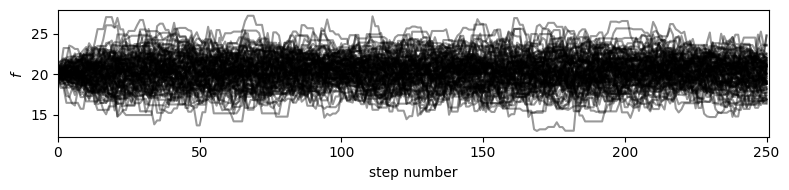

Auto-corr tau/N = [0.05751654]
tau/N <= 0.02 = [False] 

251		8.76220			2173.02634
252		8.45911			2089.39918
253		8.53832			2100.42647
254		8.51256			2085.57794
255		8.40753			2051.43659
256		8.57259			2083.13961
257		8.48710			2053.87893
258		8.71578			2100.50226
259		8.63316			2071.95888
260		8.56392			2046.77664
261		8.55630			2036.39892
262		8.49017			2012.17053
263		8.50988			2008.33097
264		8.49716			1996.83213
265		8.53438			1997.04422
266		8.82096			2055.28345
267		8.62827			2001.75748
268		8.55298			1975.73930
269		8.60691			1979.59022
270		8.55777			1959.72841
271		8.59230			1959.04486
272		8.64824			1963.15048
273		8.54531			1931.24074
274		8.56427			1926.96165
275		8.50098			1904.21907
276		8.57640			1912.53653
277		8.55305			1898.77710
278		8.59966			1900.52464
279		8.61453			1895.19638
280		8.73844			1913.71902
281		8.44830			1841.72896
282		8.51002			1846.67391
283		8.60007			1857.61469
284		8.58127			1844.97305
285		8.39605			1796.75384
286		8.54362			1819.79106
287		8.

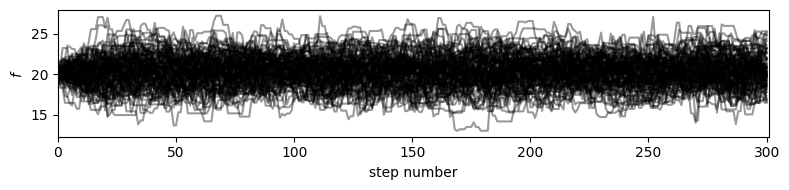

Auto-corr tau/N = [0.0487528]
tau/N <= 0.02 = [False] 

301		8.77485			1737.42089
302		8.61364			1696.88629
303		8.53776			1673.40135
304		8.55067			1667.38007
305		8.60018			1668.43550
306		8.50050			1640.59650
307		8.68348			1667.22912
308		8.61322			1645.12406
309		8.54948			1624.40139
310		8.44287			1595.70243
311		8.43023			1584.88324
312		8.50019			1589.53497
313		8.38699			1559.98014
314		8.45445			1564.07399
315		8.52252			1568.14386
316		8.39330			1535.97463
317		8.42591			1533.51471
318		8.40630			1521.54012
319		8.44576			1520.23608
320		8.42099			1507.35649
321		8.45730			1505.39976
322		8.47950			1500.87203
323		8.42487			1482.77694
324		8.48789			1485.38005
325		8.41405			1464.04540
326		8.40457			1453.99130
327		8.37674			1440.79997
328		8.63031			1475.78284
329		8.92473			1517.20393
330		8.62881			1458.26838
331		8.83371			1484.06261
332		8.50082			1419.63627
333		8.47635			1407.07344
334		8.61046			1420.72656
335		8.57670			1406.57831
336		8.57688			1398.03160
337		8.7

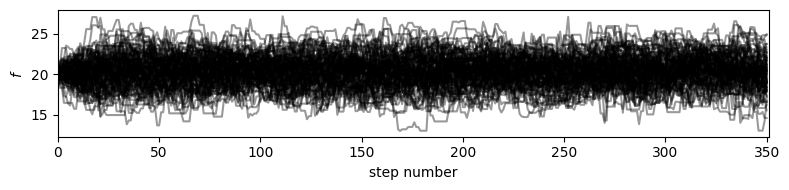

Auto-corr tau/N = [0.04379315]
tau/N <= 0.02 = [False] 

351		8.60633			1273.73625
352		8.44256			1241.05676
353		8.41437			1228.49817
354		8.38193			1215.37941
355		8.35601			1203.26558
356		8.53100			1219.93343
357		8.48653			1205.08797
358		8.45659			1192.37975
359		8.41492			1178.08810
360		8.44371			1173.67569
361		8.42104			1162.10393
362		8.38488			1148.72870
363		8.52193			1158.98302
364		8.55343			1154.71291
365		8.40452			1126.20635
366		8.38712			1115.48656
367		8.49387			1121.19124
368		8.41034			1101.75467
369		8.38590			1090.16752
370		8.50291			1096.87526
371		8.46069			1082.96781
372		8.46210			1074.68695
373		8.41993			1060.91131
374		8.70003			1087.50312
375		8.52708			1057.35755
376		8.49622			1045.03457
377		8.61383			1050.88714
378		8.53729			1033.01148
379		8.41500			1009.79988
380		8.40182			999.81694
381		8.47555			1000.11490
382		8.65434			1012.55790
383		8.37842			971.89707
384		8.42232			968.56669
385		8.48767			967.59484
386		8.45588			955.51421
387		8.45968

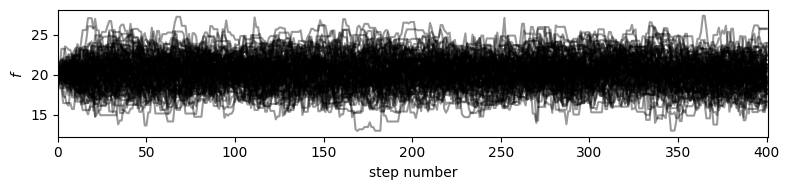

Auto-corr tau/N = [0.04038318]
tau/N <= 0.02 = [False] 

401		8.52476			835.42668
402		8.46061			820.67936
403		8.41162			807.51552
404		8.42287			800.17303
405		8.38684			788.36324
406		8.48351			788.96680
407		8.46318			778.61265
408		8.42262			766.45815
409		8.40789			756.70974
410		8.47979			754.70095
411		8.39205			738.50084
412		8.39828			730.65010
413		8.52293			732.97189
414		8.47757			720.59320
415		8.48652			712.86760
416		8.45558			701.81331
417		8.39253			688.18746
418		8.44100			683.72084
419		8.41370			673.09576
420		8.42976			665.95088
421		8.55917			667.61526
422		8.40261			647.00105
423		8.40261			638.59828
424		8.65140			648.85507
425		8.48435			627.84212
426		8.42695			615.16750
427		8.52075			613.49422
428		8.55140			607.14954
429		8.46536			592.57499
430		8.45635			583.48815
431		8.44442			574.22076
432		8.47644			567.92175
433		8.42845			556.27744
434		8.53280			554.63180
435		8.44569			540.52403
436		8.39462			528.86087
437		8.40287			520.97800
438		8.45428			515

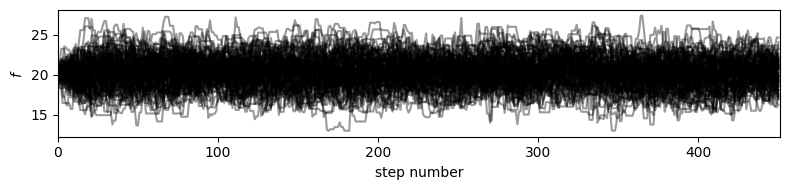

Auto-corr tau/N = [0.03785534]
tau/N <= 0.02 = [False] 

451		8.49828			407.91763
452		8.46707			397.95248
453		8.56293			393.89483
454		8.44627			380.08219
455		8.68067			381.94957
456		8.57530			368.73799
457		8.46425			355.49850
458		8.39061			344.01509
459		8.41543			336.61724
460		8.65305			337.46883
461		8.45826			321.41373
462		8.70323			322.01936
463		8.62483			310.49406
464		8.47474			296.61597
465		8.56247			291.12391
466		8.46660			279.39796
467		8.50033			272.01056
468		8.45020			261.95608
469		8.64494			259.34820
470		8.46202			245.39858
471		8.75666			245.18640
472		8.57242			231.45531
473		8.47520			220.35523
474		8.50851			212.71273
475		8.48107			203.54561
476		8.63358			198.57225
477		8.61043			189.42946
478		8.46389			177.74161
479		8.44688			168.93760
480		8.49714			161.44562
481		8.45501			152.19014
482		8.59579			146.12846
483		8.56059			136.96946
484		8.49208			127.38116
485		8.43947			118.15252
486		8.49383			110.41984
487		8.40917			100.91002
488		8.45267			92.

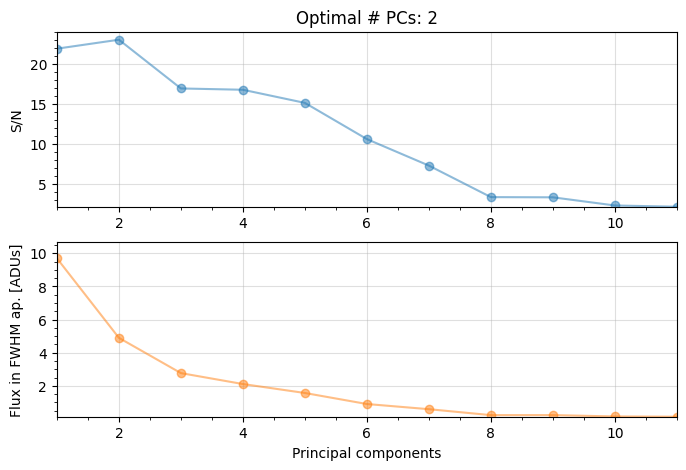

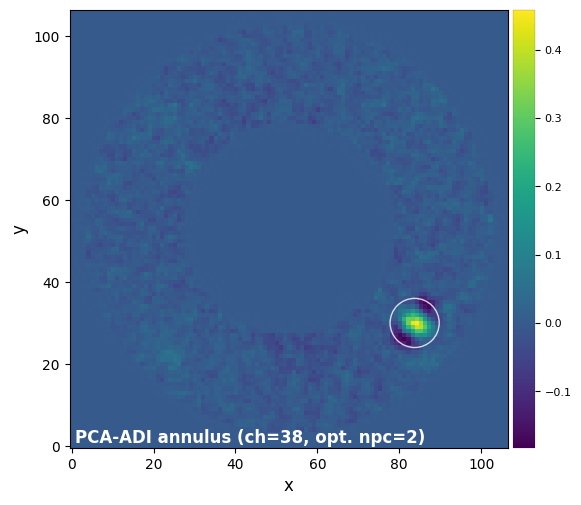

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 13:05:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.631
2/30   0.149   0.629
3/30   0.221   0.626
4/30   0.329   0.621
5/30   0.489   0.615
6/30   0.728   0.605
7/30   1.083   0.591
8/30   1.610   0.570
9/30   2.395   0.540
10/30   3.562   0.496
11/30   5.298   0.433
12/30   7.880   0.350
13/30   11.721   0.230
14/30   17.433   0.108
15/30   25.929   0.032
16/30   38.566   0.205
17/30   57.362   0.906
18/30   85.317   2.640


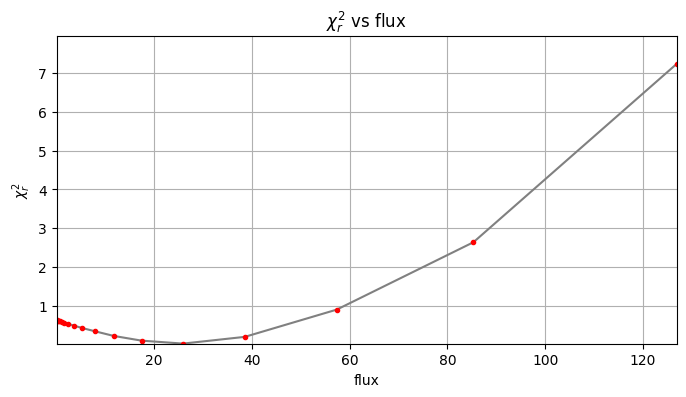

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 25.9
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 23, nfev: 53, chi2r: 0.03140040437380473
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 25.957) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:11.151390
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-03-26 13:05:15
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean a

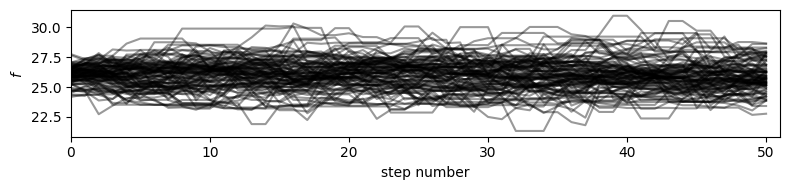

51		8.99499			4029.75686
52		8.59357			3841.32668
53		8.69128			3876.31177
54		8.67598			3860.81155
55		8.83145			3921.16469
56		8.90236			3943.74681
57		9.00530			3980.34039
58		8.68076			3828.21692
59		8.50880			3743.87200
60		8.58890			3770.52622
61		8.57412			3755.46368
62		8.54157			3732.66522
63		8.61900			3757.88226
64		8.69681			3783.11235
65		8.65566			3756.55514
66		8.76015			3793.14322
67		8.56431			3699.78192
68		8.60930			3710.60959
69		8.64769			3718.50498
70		8.77108			3762.79546
71		8.67903			3714.62313
72		8.58187			3664.45764
73		8.68988			3701.88675
74		8.54351			3630.99303
75		8.62165			3655.57790
76		8.66091			3663.56620
77		8.65773			3653.56079
78		8.65599			3644.17179
79		8.45041			3549.17220
80		8.56394			3588.29254
81		8.72525			3647.15450
82		9.03830			3768.96985
83		9.04468			3762.58896
84		8.97218			3723.45304
85		8.63930			3576.66854
86		8.71855			3600.76239
87		8.64771			3562.85487
88		8.79646			3615.34342
89		8.71258			3572.15944
90		8.87606			3630.30772


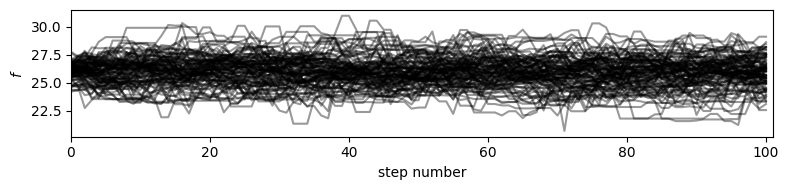

101		8.57981			3414.76319
102		8.41538			3340.90705
103		8.54620			3384.29362
104		8.51473			3363.31993
105		8.54520			3366.80801
106		8.45001			3320.85197
107		8.41589			3299.02888
108		8.43919			3299.72368
109		8.56678			3341.04303
110		8.46602			3293.28217
111		8.50272			3299.05420
112		8.56067			3312.97813
113		8.49682			3279.77136
114		8.45965			3256.96333
115		8.41240			3230.36275
116		8.39306			3214.54045
117		8.67422			3313.55166
118		8.69191			3311.61771
119		8.63538			3281.44326
120		8.58576			3254.00266
121		8.48740			3208.23833
122		8.46155			3190.00435
123		8.47729			3187.45916
124		8.47140			3176.77613
125		8.43756			3155.64856
126		8.47728			3162.02693
127		8.48712			3157.20752
128		8.40319			3117.58386
129		8.41936			3115.16246
130		8.42296			3108.07076
131		8.40927			3094.61026
132		8.40028			3082.90166
133		8.55859			3132.44540
134		8.57112			3128.45807
135		8.43456			3070.18166
136		8.44770			3066.51546
137		8.44260			3056.21975
138		8.41812			3038.94024
139		8.42517

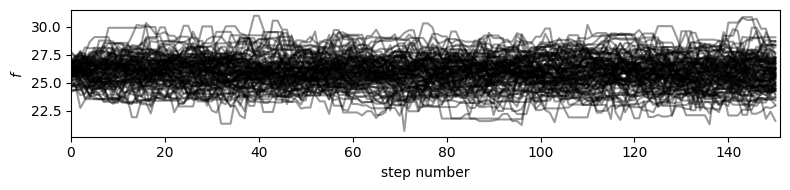

151		8.56466			2980.50307
152		8.37301			2905.43412
153		8.39892			2906.02701
154		8.44507			2913.54984
155		8.49634			2922.74234
156		8.41285			2885.60789
157		8.37932			2865.72881
158		8.53470			2910.33406
159		8.44297			2870.61116
160		8.38567			2842.74179
161		8.49378			2870.89730
162		8.41317			2835.23829
163		8.45651			2841.38736
164		8.45509			2832.45615
165		8.59448			2870.55699
166		8.40928			2800.28891
167		8.39151			2785.98066
168		8.51015			2816.86097
169		8.50871			2807.87496
170		8.46929			2786.39509
171		8.39020			2751.98593
172		8.43987			2759.83880
173		8.40907			2741.35617
174		8.35850			2716.51217
175		8.43085			2731.59540
176		8.45413			2730.68528
177		8.55118			2753.47964
178		8.44624			2711.24272
179		8.38595			2683.50464
180		8.41058			2682.97438
181		8.45846			2689.79092
182		8.52176			2701.39697
183		8.49943			2685.81988
184		8.43294			2656.37547
185		8.39446			2635.85981
186		8.35004			2613.56095
187		8.39084			2617.94302
188		8.40054			2612.56670
189		8.39411

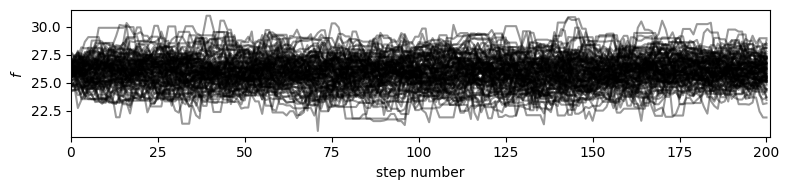

Auto-corr tau/N = [0.05709835]
tau/N <= 0.02 = [False] 

201		8.55545			2549.52440
202		8.36872			2485.51073
203		8.40100			2486.69630
204		8.52012			2513.43599
205		8.48208			2493.73211
206		8.50375			2491.59875
207		8.38825			2449.36900
208		8.54637			2486.99512
209		8.41738			2441.04136
210		8.43548			2437.85459
211		8.66759			2496.26448
212		8.51201			2442.94687
213		8.55289			2446.12683
214		8.39548			2392.71294
215		8.43358			2395.13644
216		8.40577			2378.83376
217		8.37295			2361.17190
218		8.53085			2397.16885
219		8.49064			2377.38032
220		8.58159			2394.26305
221		8.42171			2341.23510
222		8.47843			2348.52649
223		8.42667			2325.76175
224		8.41526			2314.19677
225		8.46822			2320.29118
226		8.46852			2311.90459
227		8.40611			2286.46246
228		8.40203			2276.95094
229		8.40120			2268.32427
230		8.42195			2265.50401
231		8.38871			2248.17455
232		8.45126			2256.48749
233		8.47002			2253.02479
234		8.50412			2253.59206
235		8.44833			2230.35886
236		8.56829			2253.45922
237		8.

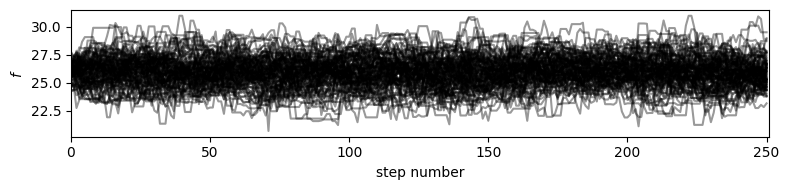

Auto-corr tau/N = [0.05239627]
tau/N <= 0.02 = [False] 

251		8.55364			2121.30272
252		8.63329			2132.42140
253		8.47671			2085.27041
254		8.49045			2080.16001
255		8.45207			2062.30459
256		8.41458			2044.74245
257		8.41068			2035.38383
258		8.43220			2032.15900
259		8.38319			2011.96608
260		8.40121			2007.88895
261		8.51349			2026.21014
262		8.46412			2005.99597
263		8.48344			2002.09302
264		8.42055			1978.82808
265		8.53932			1998.20135
266		8.46704			1972.82079
267		8.45288			1961.06793
268		8.50764			1965.26484
269		8.48819			1952.28278
270		8.41364			1926.72264
271		8.42012			1919.78713
272		8.38242			1902.81047
273		8.39431			1897.11406
274		8.41079			1892.42707
275		8.55715			1916.80250
276		8.45254			1884.91553
277		8.51352			1890.00077
278		8.42098			1861.03746
279		8.42542			1853.59174
280		8.55952			1874.53554
281		8.40282			1831.81367
282		8.52999			1851.00891
283		8.47605			1830.82637
284		8.47772			1822.70916
285		8.41235			1800.24311
286		8.39882			1788.94866
287		8.

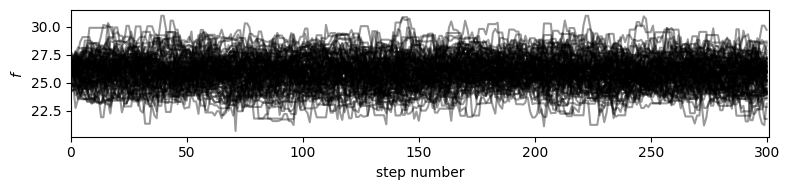

Auto-corr tau/N = [0.04597684]
tau/N <= 0.02 = [False] 

301		8.51975			1686.91109
302		8.41129			1657.02433
303		8.50926			1667.81594
304		8.51694			1660.80272
305		8.42789			1635.01105
306		8.51782			1643.93965
307		8.47078			1626.39034
308		8.53747			1630.65696
309		8.43564			1602.77084
310		8.51713			1609.73795
311		8.49590			1597.22826
312		8.39820			1570.46396
313		8.41641			1565.45300
314		8.36860			1548.19026
315		8.40747			1546.97448
316		8.44421			1545.29043
317		8.44660			1537.28029
318		8.50478			1539.36464
319		8.45525			1521.94482
320		8.50632			1522.63200
321		8.54619			1521.22164
322		8.41051			1488.66080
323		8.41927			1481.79099
324		8.40093			1470.16310
325		8.46149			1472.29961
326		8.44548			1461.06890
327		8.40545			1445.73671
328		8.39168			1434.97694
329		8.38079			1424.73481
330		8.36810			1414.20873
331		8.38913			1409.37401
332		8.47961			1416.09470
333		8.43324			1399.91817
334		8.50179			1402.79584
335		8.47202			1389.41062
336		8.47364			1381.20365
337		8.

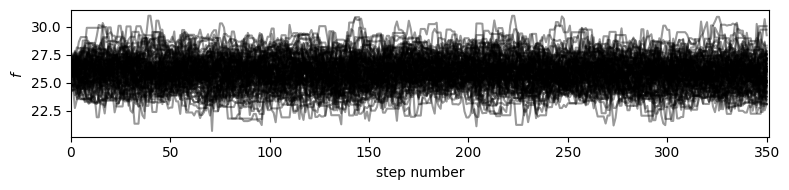

Auto-corr tau/N = [0.04209666]
tau/N <= 0.02 = [False] 

351		8.90342			1317.70675
352		8.58551			1262.06968
353		8.71609			1272.54870
354		8.61272			1248.84440
355		8.58247			1235.87626
356		8.49506			1214.79415
357		8.49000			1205.58043
358		8.37545			1180.93803
359		8.76531			1227.14410
360		8.89670			1236.64074
361		8.75962			1208.82742
362		8.67202			1188.06633
363		8.80917			1198.04671
364		8.52951			1151.48425
365		8.48318			1136.74585
366		8.74082			1162.52972
367		8.63575			1139.91953
368		8.91351			1167.66916
369		8.56363			1113.27151
370		8.52017			1099.10193
371		8.58939			1099.44256
372		8.81697			1119.75494
373		8.89103			1120.26928
374		8.90260			1112.82537
375		8.83741			1095.83909
376		8.82548			1085.53441
377		8.78525			1071.80013
378		8.63784			1045.17912
379		8.46973			1016.36712
380		8.56859			1019.66209
381		8.61478			1016.54357
382		8.46434			990.32801
383		8.44458			979.57082
384		8.40991			967.13999
385		8.37142			954.34165
386		8.41494			950.88833
387		8.42162

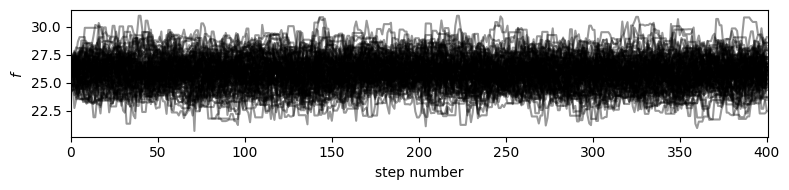

Auto-corr tau/N = [0.03945122]
tau/N <= 0.02 = [False] 

401		8.61972			844.73276
402		8.50577			825.05940
403		8.51594			817.52976
404		8.49845			807.35266
405		8.56567			805.17270
406		8.49373			789.91670
407		8.54509			786.14791
408		8.61973			784.39507
409		8.49613			764.65197
410		8.45937			752.88348
411		8.40021			739.21830
412		8.45620			735.68957
413		8.46157			727.69536
414		8.45510			718.68359
415		8.56832			719.73888
416		8.60370			714.10693
417		8.63007			707.66541
418		8.45587			684.92555
419		8.61934			689.54720
420		8.54887			675.36089
421		8.51256			663.97960
422		8.48724			653.51771
423		8.49500			645.62000
424		8.44897			633.67245
425		8.51296			629.95904
426		8.52371			622.23098
427		8.44252			607.86173
428		8.43621			598.97105
429		8.52377			596.66390
430		8.57000			591.33000
431		8.55504			581.74252
432		8.53273			571.69311
433		8.78011			579.48713
434		8.61035			559.67262
435		8.45371			541.03738
436		8.73978			550.60608
437		8.65346			536.51446
438		8.44919			515

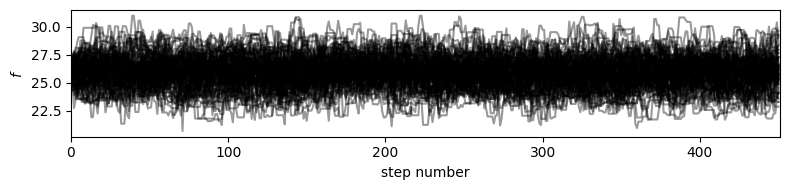

Auto-corr tau/N = [0.03936612]
tau/N <= 0.02 = [False] 

451		8.68392			416.82826
452		8.48076			398.59572
453		8.42783			387.68036
454		8.44376			379.96925
455		8.46716			372.55491
456		8.48153			364.70575
457		8.47247			355.84382
458		8.73222			358.02106
459		8.52502			341.00088
460		8.51787			332.19677
461		8.76053			332.90003
462		8.62153			318.99676
463		8.43267			303.57626
464		8.43556			295.24453
465		8.69316			295.56751
466		8.56481			282.63886
467		8.55279			273.68931
468		8.45984			262.25498
469		8.42976			252.89286
470		8.46293			245.42491
471		8.43968			236.31093
472		8.63536			233.15477
473		8.46522			220.09569
474		8.45856			211.46405
475		8.45049			202.81178
476		8.44313			194.19201
477		8.59075			188.99641
478		8.37160			175.80354
479		8.58244			171.64874
480		8.41017			159.79329
481		8.41618			151.49131
482		8.40885			142.95043
483		8.41140			134.58234
484		8.43295			126.49417
485		8.39778			117.56898
486		8.57049			111.41633
487		8.51637			102.19642
488		8.38688			92.

In [93]:
for i, ch in enumerate(test_ch):
    # find optimal npc
    res_ann_opt = pca_grid(cube_fc[ch], derot_angles, fwhm=fwhm[ch], range_pcs=(1,11,1), 
                           source_xy=xy_est, mode='annular',
                           annulus_width=ann_width, imlib=imlib, 
                           interpolation=interpolation, 
                           full_output=True, plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, _, opt_npc_ann = res_ann_opt
    plot_frames(final_ann_opt, label='PCA-ADI annulus (ch={}, opt. npc={:.0f})'.format(ch, opt_npc_ann),
                dpi=100, colorbar=True, circle=xy_est)
    # first guess
    trans_i = np.array([trans[0],trans[ch]])
    r_0, theta_0, f_0 = firstguess(cube_fc[ch], derot_angles, psfn[ch], ncomp=opt_npc_ann,
                                   planets_xy_coord=[xy_est], fwhm=fwhm[ch], weights=X_fac,
                                   f_range=None, annulus_width=ann_width, aperture_radius=aperture_radius,
                                   imlib=imlib, interpolation=interpolation, simplex=True, force_rPA=True,
                                   transmission=trans_i, plot=True, verbose=True)
    initial_state = np.array([r_0[0], theta_0[0], f_0[0]])
    # MCMC
    obs_params['psfn']= psfn[ch]
    obs_params['fwhm']= fwhm[ch]
    obs_params['transmission']= trans_i
    algo_params['ncomp'] = opt_npc_ann
    chain = mcmc_negfc_sampling(cube_fc[ch], derot_angles, **obs_params, **algo_params, **negfc_params, 
                                initial_state=initial_state, **mcmc_params, **conv_params, weights=X_fac,
                                force_rPA=True, display=True, verbosity=2, save=False, output_dir='./')
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'wb') as fileSave:
        pickle.dump(output, fileSave)           

In [94]:
chain = []
for i, ch in enumerate(test_ch):

    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'rb') as fi:
        myPickler = pickle.Unpickler(fi)
        mcmc_result = myPickler.load()

    chain.append(mcmc_result['chain'])

Let's visualize the chain after setting labels for each parameter:

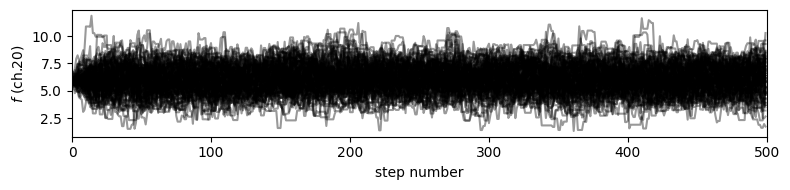

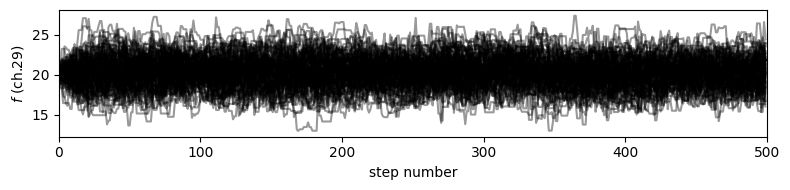

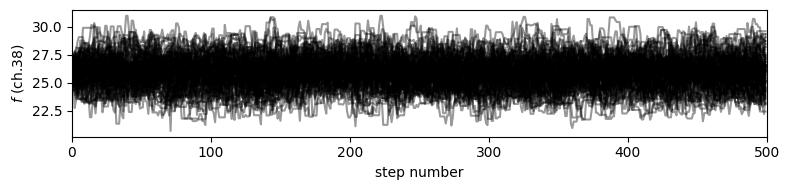

In [95]:
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_walk_plot(chain[i], labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

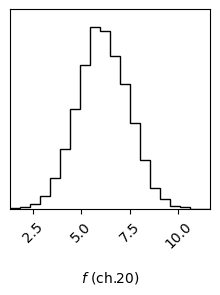

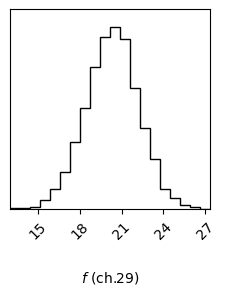

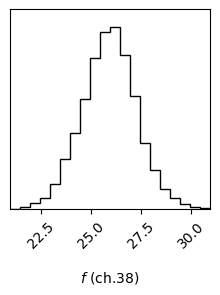

In [96]:
burnin = 0.3
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_corner_plot(chain[i], burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [97]:
npar = 1

In [98]:
isamples_flat = chain[0][:, int(chain[0].shape[1]//(1/burnin)):, :].reshape((-1,npar))
for i in range(1,len(test_ch)):
    isamples_flat = np.hstack((isamples_flat, 
                               chain[i][:, int(chain[i].shape[1]//(1/burnin)):, :].reshape((-1,npar))))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

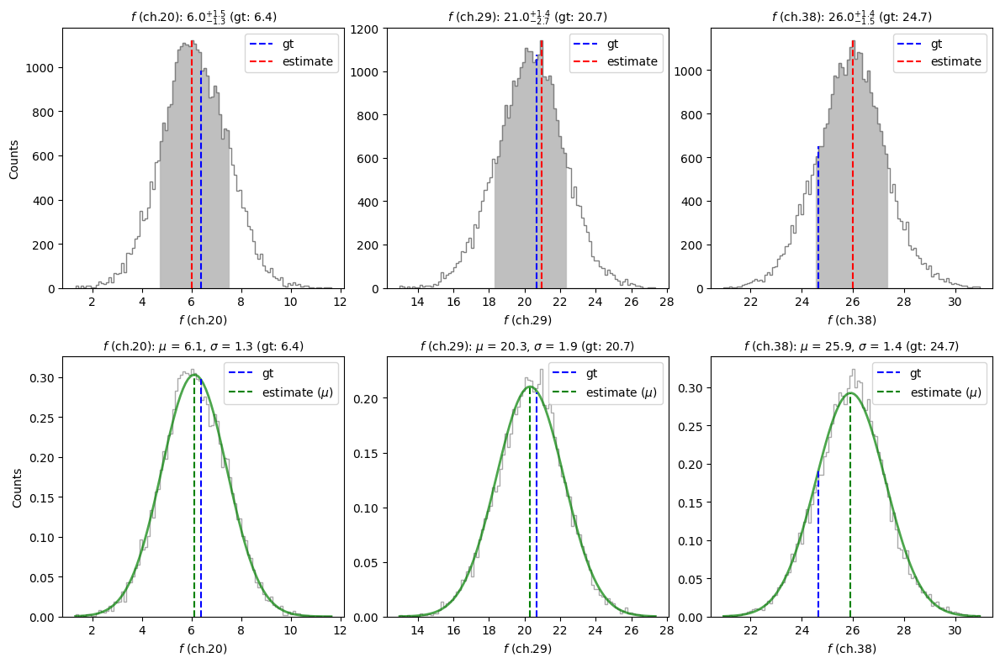

In [99]:
gt = []
labels = []
for i, ch in enumerate(test_ch):
    gt.append(flux_c_scal[ch])
    labels.append(r"$f$ (ch.{:.0f})".format(ch))

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated fluxes are consistent with the ground truth values (shown with dashed blue lines), within uncertainties.